# Gesture Recognition
In this group project, you are going to build a 3D Conv model that will be able to predict the 5 gestures correctly. Please import the following libraries to get started.

In [712]:
import numpy as np
import os
import matplotlib.pyplot as plt
#from scipy.misc import imread, imresize
import imageio
import skimage
from skimage.transform import resize
import datetime
import os
import random
from PIL import ImageFilter, ImageEnhance


We set the random seed so that the results don't vary drastically.

In [456]:
np.random.seed(30)
import random as rn
rn.seed(30)
from keras import backend as K
import tensorflow as tf
#tf.set_random_seed(30)

In this block, you read the folder names for training and validation. You also set the `batch_size` here. Note that you set the batch size in such a way that you are able to use the GPU in full capacity. You keep increasing the batch size until the machine throws an error.

In [569]:
data_path = '/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/'
train_doc = np.random.permutation(open(data_path+'train.csv').readlines())
train_path = data_path+'train'

val_doc = np.random.permutation(open(data_path+'val.csv').readlines())
val_path = data_path+'val'

img_x = 120
img_y = 120

#Experiment parameter
batch_size = 20 #Experiment -1
img_idx = range(0,30,2)


In [570]:
#Display Random image from Train and Validation set
import glob, random
train_img_folders=glob.glob("/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/*")
train_img = random.choice(glob.glob(random.choice(train_img_folders)+"/*.png"))

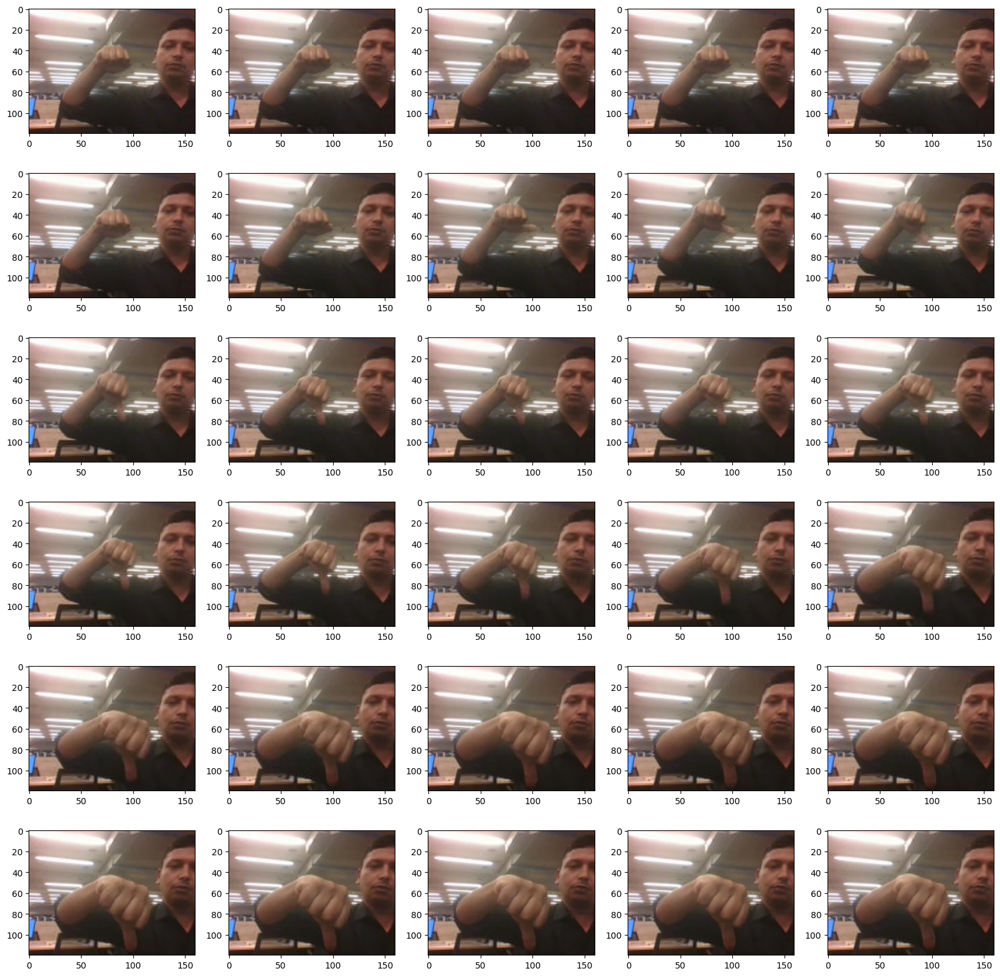

In [571]:
fig, axs = plt.subplots(nrows=6, ncols=5, figsize=(20,20))
for ima, ax in zip(sorted(glob.glob(random.choice(train_img_folders)+"/*.png")), axs.flatten()):
    plt.sca(ax)
    plt.imshow(np.array(Image.open(ima)))

## Generator
This is one of the most important part of the code. The overall structure of the generator has been given. In the generator, you are going to preprocess the images as you have images of 2 different dimensions as well as create a batch of video frames. You have to experiment with `img_idx`, `y`,`z` and normalization such that you get high accuracy.

In [688]:
import cv2

In [813]:
def process_batch(source_path,t,num_batches,remaining_seq=0,augmention=False):
    
    batch_count = remaining_seq if remaining_seq else batch_size
    
    batch_data = np.zeros((batch_count,len(img_idx),img_x,img_y,3)) # x is the number of images you use for each video, (y,z) is the final size of the input images and 3 is the number of channels RGB
    batch_labels = np.zeros((batch_count,5)) # batch_labels is the one hot representation of the output
    for folder in range(batch_count): # iterate over the batch_size
        imgs = os.listdir(source_path+'/'+ t[folder + (num_batches*batch_size)].split(';')[0]) # read all the images in the folder
        imgs=sorted(imgs)
        for idx,item in enumerate(img_idx): #  Iterate iver the frames/images of a folder to read them in
            image = imread(source_path+'/'+ t[folder + (num_batches*batch_size)].strip().split(';')[0]+'/'+imgs[item]).astype(np.float32)
            #plt.subplot(2, x, idx+x+1)
            #crop the images and resize them. Note that the images are of 2 different shape 
            #and the conv3D will throw error if the inputs in a batch have different shapes
            #img = Image.fromarray(image, 'RGB')
            #img.show()
            #plt.imshow(image.astype('uint8'))
#             if image.shape[1] > image.shape[0]:
#                 diff_px = image.shape[1] - image.shape[0]
#                 crop_start = diff_px//2
#                 crop_end = crop_start + image.shape[0]
#                 image = image[:, crop_start:crop_end]
#             elif image.shape[0] > image.shape[1]:
#                 diff_px = image.shape[0] - image.shape[1]
#                 crop_start = diff_px//2
#                 crop_end = crop_start + image.shape[1]
#                 image = image[:, crop_start:crop_end]
                
#             image = resize(image,(120,120))
            if(augmention):
                shifted = cv2.warpAffine(image, 
                                        np.float32([[1, 0, np.random.randint(-30,30)],[0, 1, np.random.randint(-30,30)]]),
                                        (image.shape[1], image.shape[0]))

                gray = cv2.cvtColor(shifted,cv2.COLOR_BGR2GRAY)

                x0, y0 = np.argwhere(gray > 0).min(axis=0)
                x1, y1 = np.argwhere(gray > 0).max(axis=0) 
                # cropping the images to have the targeted gestures and remove the noise from the images.
                cropped=shifted[x0:x1,y0:y1,:]
                image = cropped

            image=resize(image,(img_x,img_y,3))
#             if(augmention):
#                 aug_type = random.randint(0,4)
#                 if aug_type == 0: # edge Enhancement
#                     #print('edge Enhancement')
#                     image = np.array(Image.fromarray((image * 255).astype(np.uint8)).filter(ImageFilter.EDGE_ENHANCE))
#                 elif aug_type == 1: # adding gaussian blur
#                     #print('gaussian blur')
#                     image = np.array(Image.fromarray((image * 255).astype(np.uint8)).filter(ImageFilter.GaussianBlur(1)))
#                 elif aug_type == 2: # enchancing image detailing
#                     #print('detailing')
#                     image = np.array(Image.fromarray((image * 255).astype(np.uint8)).filter(ImageFilter.DETAIL))
#                 elif aug_type == 3: # sharpening image
#                     #print('Sharpening')
#                     image = np.array(Image.fromarray((image * 255).astype(np.uint8)).filter(ImageFilter.SHARPEN))
#                 elif aug_type == 4: # Brightness enhancement
#                     #print('Brightness')
#                     image = np.array(ImageEnhance.Brightness((Image.fromarray((image * 255).astype(np.uint8)))).enhance(1.5))
#             im = Image.fromarray(np.uint8(image))
#             plt.imshow(im)
#             plt.show()
#             print(source_path+'/'+ t[folder + (num_batches*batch_size)].strip().split(';')[0]+'/'+imgs[item])
            batch_data[folder,idx,:,:,0] = image[:,:,0]/255.0
            batch_data[folder,idx,:,:,1] = image[:,:,1]/255.0
            batch_data[folder,idx,:,:,2] = image[:,:,2]/255.0
            #print(t[folder + (num_batches*batch_size)].strip().split(';')[2])
        batch_labels[folder, int(t[folder + (num_batches*batch_size)].strip().split(';')[2])] = 1
    return (batch_data,batch_labels)
    
    
    
    
    
    
    

In [814]:
def generator(source_path, folder_list, batch_size,augment):
    #experiment with all,even,odd and skip initial and last
    while True:
        t = np.random.permutation(folder_list)
        num_batches = len(folder_list)//batch_size
        for batch in range(num_batches): # we iterate over the number of batches
            batch_data, batch_labels = process_batch(source_path,t,batch,augmention=augment)
#             print(batch_data)
#             print(batch_labels)
            yield batch_data, batch_labels
        
        remaining_seq=len(t)%batch_size
        if(remaining_seq != 0):
            num_batches = remaining_seq
            batch_data, batch_labels = process_batch(source_path,t,num_batches,remaining_seq,augmention=augment)
            yield batch_data, batch_labels


Note here that a video is represented above in the generator as (number of images, height, width, number of channels). Take this into consideration while creating the model architecture.

In [801]:
train_generator = generator(train_path, train_doc, batch_size,augment=True)
val_generator = generator(val_path, val_doc, batch_size,augment=False)

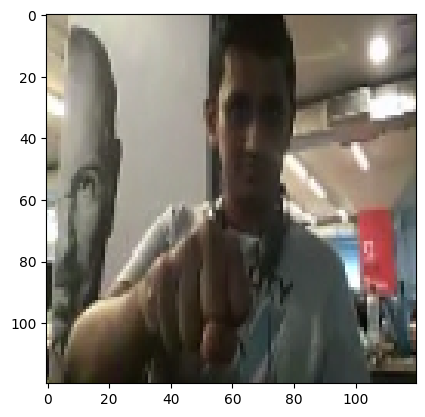

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_57_22_Pro_Stop_new/WIN_20180925_17_57_22_Pro_00011.png


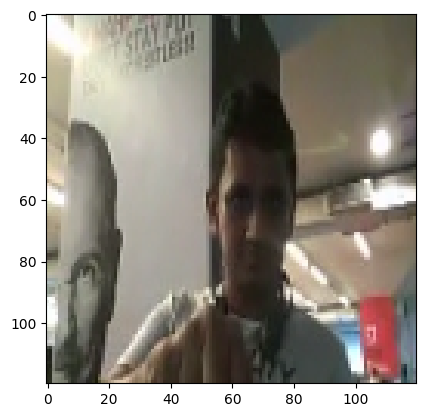

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_57_22_Pro_Stop_new/WIN_20180925_17_57_22_Pro_00015.png


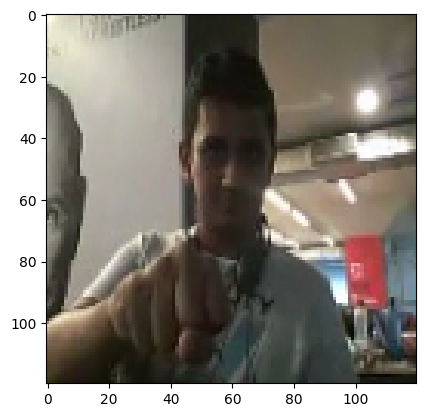

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_57_22_Pro_Stop_new/WIN_20180925_17_57_22_Pro_00019.png


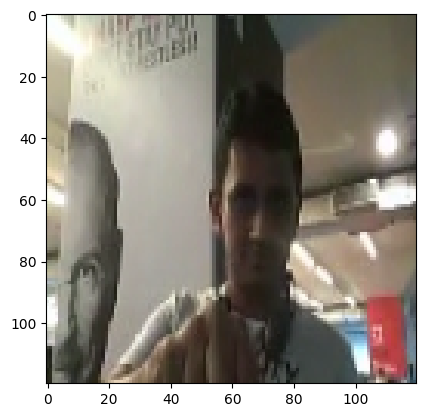

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_57_22_Pro_Stop_new/WIN_20180925_17_57_22_Pro_00023.png


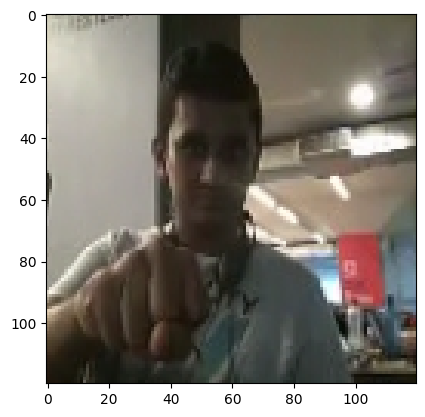

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_57_22_Pro_Stop_new/WIN_20180925_17_57_22_Pro_00027.png


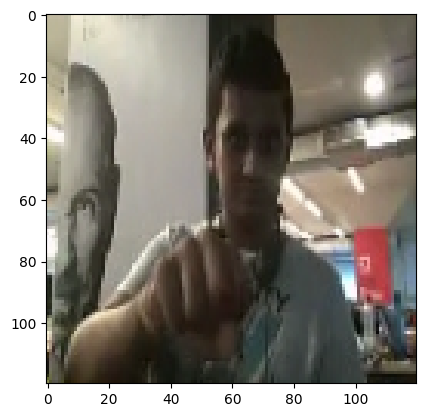

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_57_22_Pro_Stop_new/WIN_20180925_17_57_22_Pro_00031.png


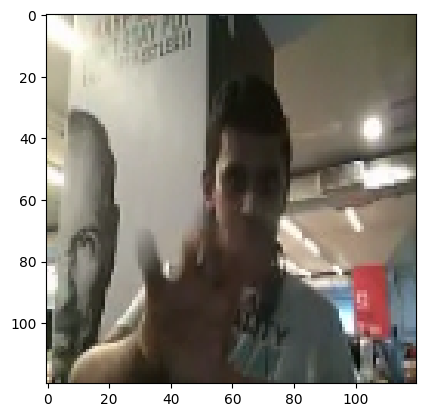

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_57_22_Pro_Stop_new/WIN_20180925_17_57_22_Pro_00035.png


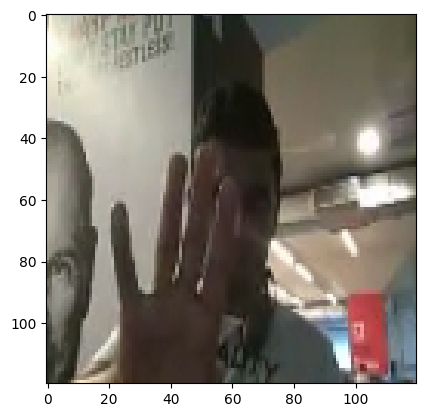

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_57_22_Pro_Stop_new/WIN_20180925_17_57_22_Pro_00039.png


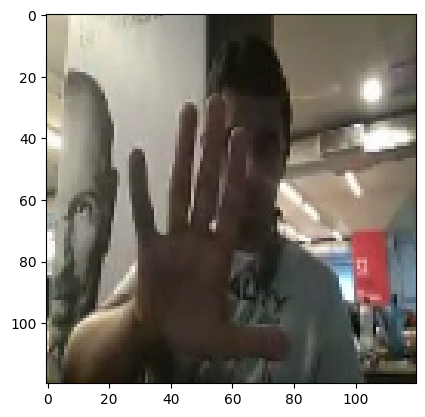

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_57_22_Pro_Stop_new/WIN_20180925_17_57_22_Pro_00043.png


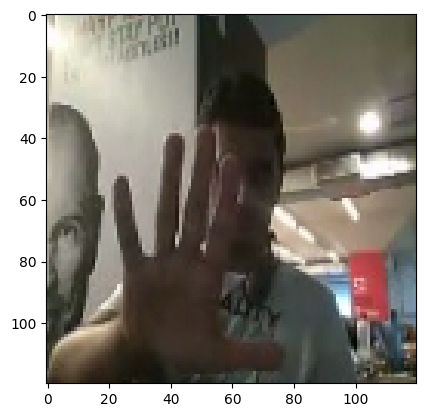

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_57_22_Pro_Stop_new/WIN_20180925_17_57_22_Pro_00047.png


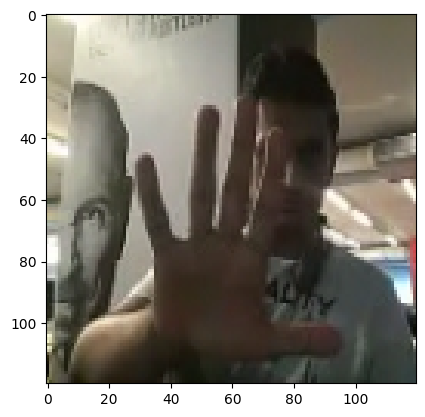

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_57_22_Pro_Stop_new/WIN_20180925_17_57_22_Pro_00051.png


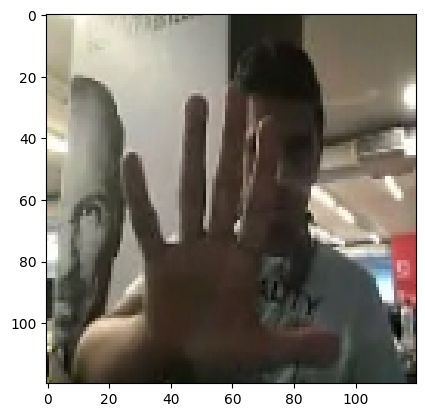

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_57_22_Pro_Stop_new/WIN_20180925_17_57_22_Pro_00055.png


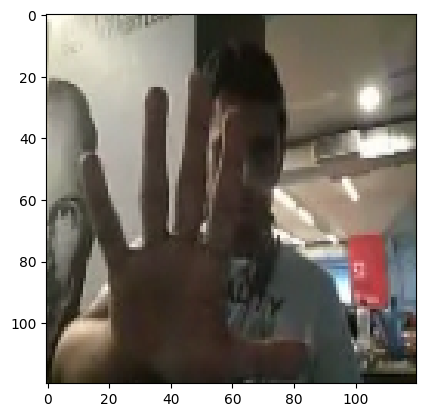

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_57_22_Pro_Stop_new/WIN_20180925_17_57_22_Pro_00059.png


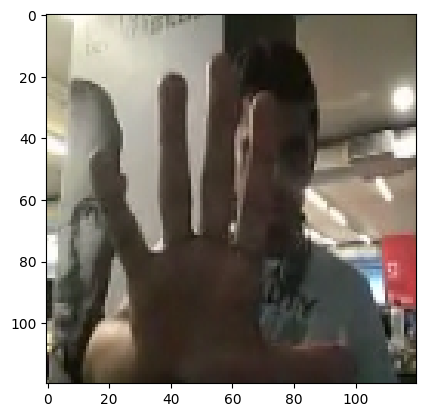

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_57_22_Pro_Stop_new/WIN_20180925_17_57_22_Pro_00063.png


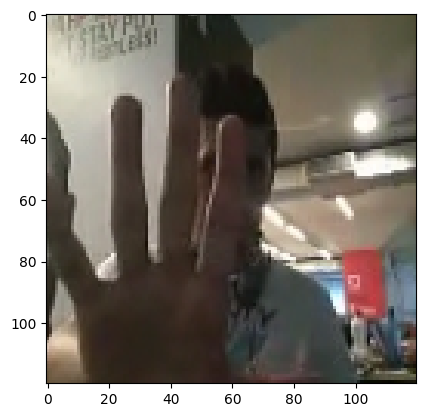

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_57_22_Pro_Stop_new/WIN_20180925_17_57_22_Pro_00067.png


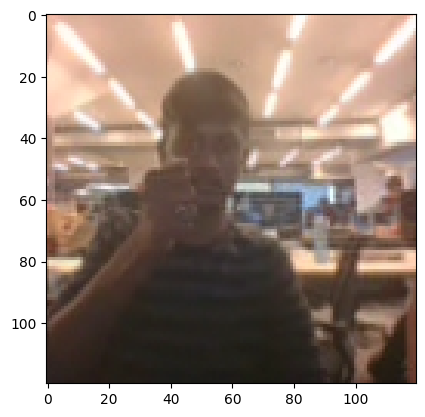

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_04_13_Pro_Thumbs_Down_new/WIN_20180925_18_04_13_Pro_00008.png


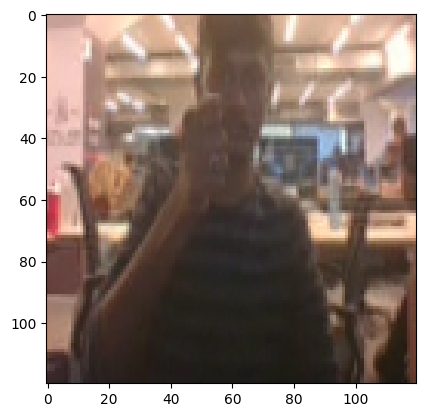

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_04_13_Pro_Thumbs_Down_new/WIN_20180925_18_04_13_Pro_00014.png


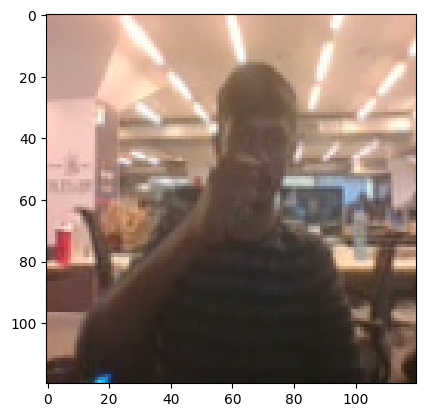

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_04_13_Pro_Thumbs_Down_new/WIN_20180925_18_04_13_Pro_00020.png


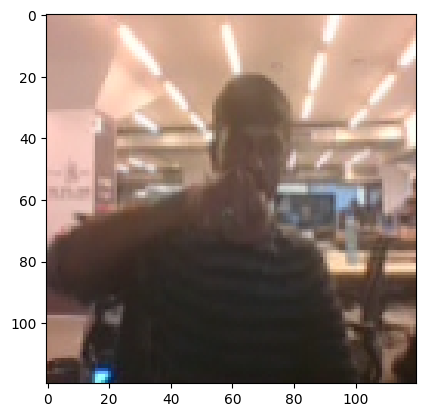

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_04_13_Pro_Thumbs_Down_new/WIN_20180925_18_04_13_Pro_00026.png


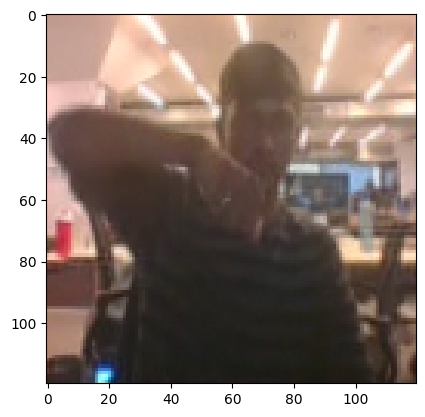

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_04_13_Pro_Thumbs_Down_new/WIN_20180925_18_04_13_Pro_00032.png


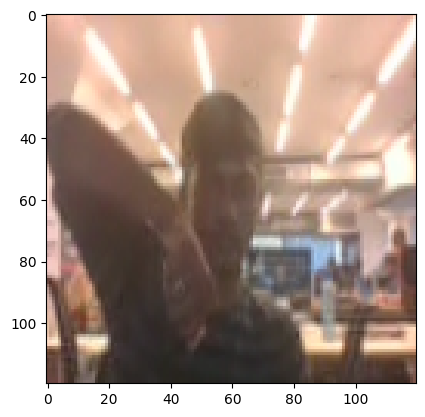

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_04_13_Pro_Thumbs_Down_new/WIN_20180925_18_04_13_Pro_00038.png


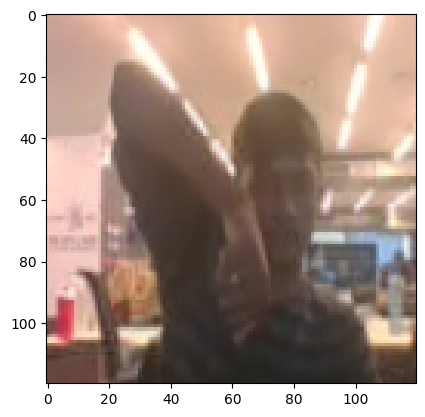

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_04_13_Pro_Thumbs_Down_new/WIN_20180925_18_04_13_Pro_00044.png


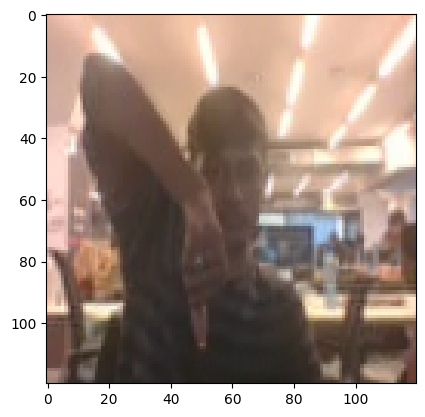

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_04_13_Pro_Thumbs_Down_new/WIN_20180925_18_04_13_Pro_00050.png


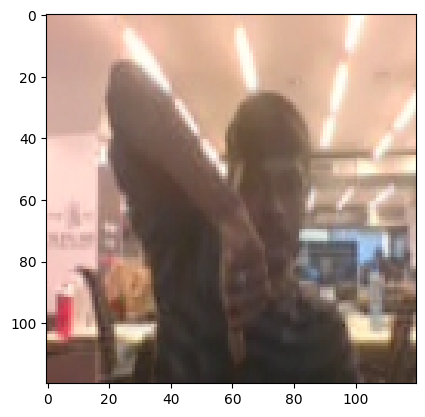

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_04_13_Pro_Thumbs_Down_new/WIN_20180925_18_04_13_Pro_00056.png


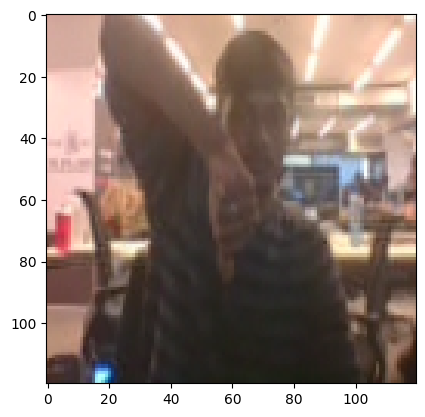

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_04_13_Pro_Thumbs_Down_new/WIN_20180925_18_04_13_Pro_00062.png


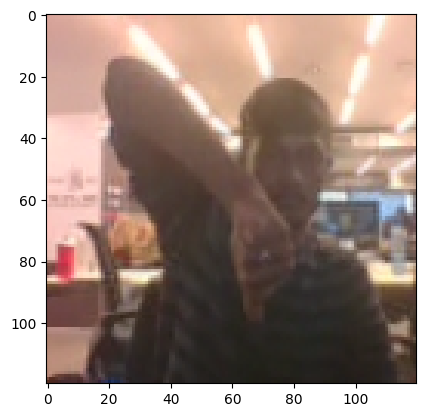

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_04_13_Pro_Thumbs_Down_new/WIN_20180925_18_04_13_Pro_00068.png


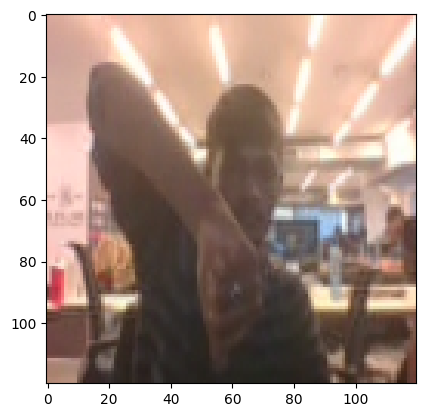

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_04_13_Pro_Thumbs_Down_new/WIN_20180925_18_04_13_Pro_00074.png


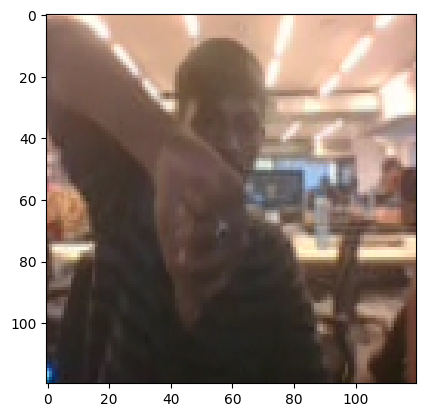

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_04_13_Pro_Thumbs_Down_new/WIN_20180925_18_04_13_Pro_00080.png


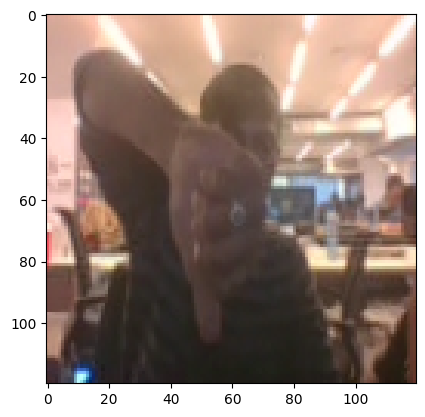

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_04_13_Pro_Thumbs_Down_new/WIN_20180925_18_04_13_Pro_00086.png


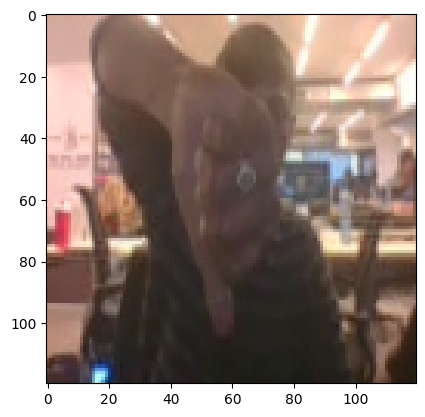

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_04_13_Pro_Thumbs_Down_new/WIN_20180925_18_04_13_Pro_00092.png


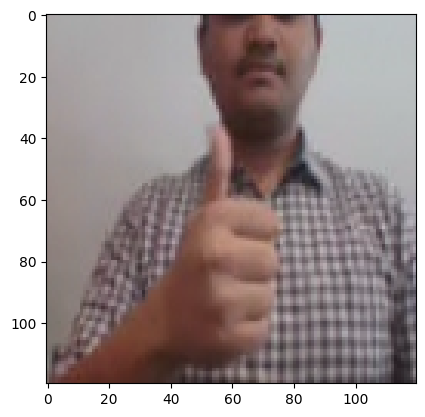

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_30_47_Pro_Thumbs_Up_new/WIN_20180926_17_30_47_Pro_00001.png


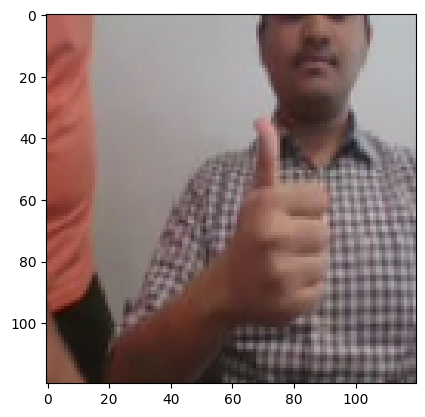

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_30_47_Pro_Thumbs_Up_new/WIN_20180926_17_30_47_Pro_00005.png


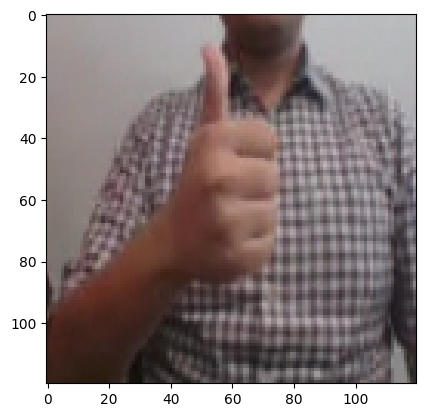

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_30_47_Pro_Thumbs_Up_new/WIN_20180926_17_30_47_Pro_00009.png


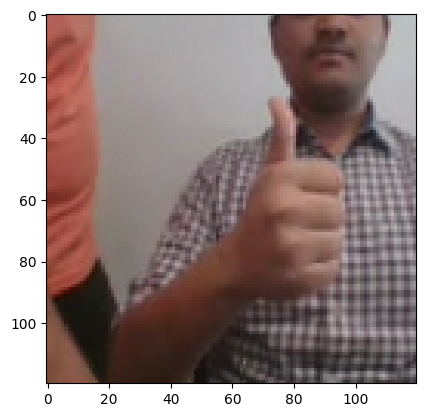

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_30_47_Pro_Thumbs_Up_new/WIN_20180926_17_30_47_Pro_00013.png


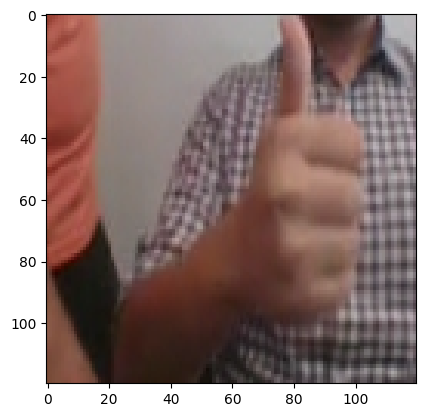

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_30_47_Pro_Thumbs_Up_new/WIN_20180926_17_30_47_Pro_00017.png


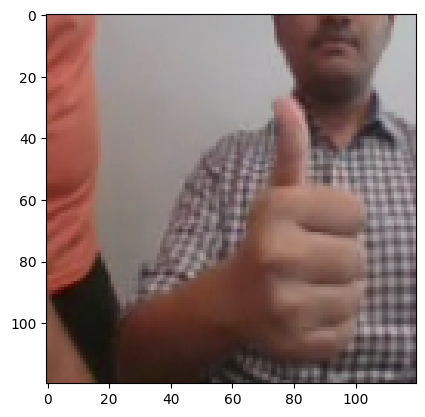

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_30_47_Pro_Thumbs_Up_new/WIN_20180926_17_30_47_Pro_00021.png


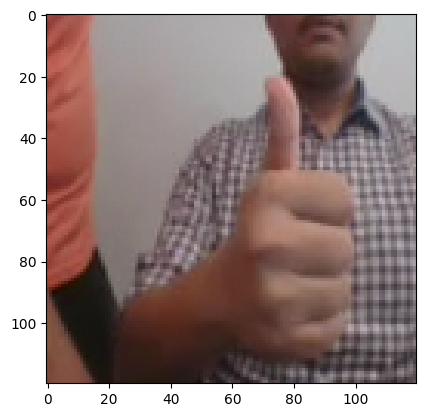

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_30_47_Pro_Thumbs_Up_new/WIN_20180926_17_30_47_Pro_00025.png


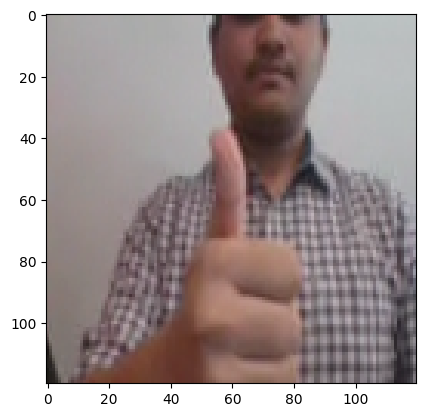

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_30_47_Pro_Thumbs_Up_new/WIN_20180926_17_30_47_Pro_00029.png


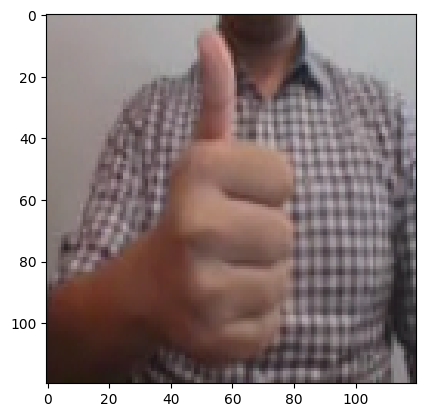

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_30_47_Pro_Thumbs_Up_new/WIN_20180926_17_30_47_Pro_00033.png


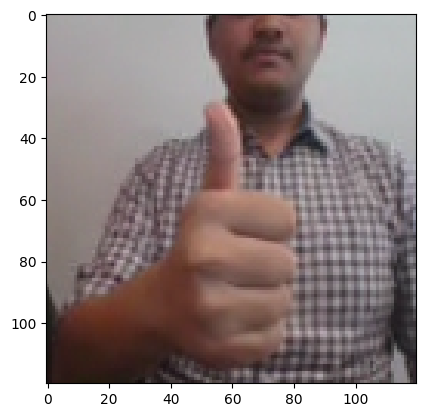

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_30_47_Pro_Thumbs_Up_new/WIN_20180926_17_30_47_Pro_00037.png


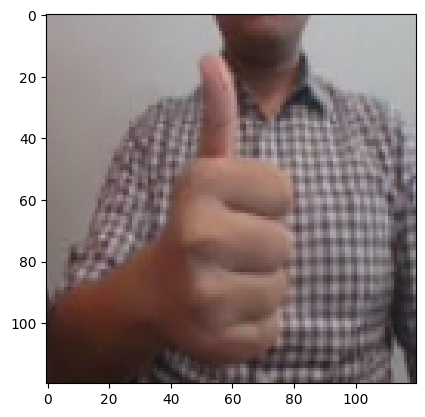

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_30_47_Pro_Thumbs_Up_new/WIN_20180926_17_30_47_Pro_00041.png


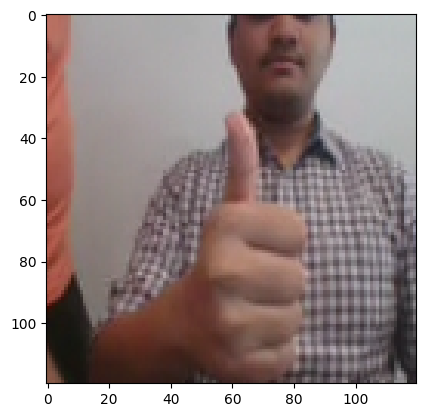

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_30_47_Pro_Thumbs_Up_new/WIN_20180926_17_30_47_Pro_00045.png


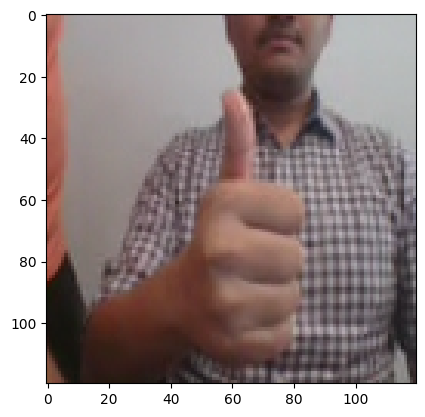

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_30_47_Pro_Thumbs_Up_new/WIN_20180926_17_30_47_Pro_00049.png


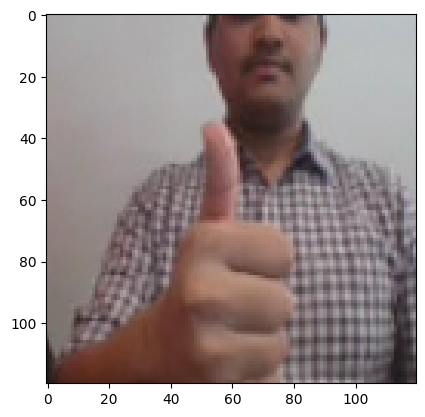

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_30_47_Pro_Thumbs_Up_new/WIN_20180926_17_30_47_Pro_00053.png


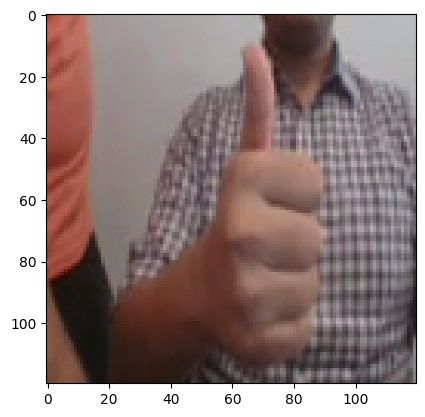

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_30_47_Pro_Thumbs_Up_new/WIN_20180926_17_30_47_Pro_00057.png


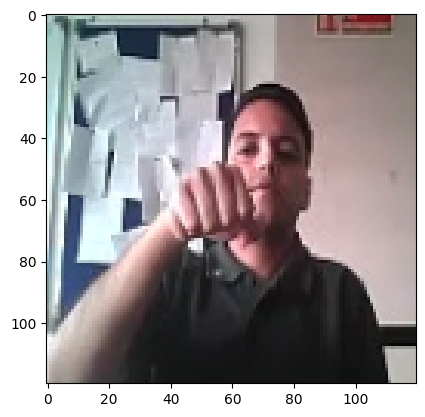

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_29_Pro_Stop_new/WIN_20180926_17_07_29_Pro_00003.png


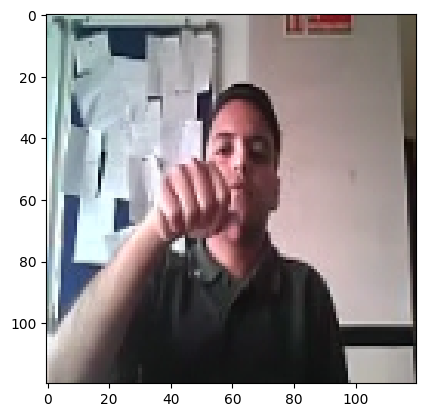

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_29_Pro_Stop_new/WIN_20180926_17_07_29_Pro_00007.png


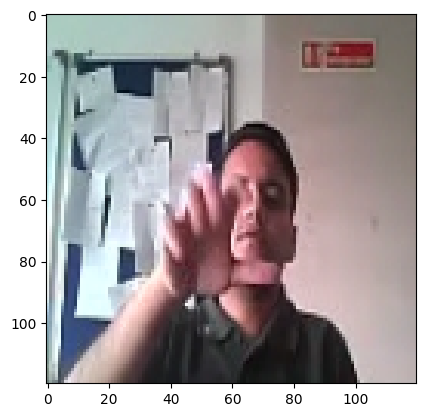

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_29_Pro_Stop_new/WIN_20180926_17_07_29_Pro_00011.png


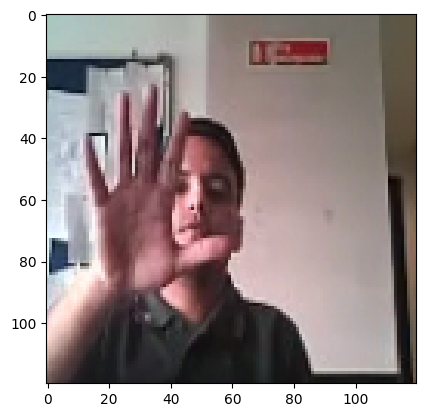

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_29_Pro_Stop_new/WIN_20180926_17_07_29_Pro_00015.png


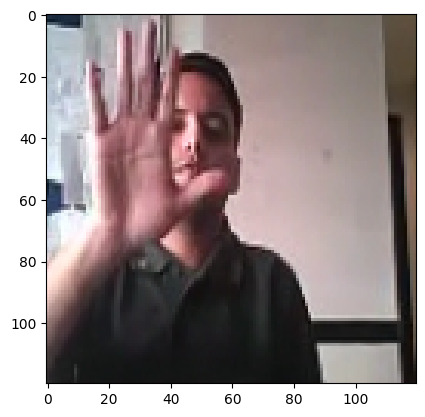

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_29_Pro_Stop_new/WIN_20180926_17_07_29_Pro_00019.png


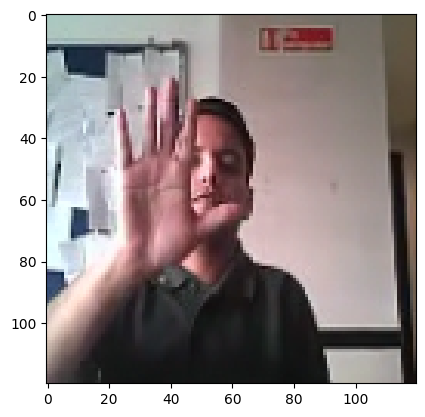

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_29_Pro_Stop_new/WIN_20180926_17_07_29_Pro_00023.png


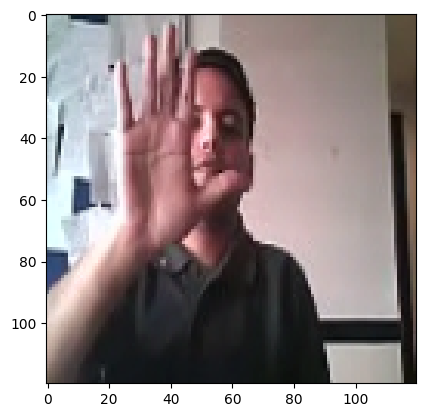

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_29_Pro_Stop_new/WIN_20180926_17_07_29_Pro_00027.png


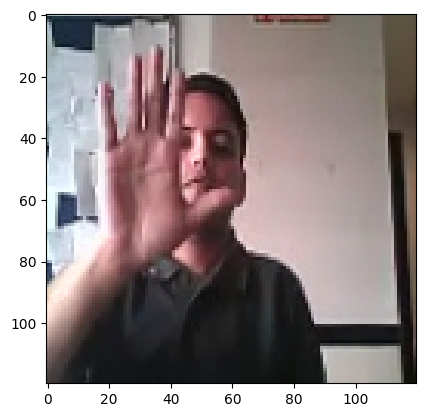

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_29_Pro_Stop_new/WIN_20180926_17_07_29_Pro_00031.png


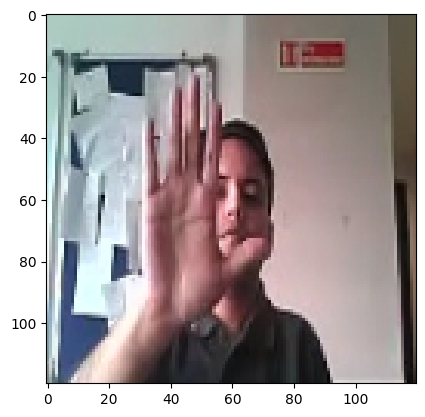

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_29_Pro_Stop_new/WIN_20180926_17_07_29_Pro_00035.png


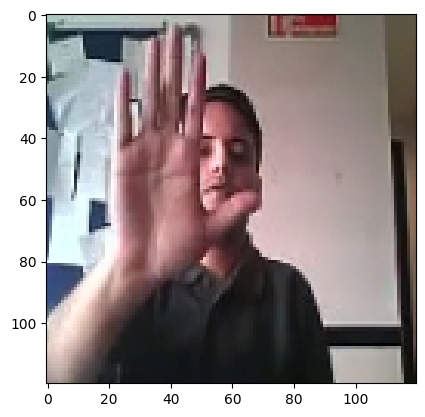

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_29_Pro_Stop_new/WIN_20180926_17_07_29_Pro_00039.png


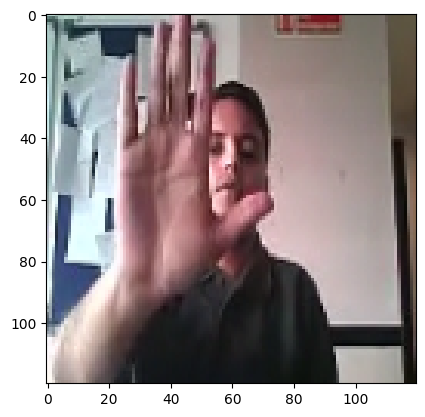

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_29_Pro_Stop_new/WIN_20180926_17_07_29_Pro_00043.png


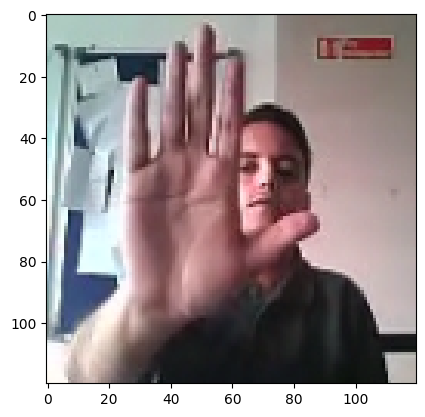

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_29_Pro_Stop_new/WIN_20180926_17_07_29_Pro_00047.png


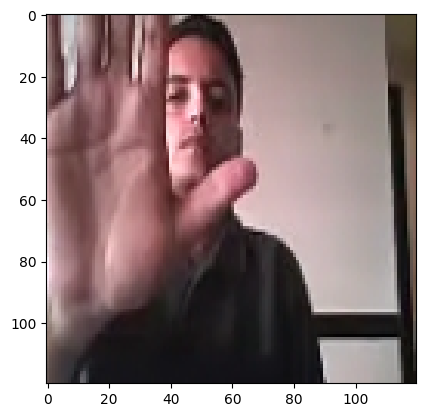

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_29_Pro_Stop_new/WIN_20180926_17_07_29_Pro_00051.png


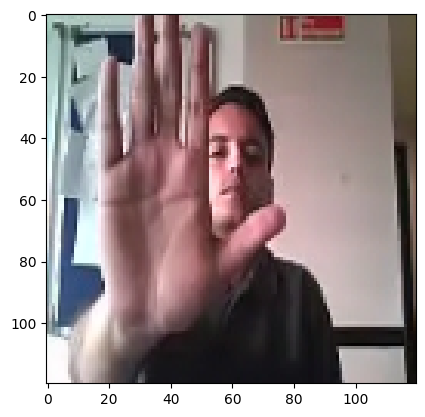

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_29_Pro_Stop_new/WIN_20180926_17_07_29_Pro_00055.png


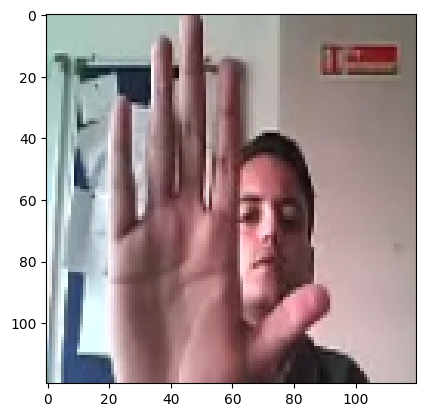

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_29_Pro_Stop_new/WIN_20180926_17_07_29_Pro_00059.png


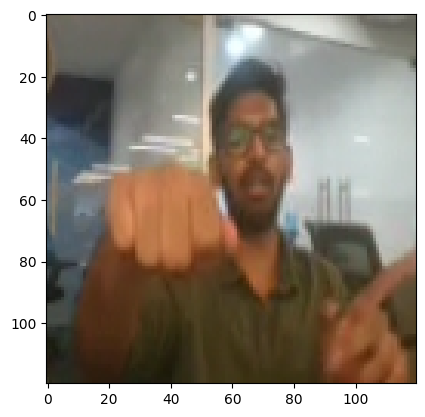

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_37_12_Pro_Thumbs_Down_new/WIN_20180925_17_37_12_Pro_00003.png


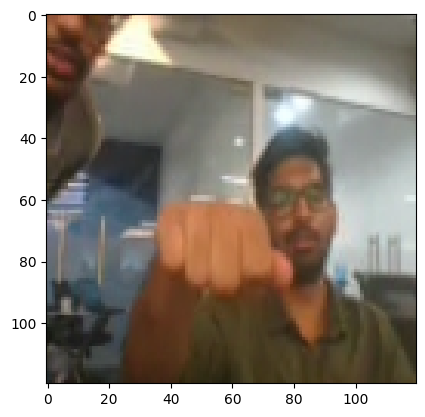

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_37_12_Pro_Thumbs_Down_new/WIN_20180925_17_37_12_Pro_00009.png


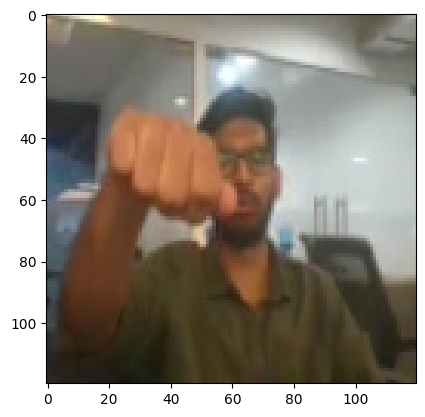

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_37_12_Pro_Thumbs_Down_new/WIN_20180925_17_37_12_Pro_00015.png


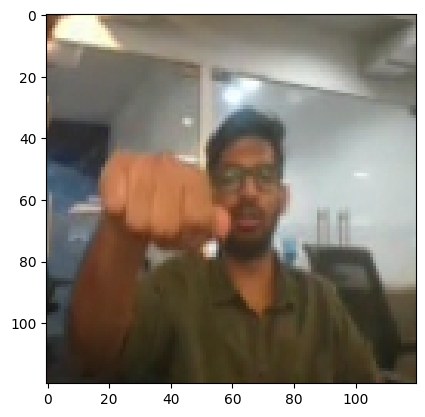

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_37_12_Pro_Thumbs_Down_new/WIN_20180925_17_37_12_Pro_00021.png


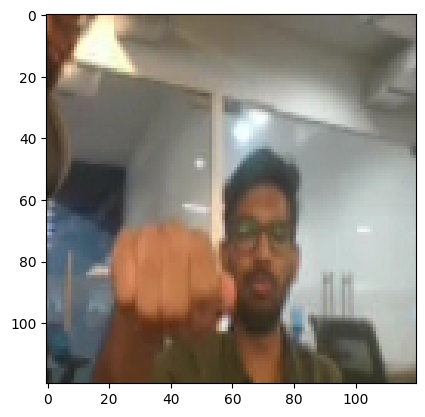

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_37_12_Pro_Thumbs_Down_new/WIN_20180925_17_37_12_Pro_00027.png


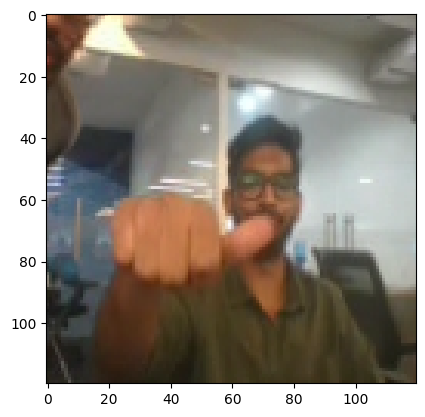

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_37_12_Pro_Thumbs_Down_new/WIN_20180925_17_37_12_Pro_00033.png


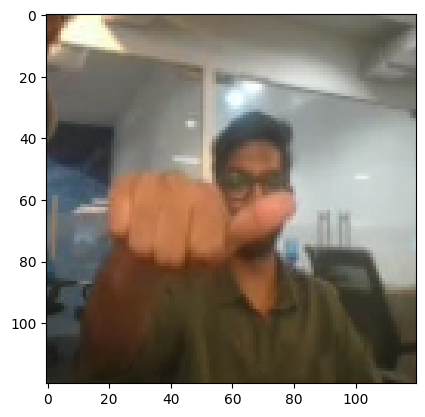

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_37_12_Pro_Thumbs_Down_new/WIN_20180925_17_37_12_Pro_00039.png


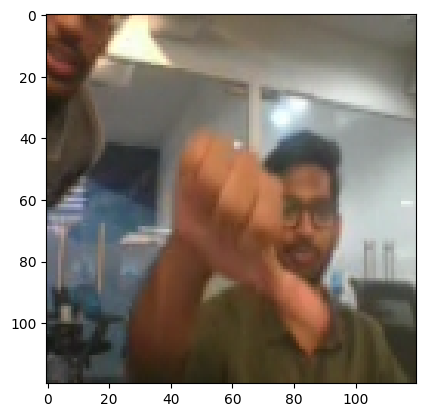

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_37_12_Pro_Thumbs_Down_new/WIN_20180925_17_37_12_Pro_00045.png


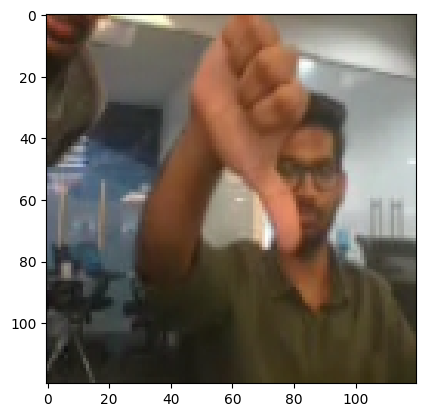

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_37_12_Pro_Thumbs_Down_new/WIN_20180925_17_37_12_Pro_00051.png


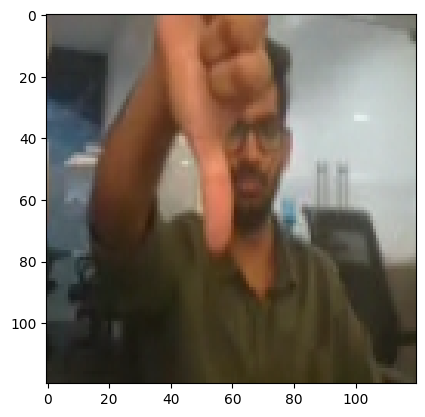

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_37_12_Pro_Thumbs_Down_new/WIN_20180925_17_37_12_Pro_00057.png


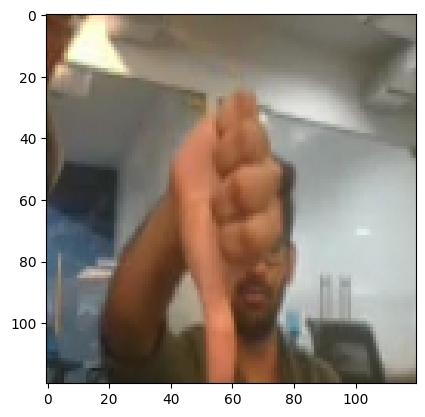

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_37_12_Pro_Thumbs_Down_new/WIN_20180925_17_37_12_Pro_00063.png


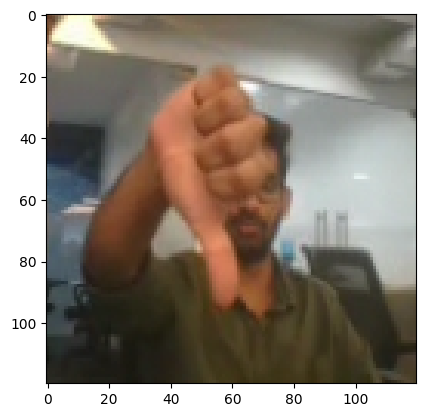

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_37_12_Pro_Thumbs_Down_new/WIN_20180925_17_37_12_Pro_00069.png


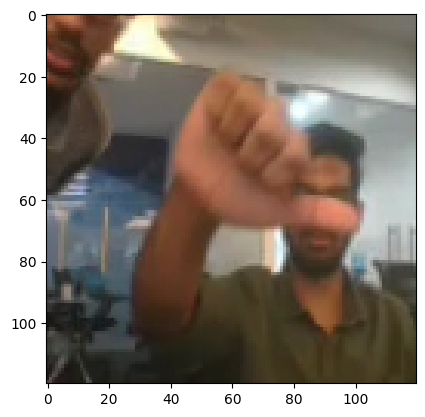

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_37_12_Pro_Thumbs_Down_new/WIN_20180925_17_37_12_Pro_00075.png


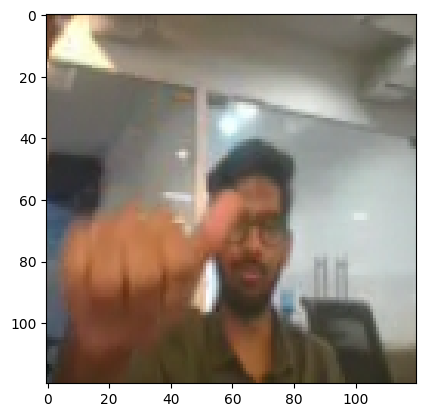

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_37_12_Pro_Thumbs_Down_new/WIN_20180925_17_37_12_Pro_00081.png


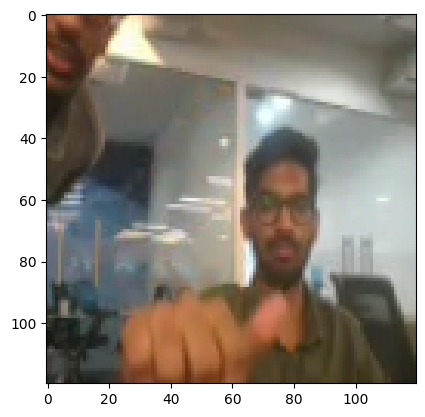

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_37_12_Pro_Thumbs_Down_new/WIN_20180925_17_37_12_Pro_00087.png


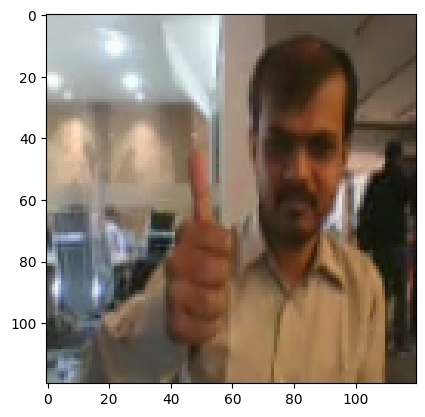

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_22_42_Pro_Thumbs_Up_new/WIN_20180925_17_22_42_Pro_00014.png


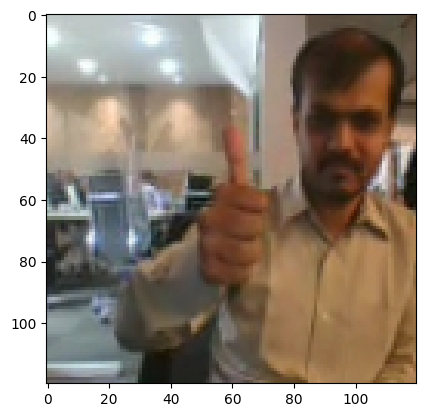

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_22_42_Pro_Thumbs_Up_new/WIN_20180925_17_22_42_Pro_00016.png


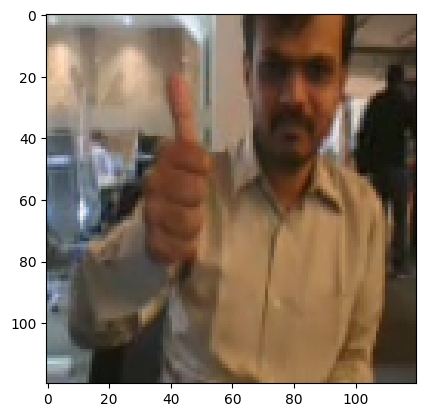

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_22_42_Pro_Thumbs_Up_new/WIN_20180925_17_22_42_Pro_00018.png


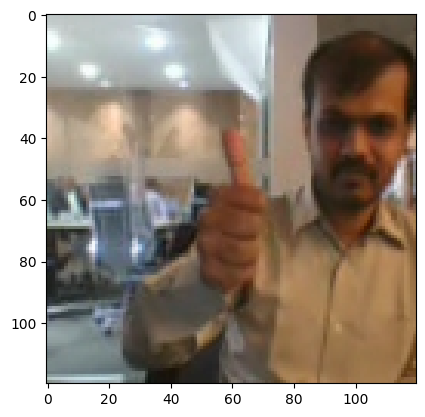

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_22_42_Pro_Thumbs_Up_new/WIN_20180925_17_22_42_Pro_00020.png


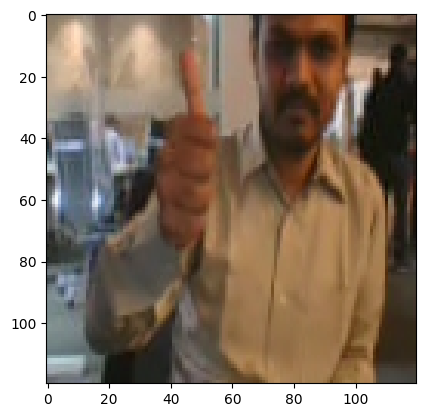

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_22_42_Pro_Thumbs_Up_new/WIN_20180925_17_22_42_Pro_00022.png


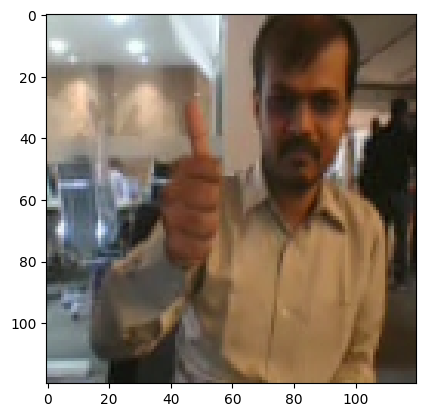

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_22_42_Pro_Thumbs_Up_new/WIN_20180925_17_22_42_Pro_00024.png


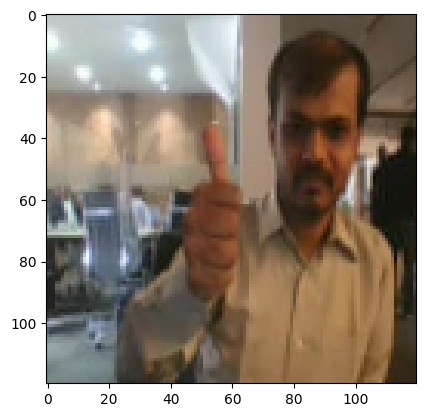

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_22_42_Pro_Thumbs_Up_new/WIN_20180925_17_22_42_Pro_00026.png


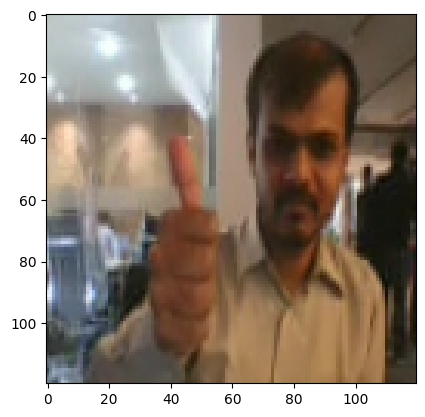

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_22_42_Pro_Thumbs_Up_new/WIN_20180925_17_22_42_Pro_00028.png


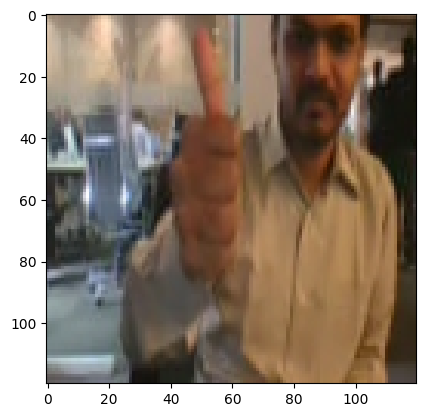

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_22_42_Pro_Thumbs_Up_new/WIN_20180925_17_22_42_Pro_00030.png


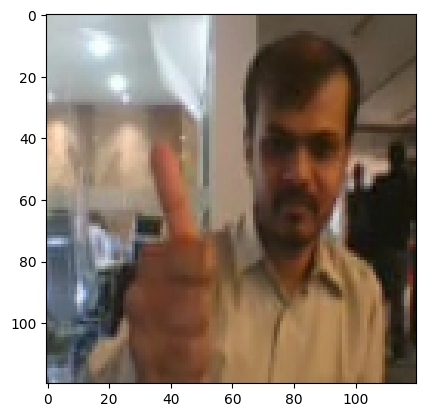

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_22_42_Pro_Thumbs_Up_new/WIN_20180925_17_22_42_Pro_00032.png


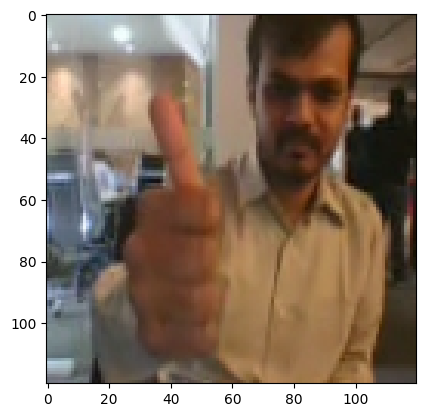

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_22_42_Pro_Thumbs_Up_new/WIN_20180925_17_22_42_Pro_00034.png


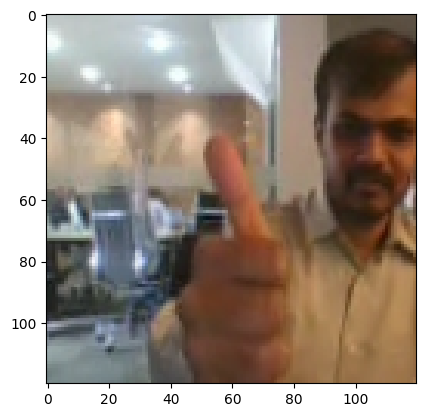

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_22_42_Pro_Thumbs_Up_new/WIN_20180925_17_22_42_Pro_00036.png


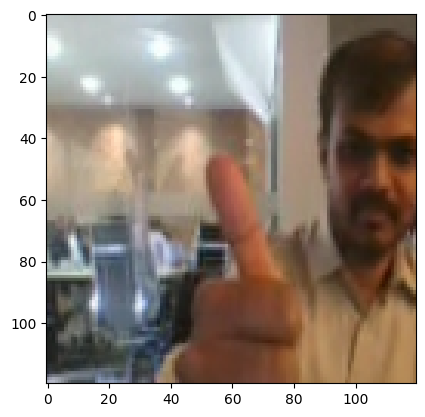

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_22_42_Pro_Thumbs_Up_new/WIN_20180925_17_22_42_Pro_00038.png


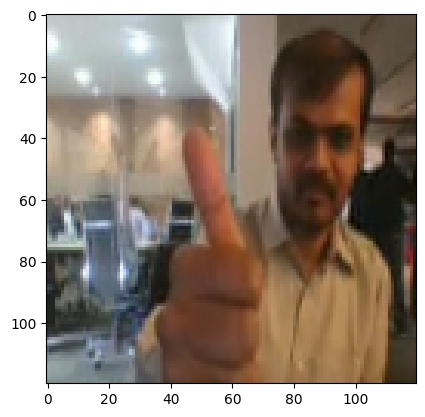

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_22_42_Pro_Thumbs_Up_new/WIN_20180925_17_22_42_Pro_00040.png


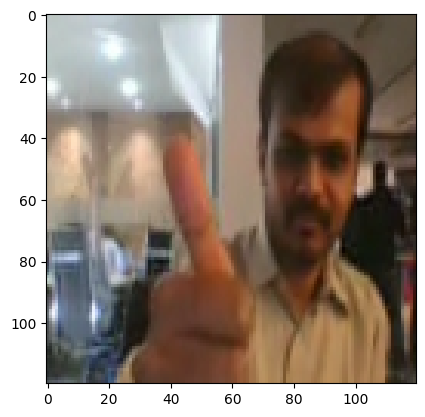

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_22_42_Pro_Thumbs_Up_new/WIN_20180925_17_22_42_Pro_00042.png


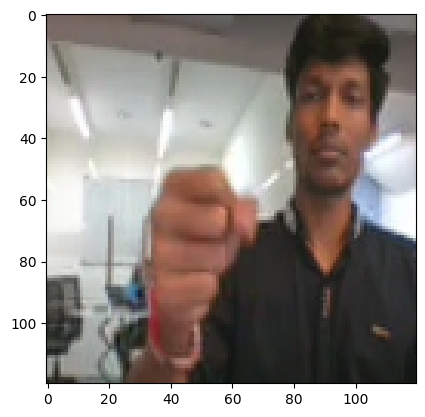

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_56_11_Pro_Thumbs_Up_new/WIN_20180925_17_56_11_Pro_00013.png


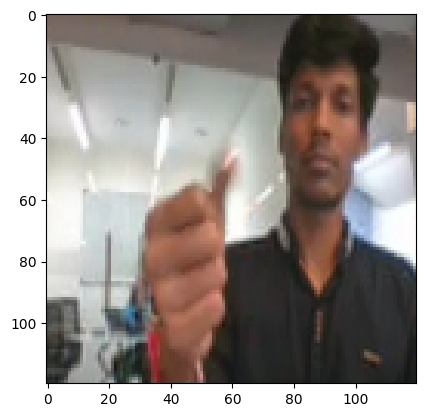

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_56_11_Pro_Thumbs_Up_new/WIN_20180925_17_56_11_Pro_00015.png


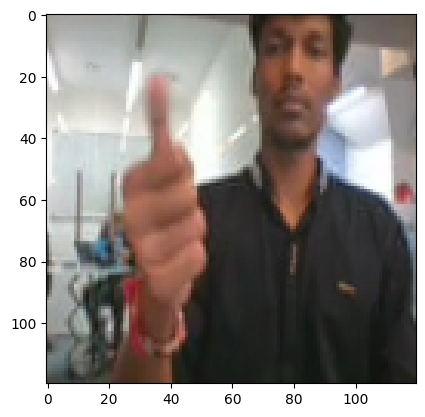

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_56_11_Pro_Thumbs_Up_new/WIN_20180925_17_56_11_Pro_00017.png


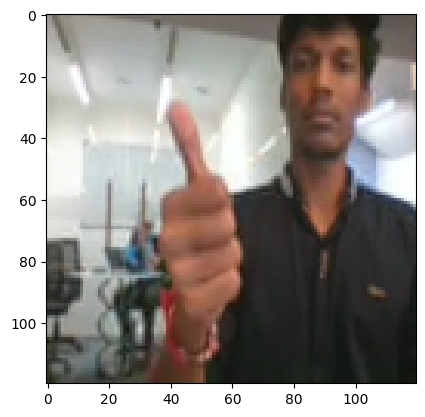

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_56_11_Pro_Thumbs_Up_new/WIN_20180925_17_56_11_Pro_00019.png


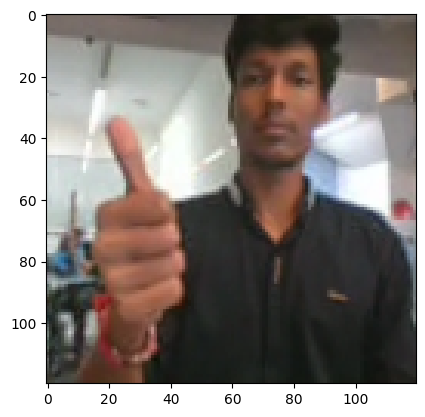

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_56_11_Pro_Thumbs_Up_new/WIN_20180925_17_56_11_Pro_00021.png


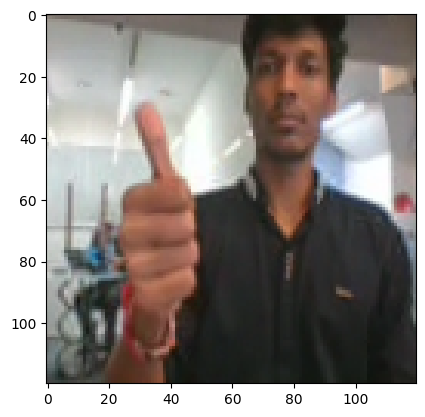

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_56_11_Pro_Thumbs_Up_new/WIN_20180925_17_56_11_Pro_00023.png


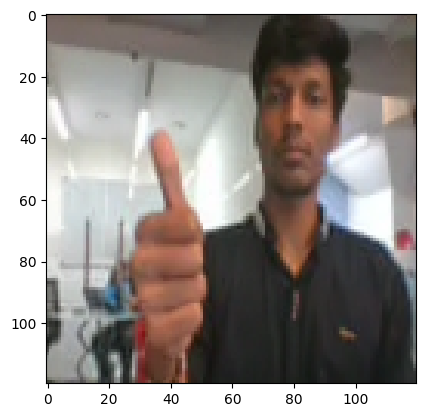

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_56_11_Pro_Thumbs_Up_new/WIN_20180925_17_56_11_Pro_00025.png


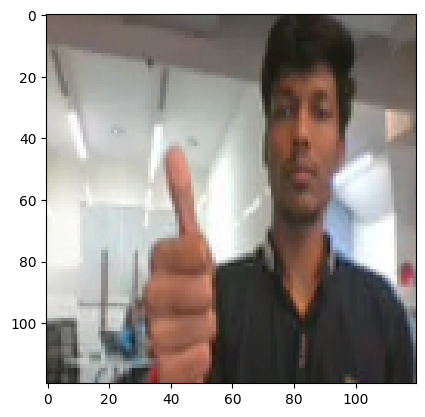

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_56_11_Pro_Thumbs_Up_new/WIN_20180925_17_56_11_Pro_00027.png


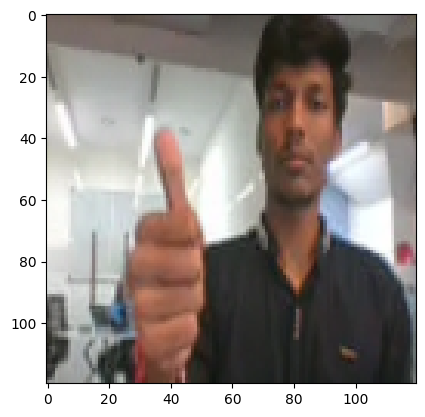

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_56_11_Pro_Thumbs_Up_new/WIN_20180925_17_56_11_Pro_00029.png


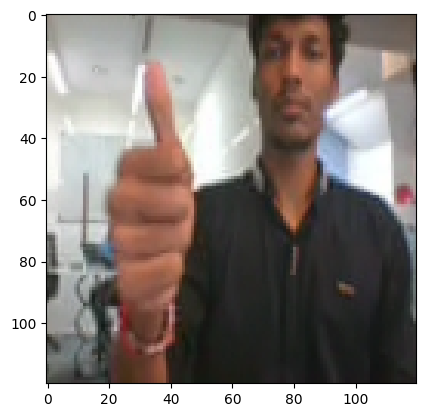

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_56_11_Pro_Thumbs_Up_new/WIN_20180925_17_56_11_Pro_00031.png


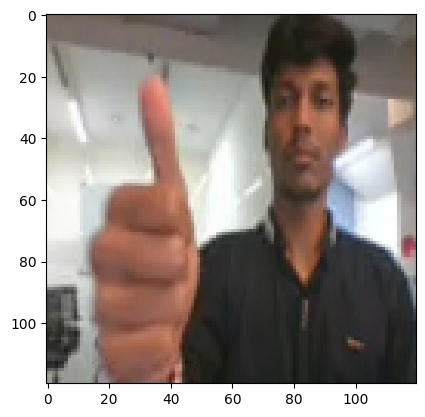

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_56_11_Pro_Thumbs_Up_new/WIN_20180925_17_56_11_Pro_00033.png


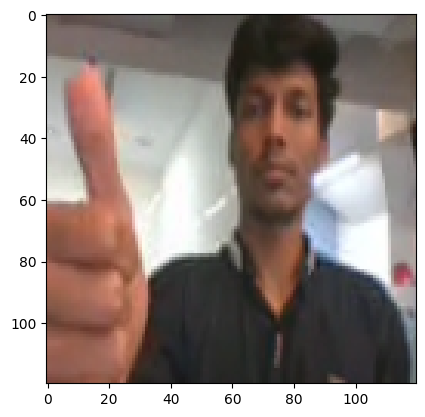

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_56_11_Pro_Thumbs_Up_new/WIN_20180925_17_56_11_Pro_00035.png


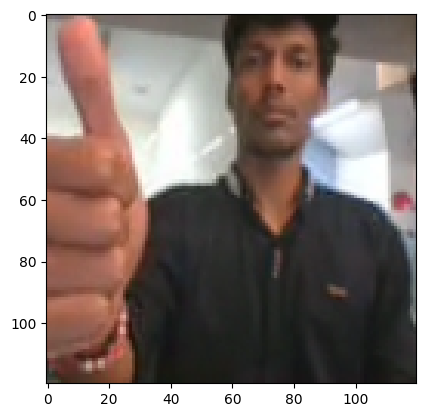

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_56_11_Pro_Thumbs_Up_new/WIN_20180925_17_56_11_Pro_00037.png


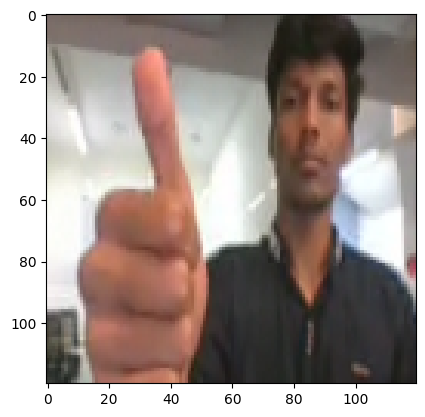

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_56_11_Pro_Thumbs_Up_new/WIN_20180925_17_56_11_Pro_00039.png


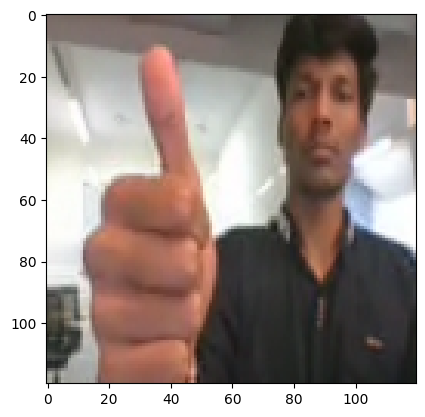

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_56_11_Pro_Thumbs_Up_new/WIN_20180925_17_56_11_Pro_00041.png


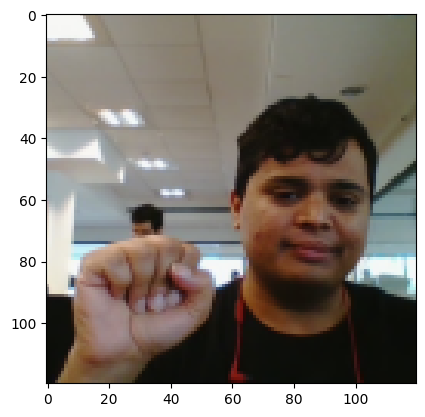

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_24_28_Pro_Stop Gesture_new/WIN_20180907_16_24_28_Pro_00006.png


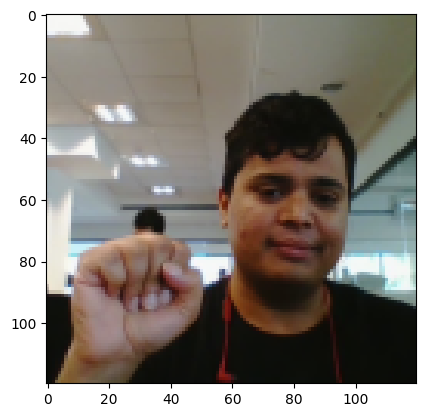

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_24_28_Pro_Stop Gesture_new/WIN_20180907_16_24_28_Pro_00010.png


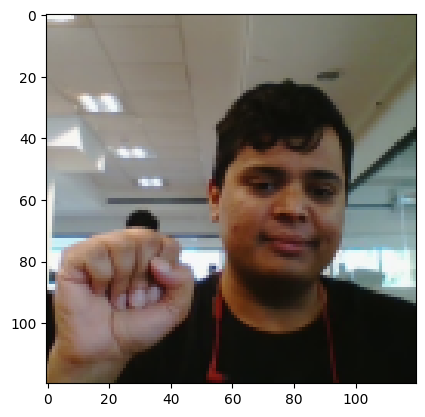

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_24_28_Pro_Stop Gesture_new/WIN_20180907_16_24_28_Pro_00014.png


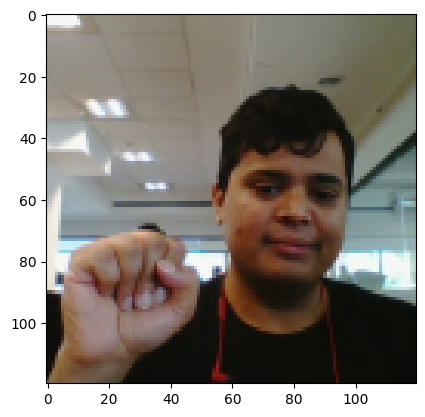

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_24_28_Pro_Stop Gesture_new/WIN_20180907_16_24_28_Pro_00018.png


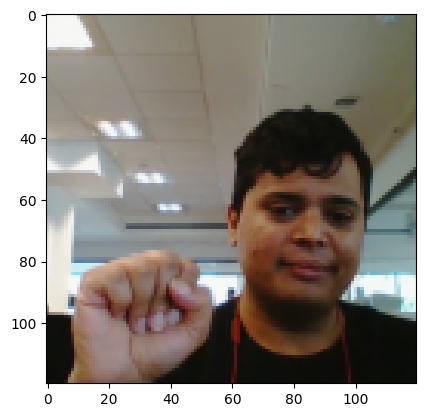

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_24_28_Pro_Stop Gesture_new/WIN_20180907_16_24_28_Pro_00022.png


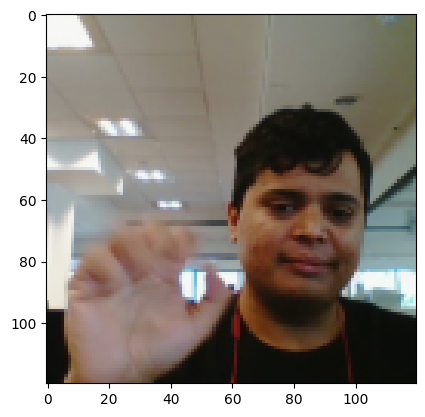

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_24_28_Pro_Stop Gesture_new/WIN_20180907_16_24_28_Pro_00026.png


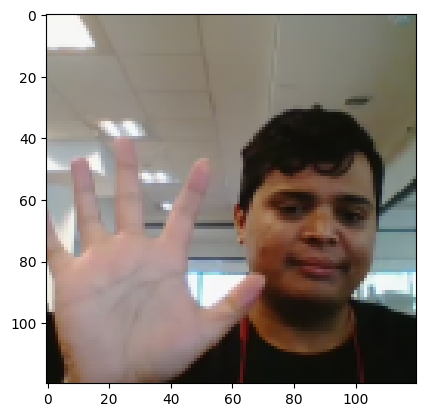

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_24_28_Pro_Stop Gesture_new/WIN_20180907_16_24_28_Pro_00030.png


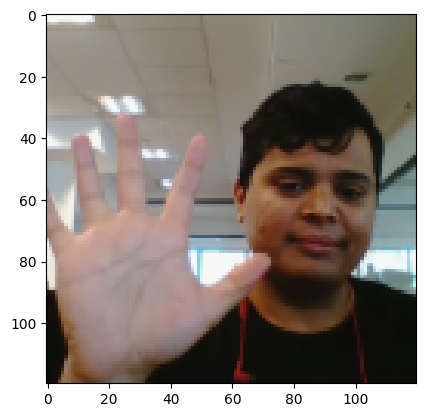

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_24_28_Pro_Stop Gesture_new/WIN_20180907_16_24_28_Pro_00034.png


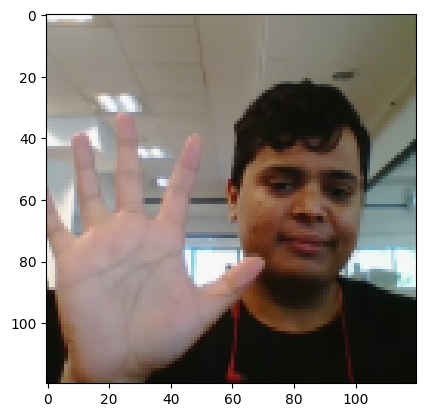

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_24_28_Pro_Stop Gesture_new/WIN_20180907_16_24_28_Pro_00038.png


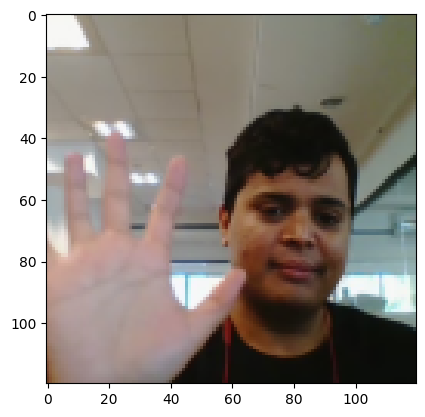

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_24_28_Pro_Stop Gesture_new/WIN_20180907_16_24_28_Pro_00042.png


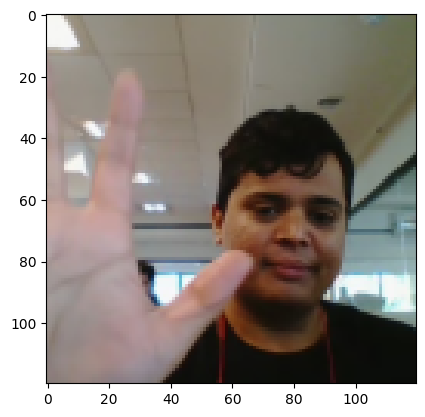

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_24_28_Pro_Stop Gesture_new/WIN_20180907_16_24_28_Pro_00046.png


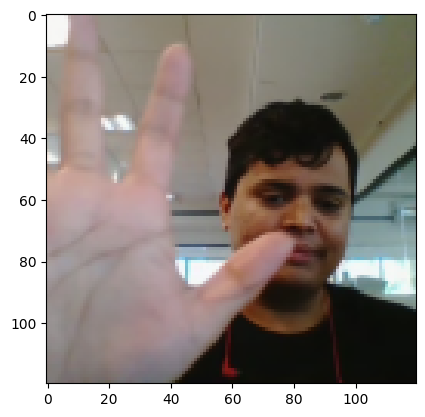

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_24_28_Pro_Stop Gesture_new/WIN_20180907_16_24_28_Pro_00050.png


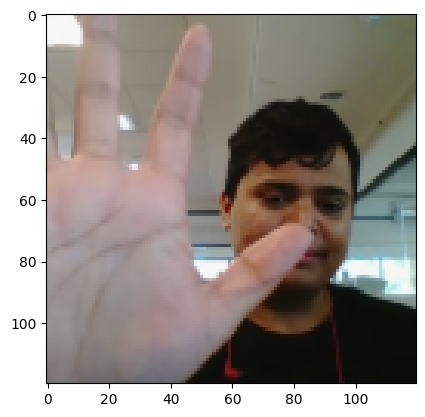

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_24_28_Pro_Stop Gesture_new/WIN_20180907_16_24_28_Pro_00054.png


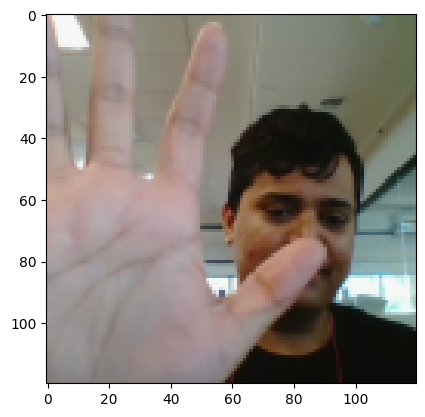

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_24_28_Pro_Stop Gesture_new/WIN_20180907_16_24_28_Pro_00058.png


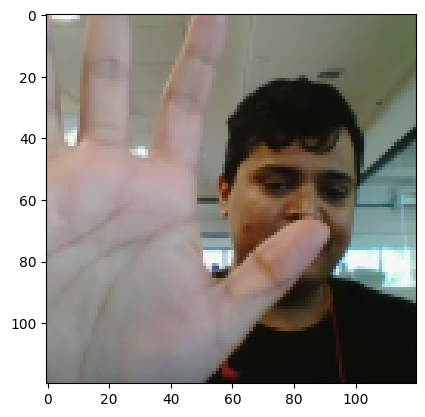

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_24_28_Pro_Stop Gesture_new/WIN_20180907_16_24_28_Pro_00062.png


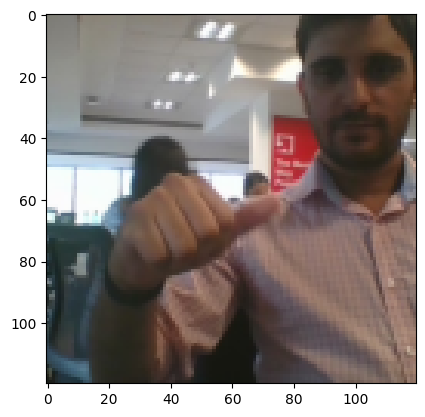

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_08_56_Pro_Thumbs Up_new/WIN_20180907_16_08_56_Pro_00004.png


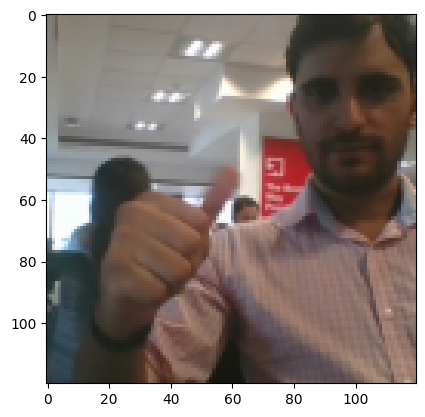

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_08_56_Pro_Thumbs Up_new/WIN_20180907_16_08_56_Pro_00008.png


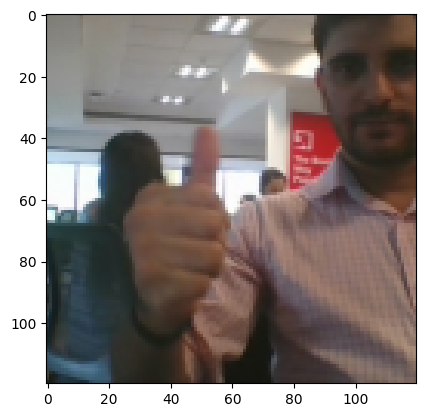

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_08_56_Pro_Thumbs Up_new/WIN_20180907_16_08_56_Pro_00012.png


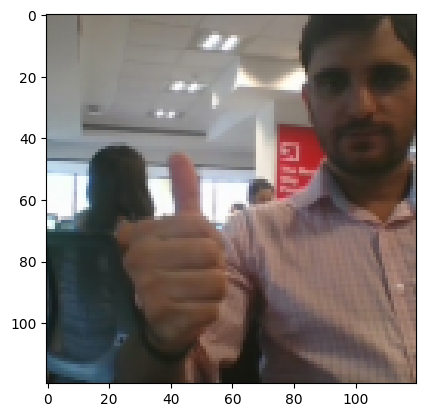

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_08_56_Pro_Thumbs Up_new/WIN_20180907_16_08_56_Pro_00016.png


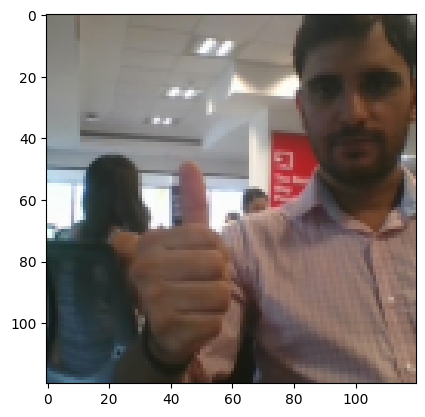

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_08_56_Pro_Thumbs Up_new/WIN_20180907_16_08_56_Pro_00020.png


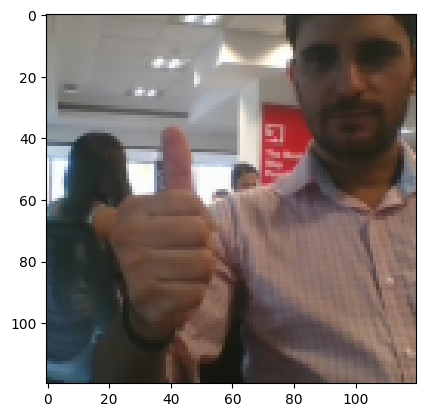

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_08_56_Pro_Thumbs Up_new/WIN_20180907_16_08_56_Pro_00024.png


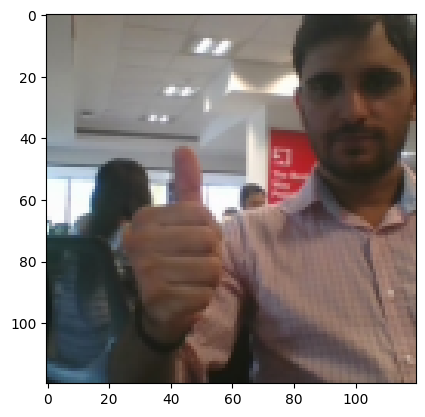

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_08_56_Pro_Thumbs Up_new/WIN_20180907_16_08_56_Pro_00028.png


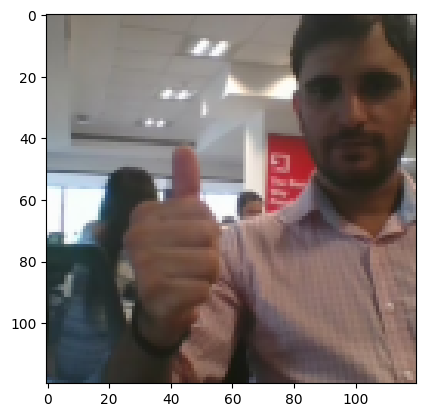

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_08_56_Pro_Thumbs Up_new/WIN_20180907_16_08_56_Pro_00032.png


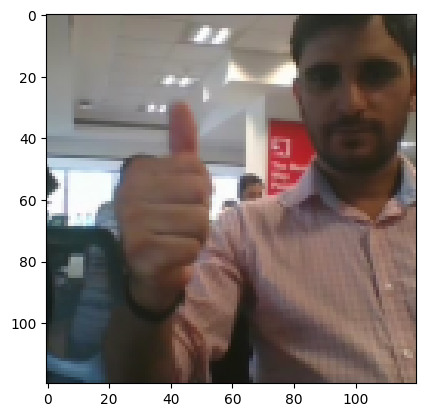

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_08_56_Pro_Thumbs Up_new/WIN_20180907_16_08_56_Pro_00036.png


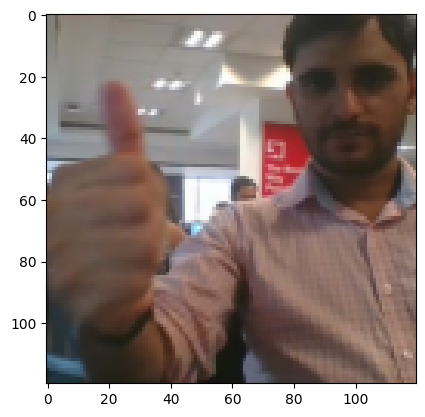

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_08_56_Pro_Thumbs Up_new/WIN_20180907_16_08_56_Pro_00040.png


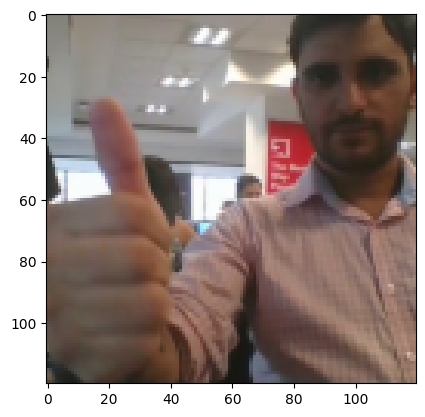

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_08_56_Pro_Thumbs Up_new/WIN_20180907_16_08_56_Pro_00044.png


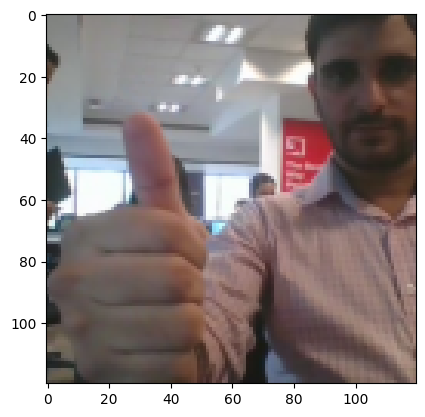

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_08_56_Pro_Thumbs Up_new/WIN_20180907_16_08_56_Pro_00048.png


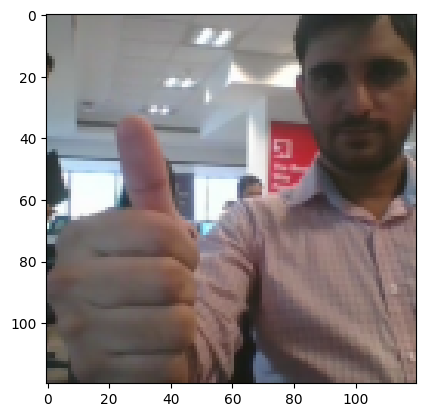

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_08_56_Pro_Thumbs Up_new/WIN_20180907_16_08_56_Pro_00052.png


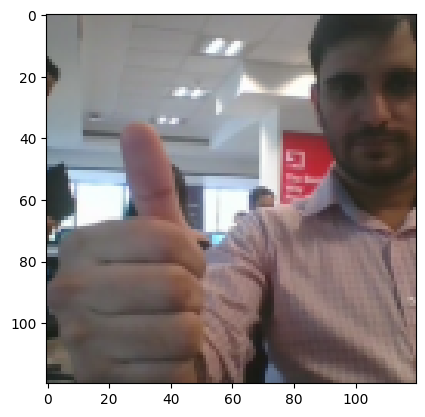

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_08_56_Pro_Thumbs Up_new/WIN_20180907_16_08_56_Pro_00056.png


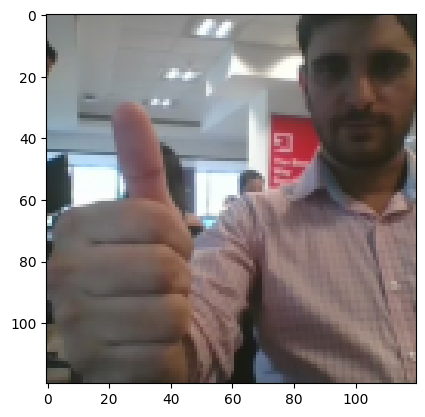

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_08_56_Pro_Thumbs Up_new/WIN_20180907_16_08_56_Pro_00060.png


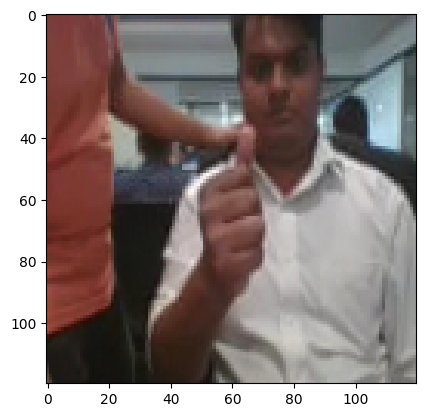

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_06_07_Pro_Thumbs_Up_new/WIN_20180926_17_06_07_Pro_00003.png


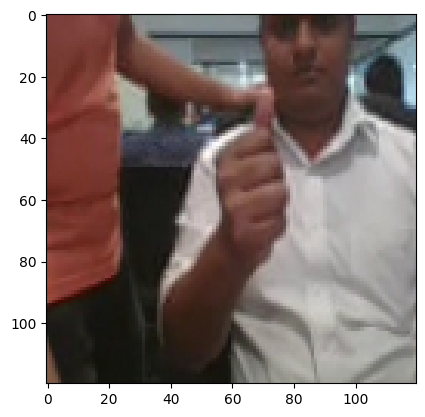

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_06_07_Pro_Thumbs_Up_new/WIN_20180926_17_06_07_Pro_00007.png


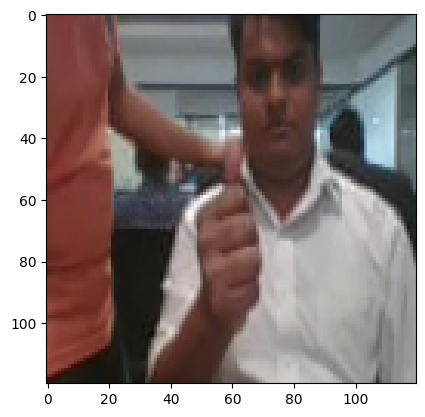

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_06_07_Pro_Thumbs_Up_new/WIN_20180926_17_06_07_Pro_00011.png


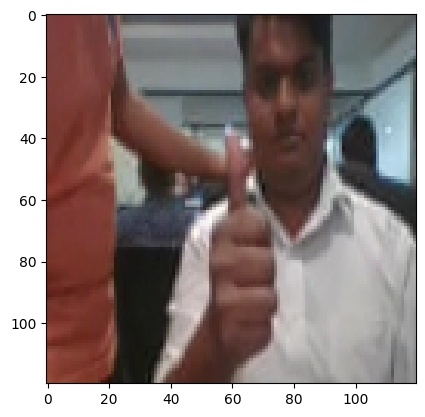

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_06_07_Pro_Thumbs_Up_new/WIN_20180926_17_06_07_Pro_00015.png


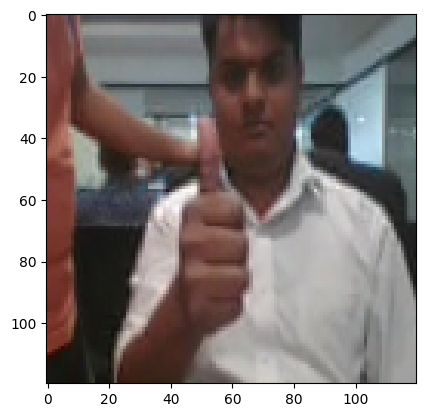

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_06_07_Pro_Thumbs_Up_new/WIN_20180926_17_06_07_Pro_00019.png


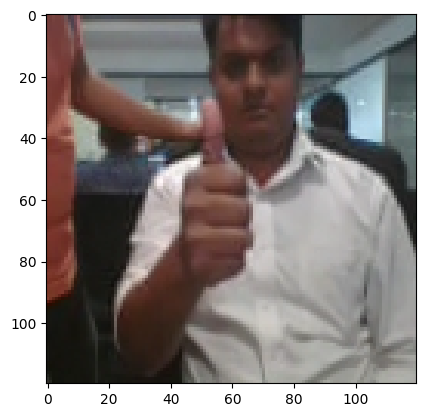

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_06_07_Pro_Thumbs_Up_new/WIN_20180926_17_06_07_Pro_00023.png


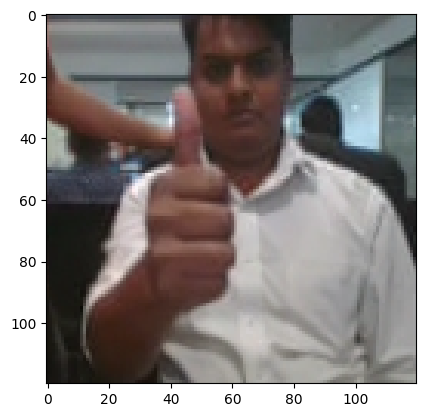

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_06_07_Pro_Thumbs_Up_new/WIN_20180926_17_06_07_Pro_00027.png


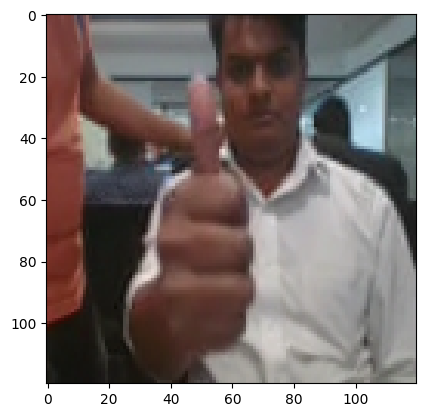

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_06_07_Pro_Thumbs_Up_new/WIN_20180926_17_06_07_Pro_00031.png


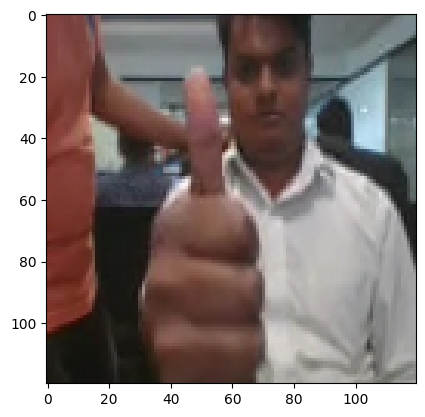

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_06_07_Pro_Thumbs_Up_new/WIN_20180926_17_06_07_Pro_00035.png


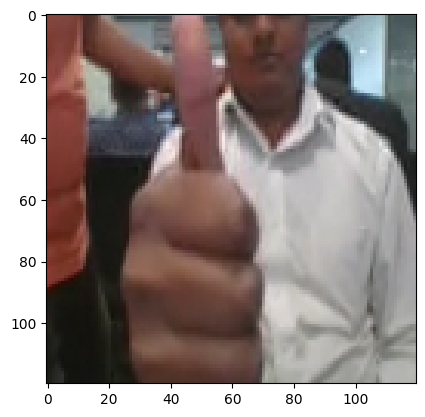

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_06_07_Pro_Thumbs_Up_new/WIN_20180926_17_06_07_Pro_00039.png


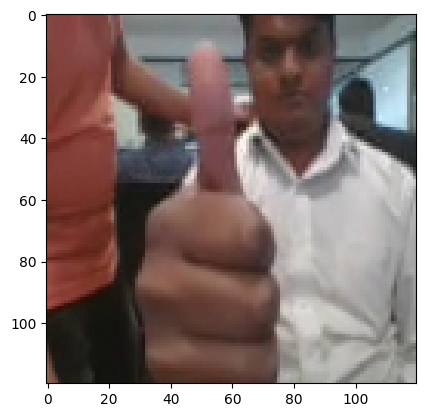

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_06_07_Pro_Thumbs_Up_new/WIN_20180926_17_06_07_Pro_00043.png


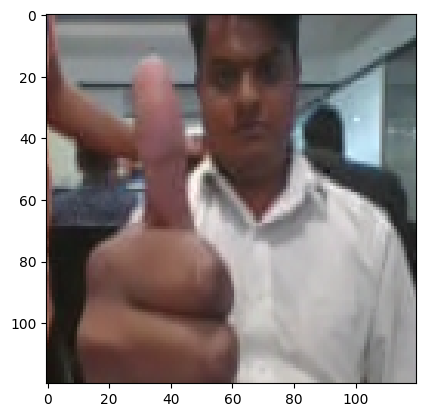

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_06_07_Pro_Thumbs_Up_new/WIN_20180926_17_06_07_Pro_00047.png


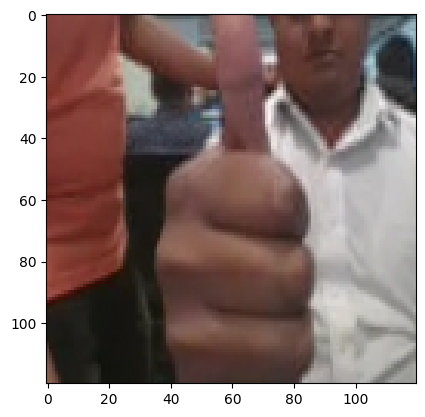

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_06_07_Pro_Thumbs_Up_new/WIN_20180926_17_06_07_Pro_00051.png


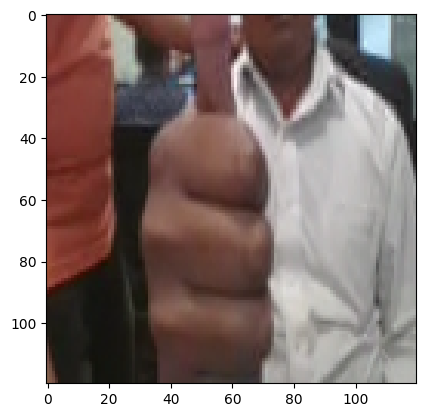

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_06_07_Pro_Thumbs_Up_new/WIN_20180926_17_06_07_Pro_00055.png


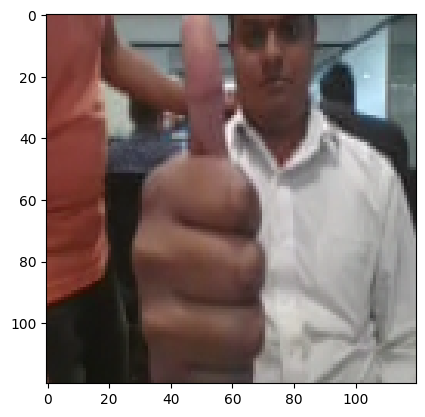

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_06_07_Pro_Thumbs_Up_new/WIN_20180926_17_06_07_Pro_00059.png


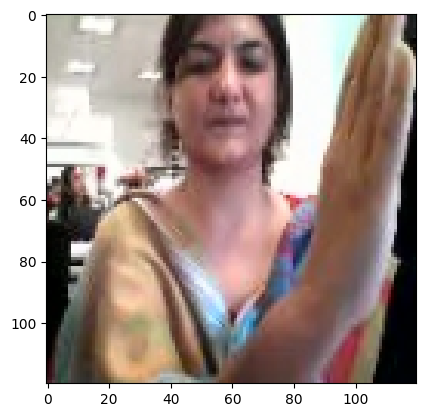

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_27_33_Pro_Right_Swipe_new/WIN_20180926_17_27_33_Pro_00004.png


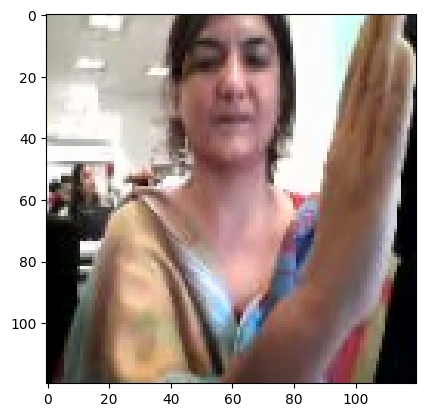

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_27_33_Pro_Right_Swipe_new/WIN_20180926_17_27_33_Pro_00008.png


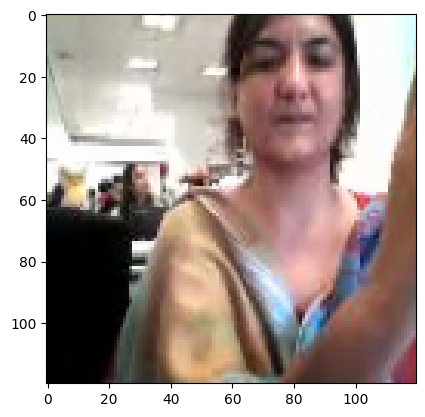

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_27_33_Pro_Right_Swipe_new/WIN_20180926_17_27_33_Pro_00012.png


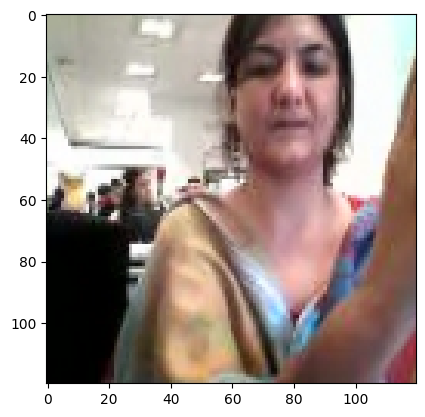

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_27_33_Pro_Right_Swipe_new/WIN_20180926_17_27_33_Pro_00016.png


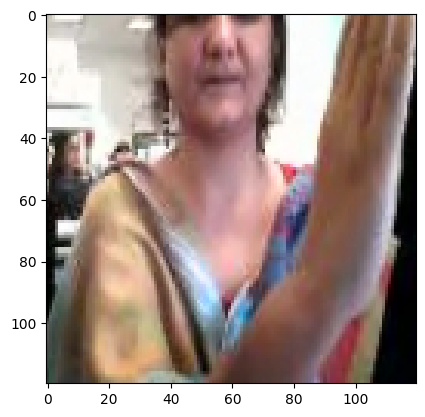

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_27_33_Pro_Right_Swipe_new/WIN_20180926_17_27_33_Pro_00020.png


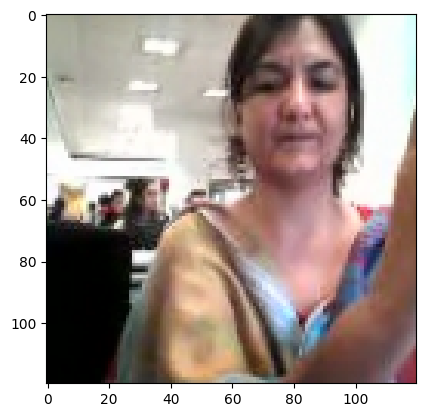

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_27_33_Pro_Right_Swipe_new/WIN_20180926_17_27_33_Pro_00024.png


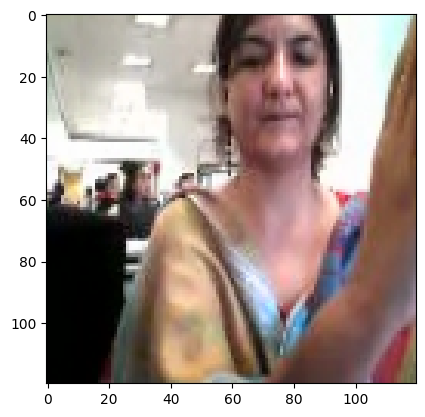

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_27_33_Pro_Right_Swipe_new/WIN_20180926_17_27_33_Pro_00028.png


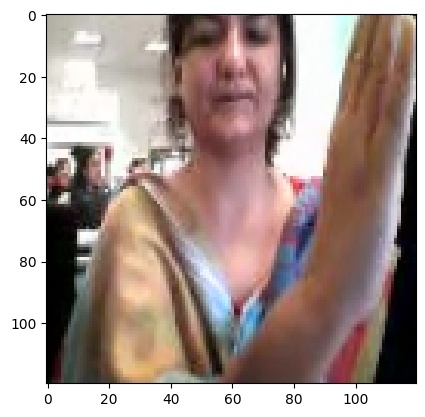

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_27_33_Pro_Right_Swipe_new/WIN_20180926_17_27_33_Pro_00032.png


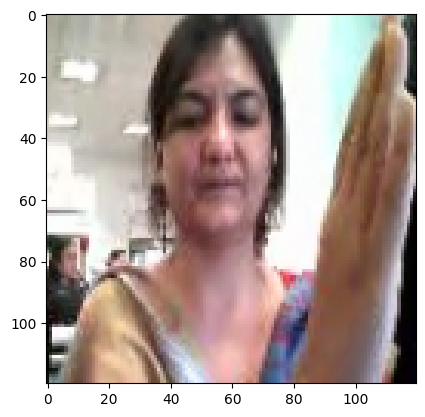

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_27_33_Pro_Right_Swipe_new/WIN_20180926_17_27_33_Pro_00036.png


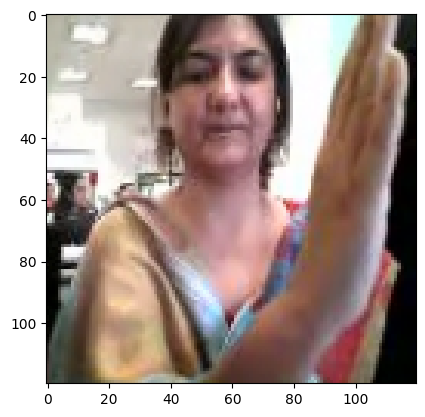

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_27_33_Pro_Right_Swipe_new/WIN_20180926_17_27_33_Pro_00040.png


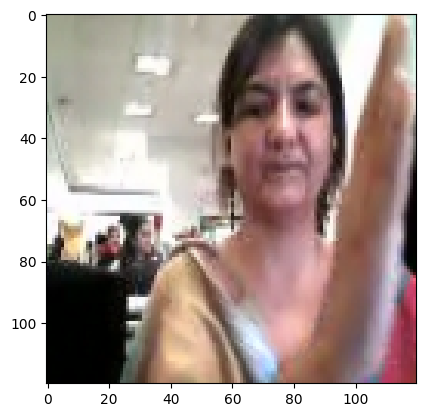

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_27_33_Pro_Right_Swipe_new/WIN_20180926_17_27_33_Pro_00044.png


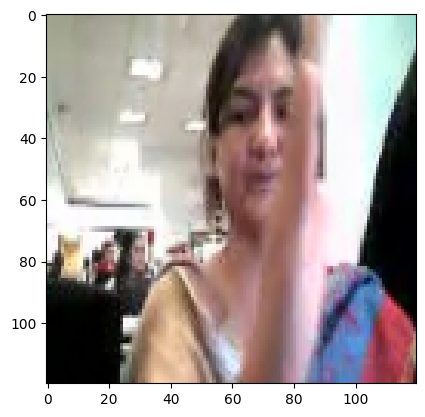

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_27_33_Pro_Right_Swipe_new/WIN_20180926_17_27_33_Pro_00048.png


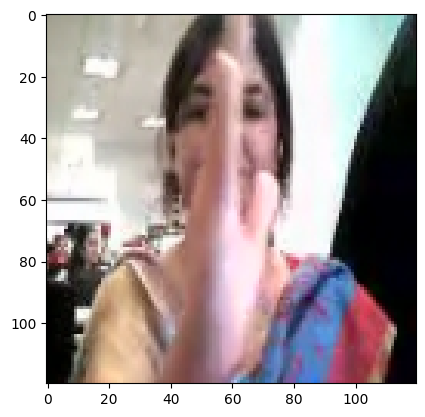

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_27_33_Pro_Right_Swipe_new/WIN_20180926_17_27_33_Pro_00052.png


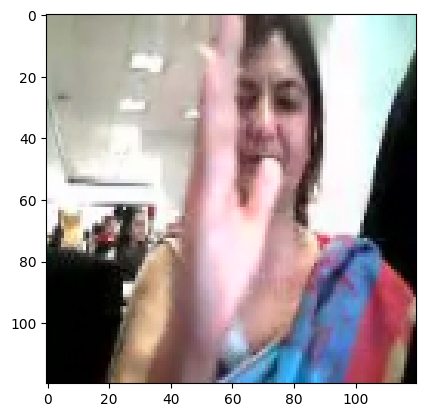

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_27_33_Pro_Right_Swipe_new/WIN_20180926_17_27_33_Pro_00056.png


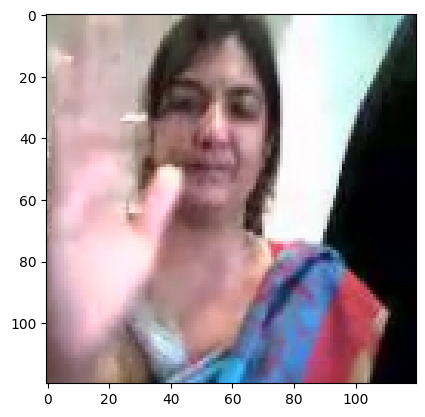

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_27_33_Pro_Right_Swipe_new/WIN_20180926_17_27_33_Pro_00060.png


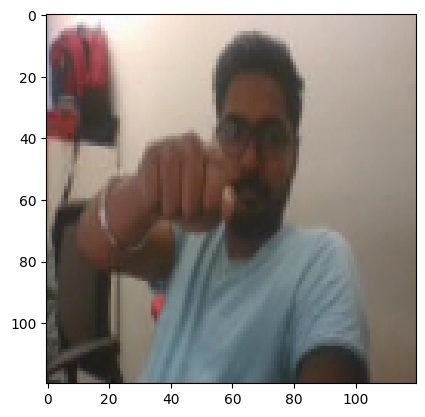

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_20_19_Pro_Thumbs_Down_new/WIN_20180925_18_20_19_Pro_00003.png


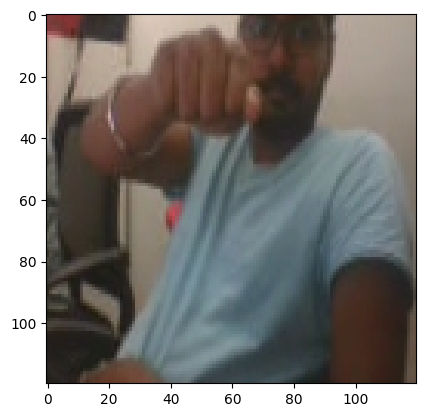

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_20_19_Pro_Thumbs_Down_new/WIN_20180925_18_20_19_Pro_00007.png


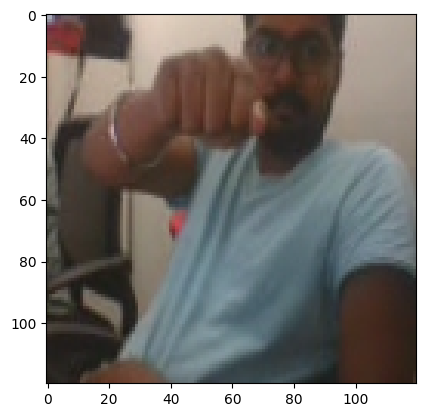

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_20_19_Pro_Thumbs_Down_new/WIN_20180925_18_20_19_Pro_00011.png


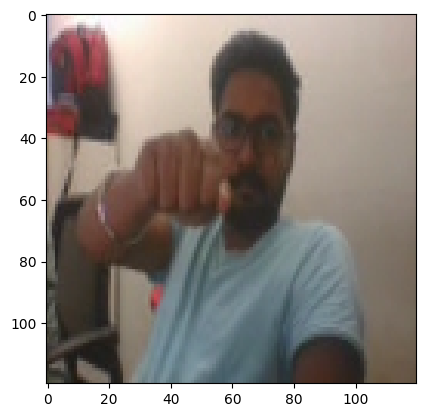

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_20_19_Pro_Thumbs_Down_new/WIN_20180925_18_20_19_Pro_00015.png


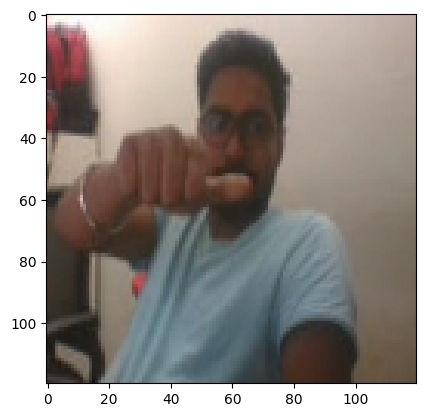

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_20_19_Pro_Thumbs_Down_new/WIN_20180925_18_20_19_Pro_00019.png


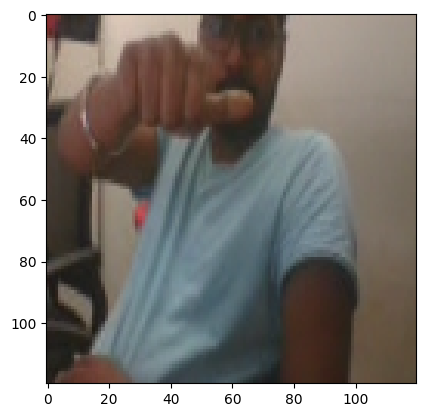

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_20_19_Pro_Thumbs_Down_new/WIN_20180925_18_20_19_Pro_00023.png


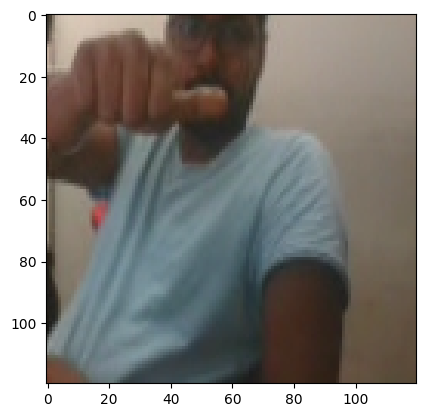

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_20_19_Pro_Thumbs_Down_new/WIN_20180925_18_20_19_Pro_00027.png


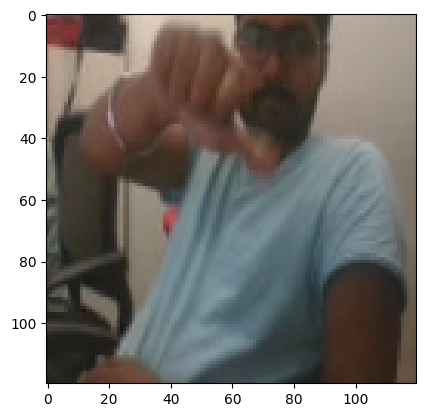

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_20_19_Pro_Thumbs_Down_new/WIN_20180925_18_20_19_Pro_00031.png


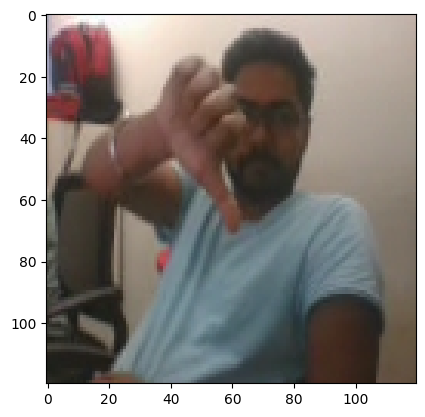

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_20_19_Pro_Thumbs_Down_new/WIN_20180925_18_20_19_Pro_00035.png


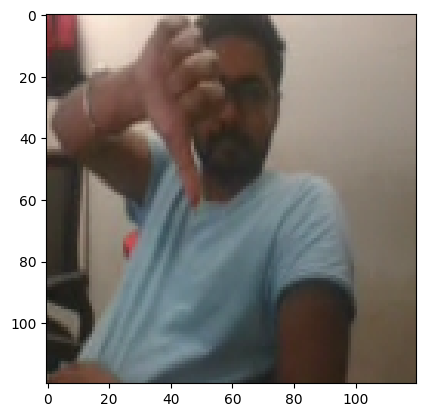

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_20_19_Pro_Thumbs_Down_new/WIN_20180925_18_20_19_Pro_00039.png


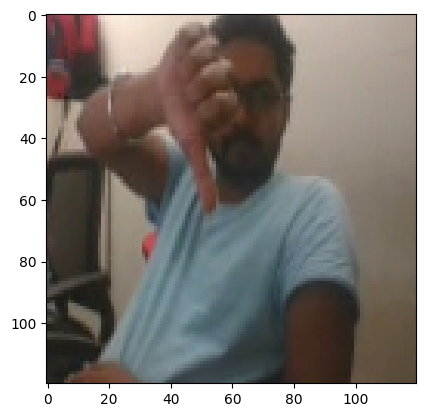

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_20_19_Pro_Thumbs_Down_new/WIN_20180925_18_20_19_Pro_00043.png


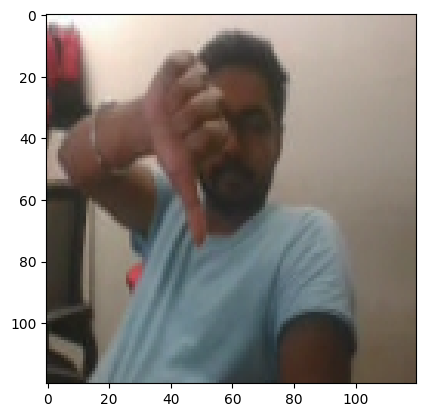

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_20_19_Pro_Thumbs_Down_new/WIN_20180925_18_20_19_Pro_00047.png


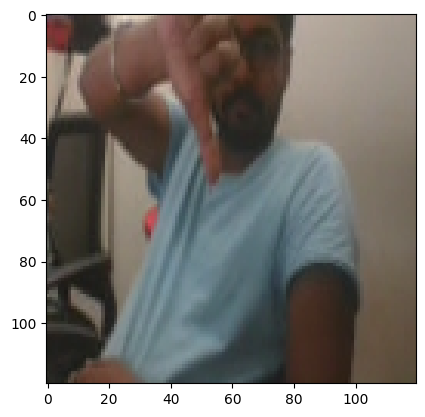

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_20_19_Pro_Thumbs_Down_new/WIN_20180925_18_20_19_Pro_00051.png


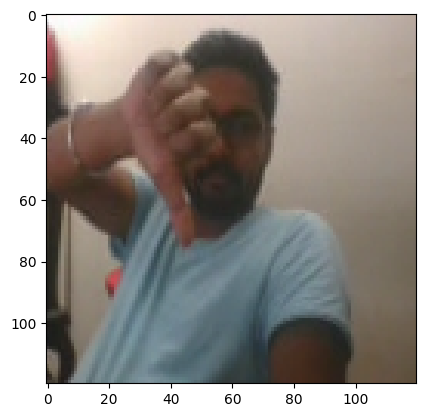

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_20_19_Pro_Thumbs_Down_new/WIN_20180925_18_20_19_Pro_00055.png


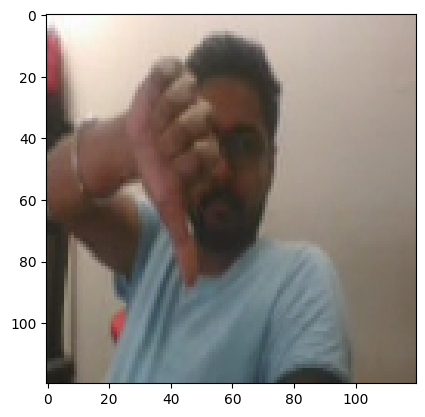

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_20_19_Pro_Thumbs_Down_new/WIN_20180925_18_20_19_Pro_00059.png


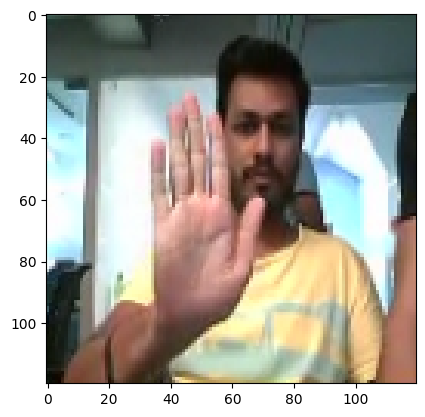

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_01_52_Pro_Stop_new/WIN_20180925_18_01_52_Pro_00011.png


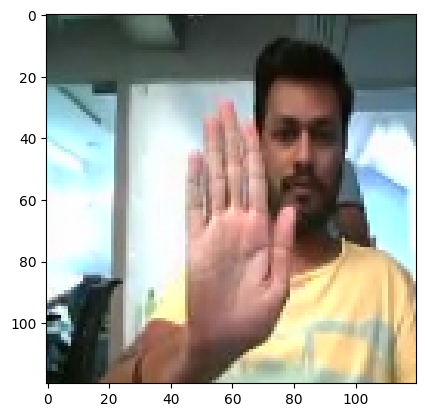

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_01_52_Pro_Stop_new/WIN_20180925_18_01_52_Pro_00013.png


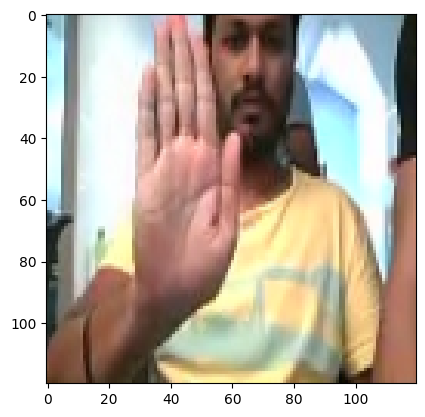

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_01_52_Pro_Stop_new/WIN_20180925_18_01_52_Pro_00015.png


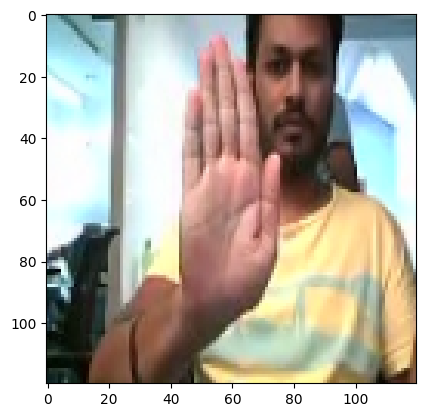

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_01_52_Pro_Stop_new/WIN_20180925_18_01_52_Pro_00017.png


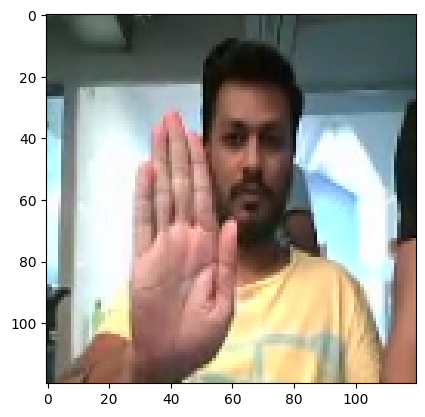

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_01_52_Pro_Stop_new/WIN_20180925_18_01_52_Pro_00019.png


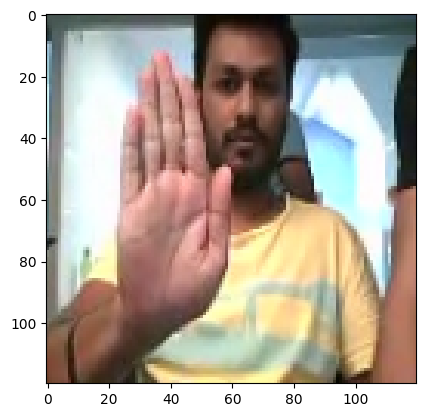

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_01_52_Pro_Stop_new/WIN_20180925_18_01_52_Pro_00021.png


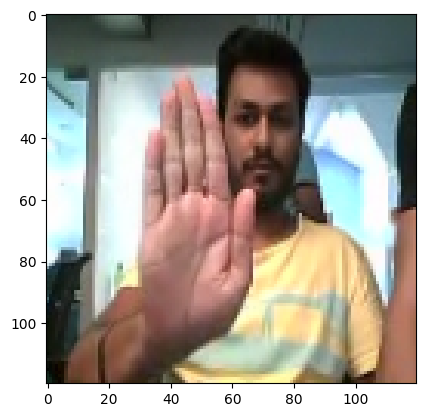

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_01_52_Pro_Stop_new/WIN_20180925_18_01_52_Pro_00023.png


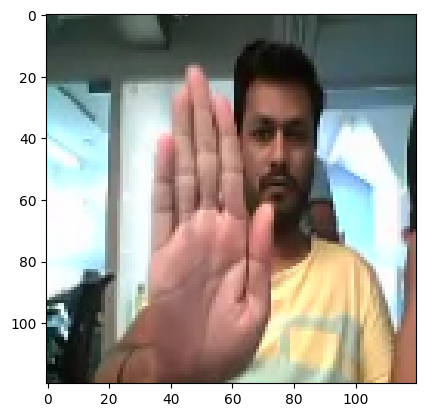

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_01_52_Pro_Stop_new/WIN_20180925_18_01_52_Pro_00025.png


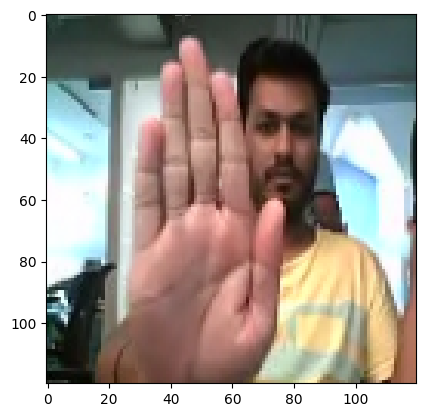

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_01_52_Pro_Stop_new/WIN_20180925_18_01_52_Pro_00027.png


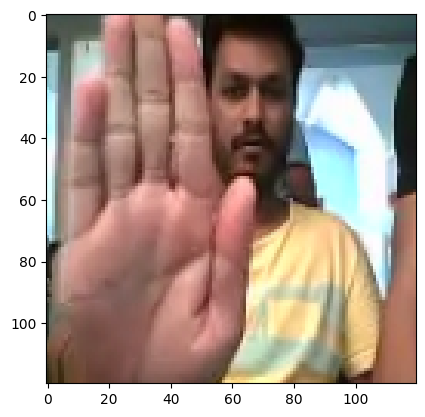

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_01_52_Pro_Stop_new/WIN_20180925_18_01_52_Pro_00029.png


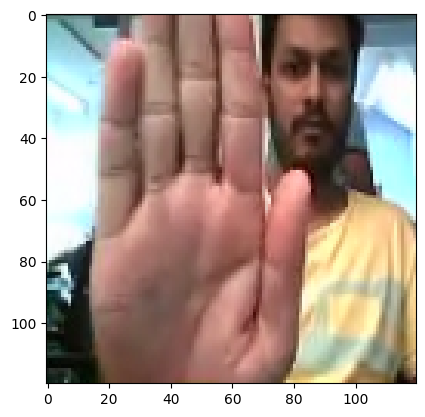

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_01_52_Pro_Stop_new/WIN_20180925_18_01_52_Pro_00031.png


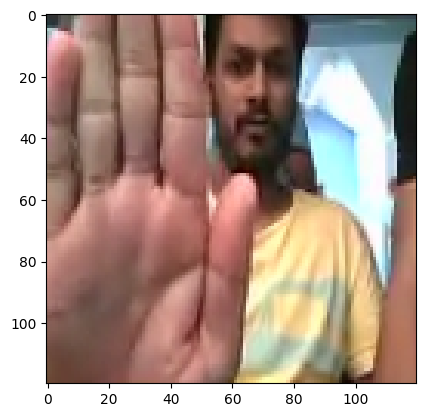

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_01_52_Pro_Stop_new/WIN_20180925_18_01_52_Pro_00033.png


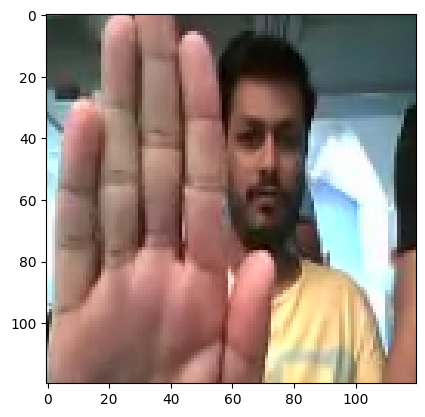

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_01_52_Pro_Stop_new/WIN_20180925_18_01_52_Pro_00035.png


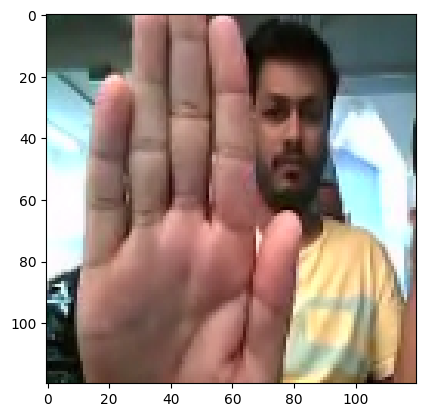

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_01_52_Pro_Stop_new/WIN_20180925_18_01_52_Pro_00037.png


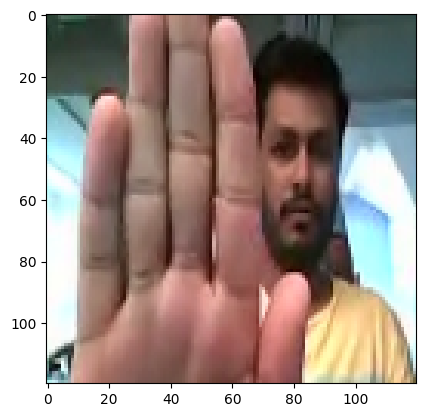

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_18_01_52_Pro_Stop_new/WIN_20180925_18_01_52_Pro_00039.png


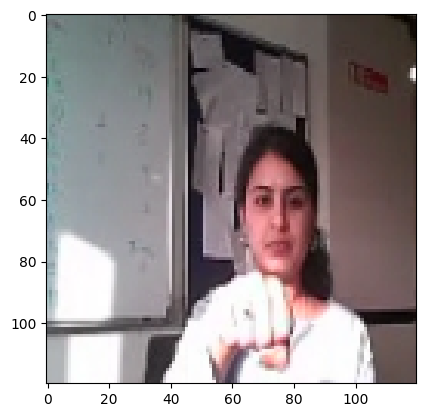

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_02_Pro_Stop_new/WIN_20180926_17_07_02_Pro_00005.png


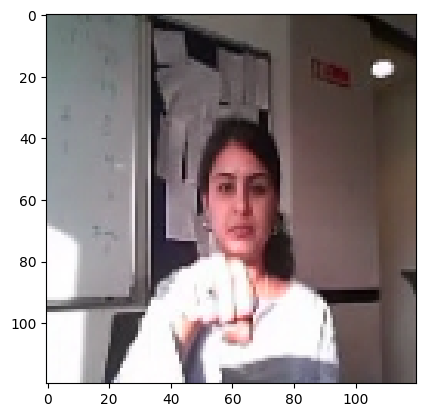

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_02_Pro_Stop_new/WIN_20180926_17_07_02_Pro_00009.png


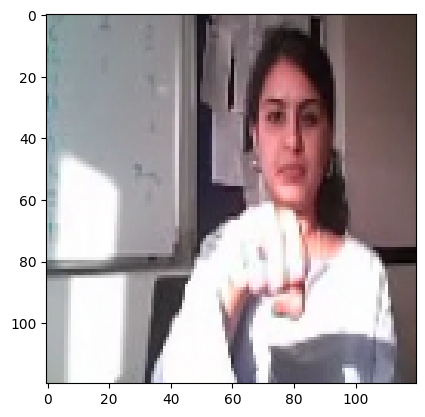

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_02_Pro_Stop_new/WIN_20180926_17_07_02_Pro_00013.png


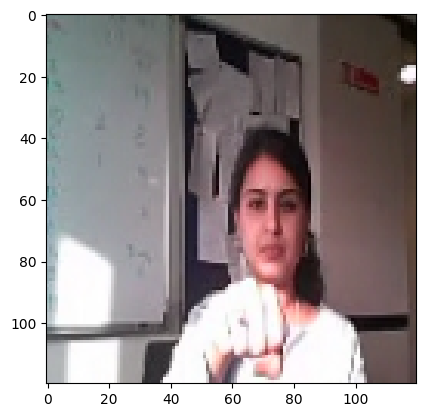

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_02_Pro_Stop_new/WIN_20180926_17_07_02_Pro_00017.png


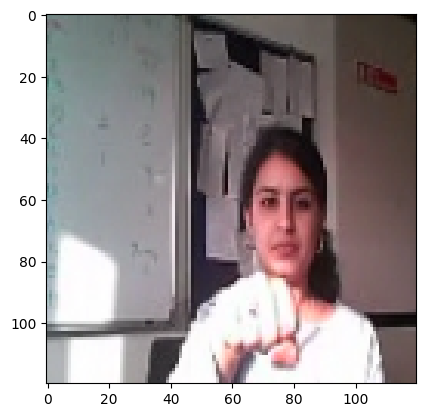

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_02_Pro_Stop_new/WIN_20180926_17_07_02_Pro_00021.png


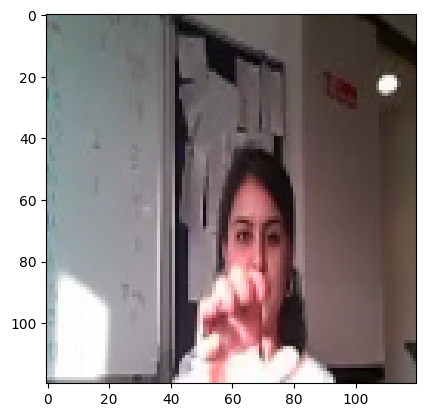

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_02_Pro_Stop_new/WIN_20180926_17_07_02_Pro_00025.png


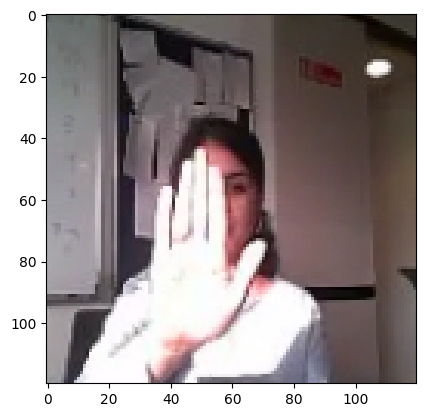

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_02_Pro_Stop_new/WIN_20180926_17_07_02_Pro_00029.png


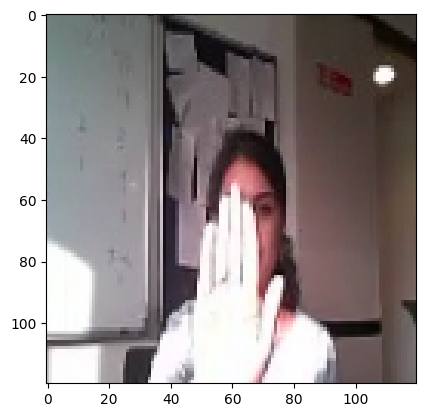

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_02_Pro_Stop_new/WIN_20180926_17_07_02_Pro_00033.png


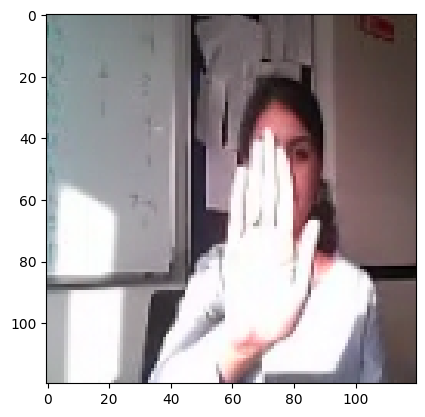

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_02_Pro_Stop_new/WIN_20180926_17_07_02_Pro_00037.png


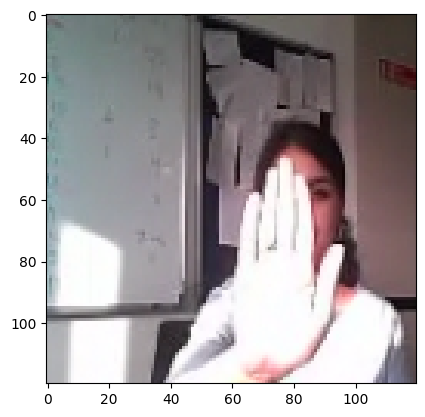

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_02_Pro_Stop_new/WIN_20180926_17_07_02_Pro_00041.png


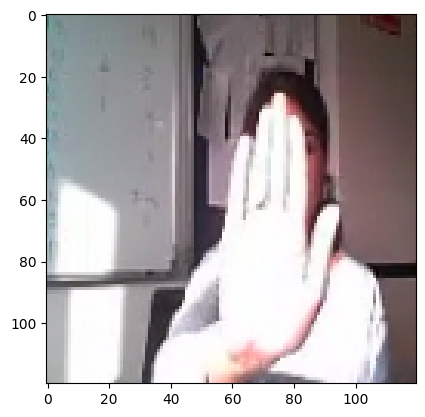

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_02_Pro_Stop_new/WIN_20180926_17_07_02_Pro_00045.png


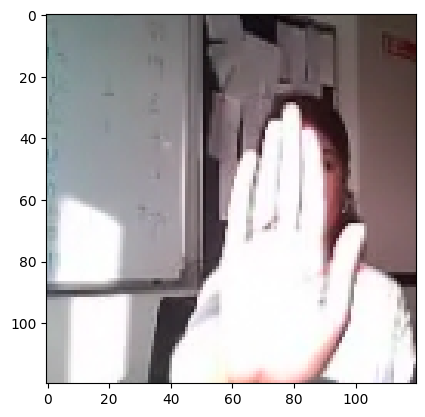

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_02_Pro_Stop_new/WIN_20180926_17_07_02_Pro_00049.png


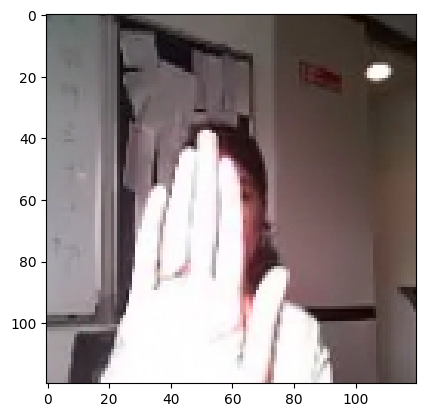

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_02_Pro_Stop_new/WIN_20180926_17_07_02_Pro_00053.png


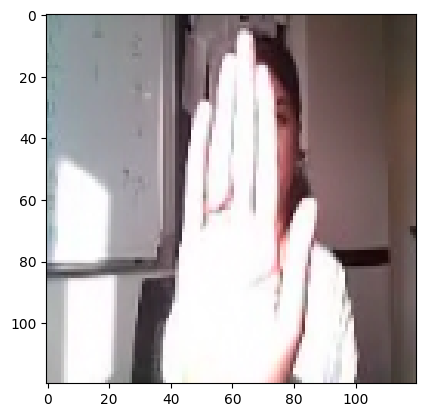

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_02_Pro_Stop_new/WIN_20180926_17_07_02_Pro_00057.png


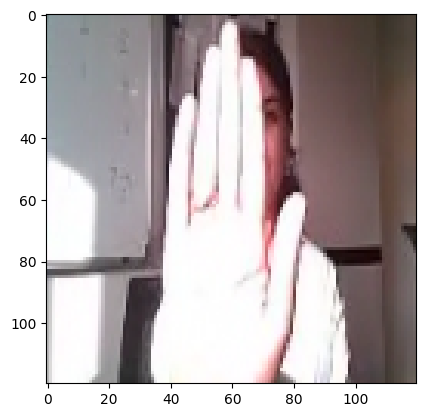

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_07_02_Pro_Stop_new/WIN_20180926_17_07_02_Pro_00061.png


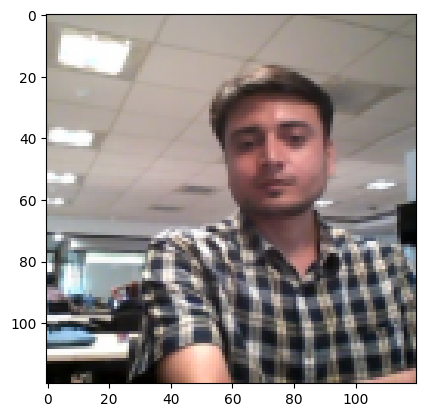

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_12_20_Pro_Right Swipe_new/WIN_20180907_16_12_20_Pro_00007.png


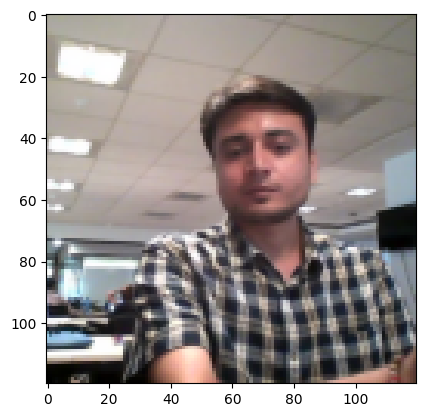

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_12_20_Pro_Right Swipe_new/WIN_20180907_16_12_20_Pro_00011.png


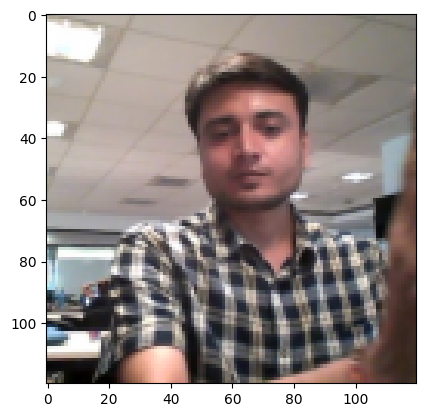

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_12_20_Pro_Right Swipe_new/WIN_20180907_16_12_20_Pro_00015.png


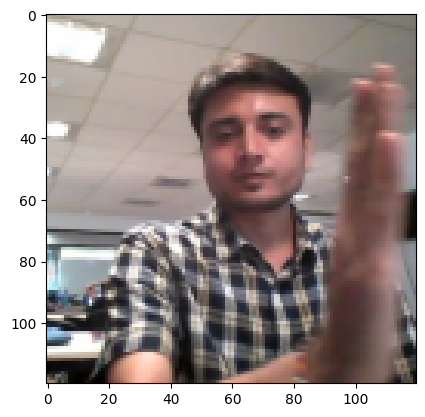

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_12_20_Pro_Right Swipe_new/WIN_20180907_16_12_20_Pro_00019.png


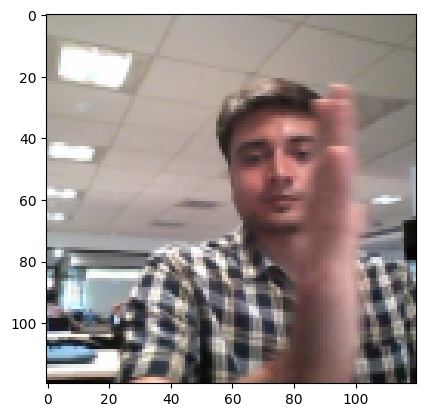

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_12_20_Pro_Right Swipe_new/WIN_20180907_16_12_20_Pro_00023.png


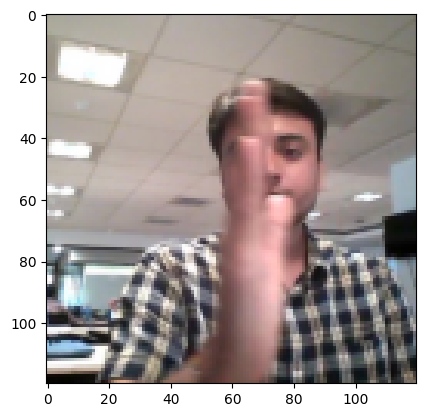

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_12_20_Pro_Right Swipe_new/WIN_20180907_16_12_20_Pro_00027.png


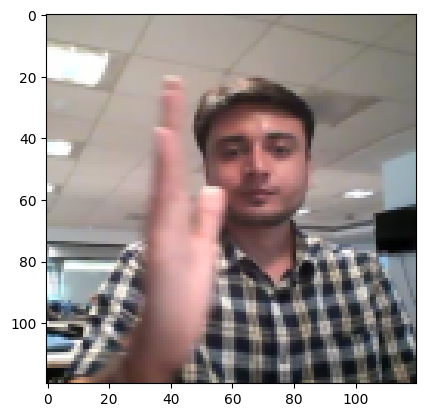

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_12_20_Pro_Right Swipe_new/WIN_20180907_16_12_20_Pro_00031.png


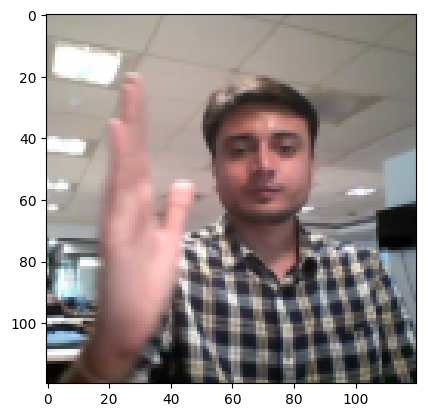

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_12_20_Pro_Right Swipe_new/WIN_20180907_16_12_20_Pro_00035.png


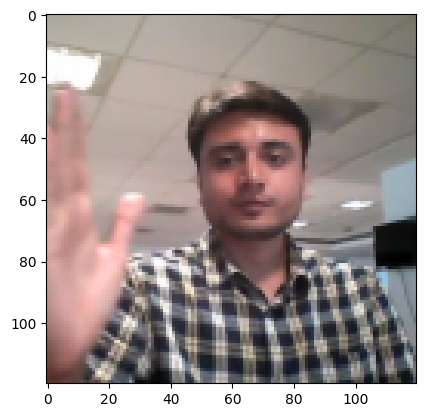

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_12_20_Pro_Right Swipe_new/WIN_20180907_16_12_20_Pro_00039.png


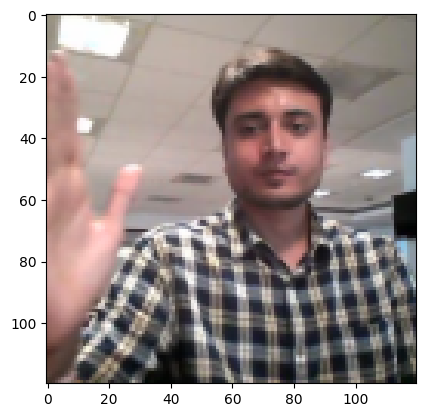

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_12_20_Pro_Right Swipe_new/WIN_20180907_16_12_20_Pro_00043.png


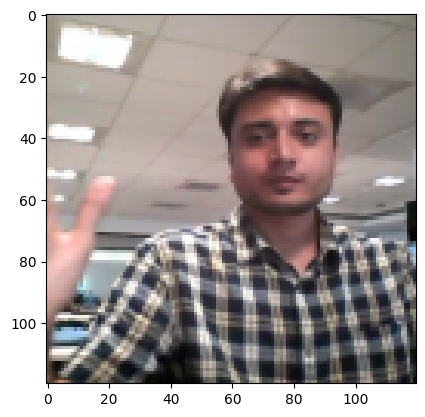

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_12_20_Pro_Right Swipe_new/WIN_20180907_16_12_20_Pro_00047.png


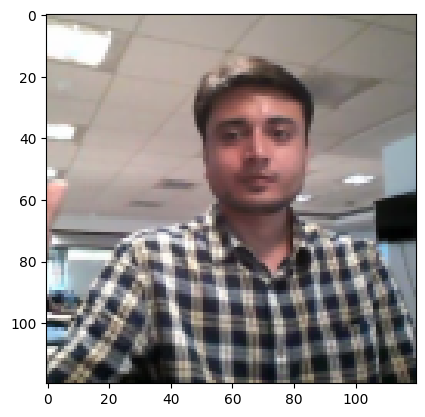

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_12_20_Pro_Right Swipe_new/WIN_20180907_16_12_20_Pro_00051.png


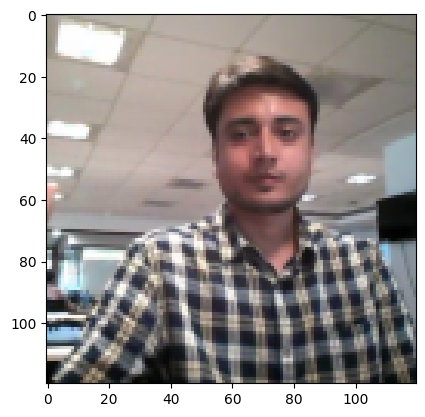

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_12_20_Pro_Right Swipe_new/WIN_20180907_16_12_20_Pro_00055.png


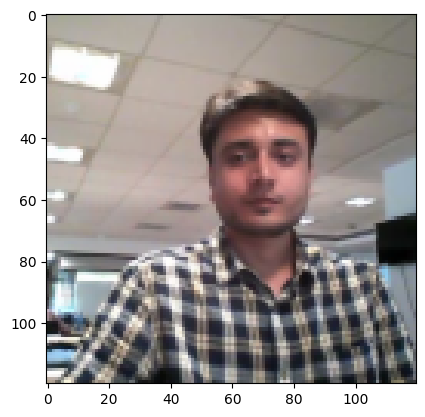

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_12_20_Pro_Right Swipe_new/WIN_20180907_16_12_20_Pro_00059.png


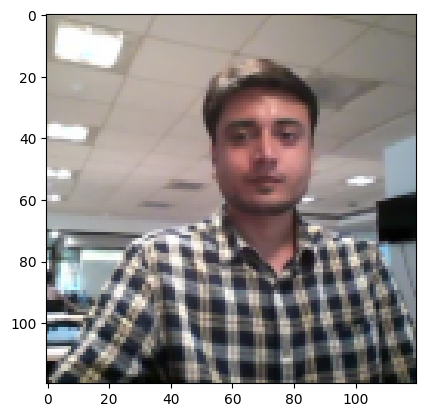

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_12_20_Pro_Right Swipe_new/WIN_20180907_16_12_20_Pro_00063.png


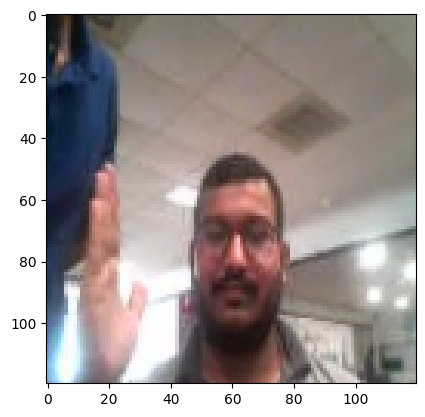

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_16_44_37_Pro_Left_Swipe_new/WIN_20180926_16_44_37_Pro_00012.png


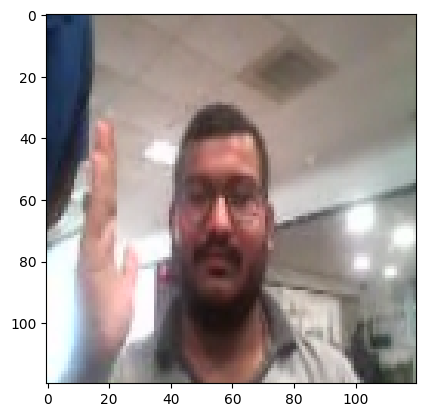

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_16_44_37_Pro_Left_Swipe_new/WIN_20180926_16_44_37_Pro_00016.png


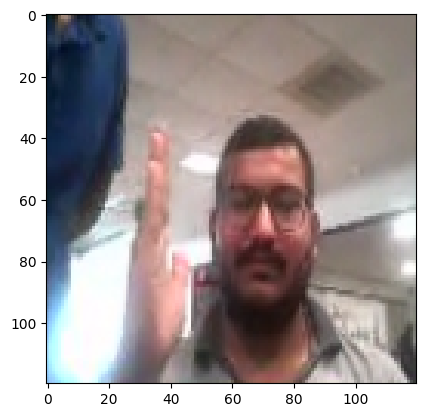

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_16_44_37_Pro_Left_Swipe_new/WIN_20180926_16_44_37_Pro_00020.png


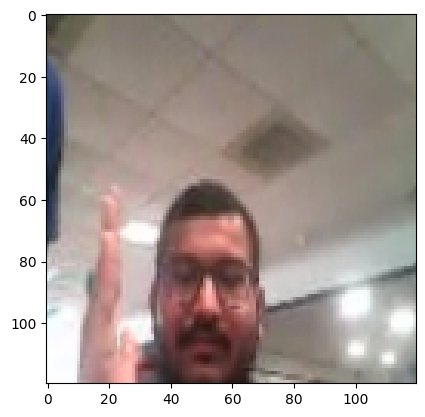

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_16_44_37_Pro_Left_Swipe_new/WIN_20180926_16_44_37_Pro_00024.png


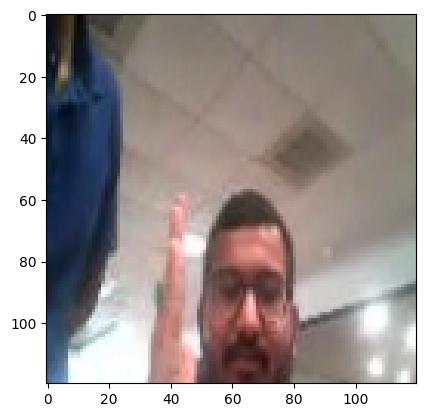

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_16_44_37_Pro_Left_Swipe_new/WIN_20180926_16_44_37_Pro_00028.png


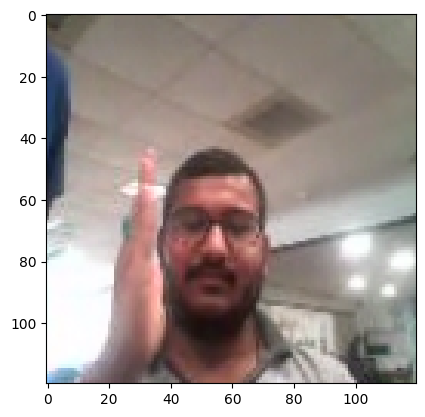

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_16_44_37_Pro_Left_Swipe_new/WIN_20180926_16_44_37_Pro_00032.png


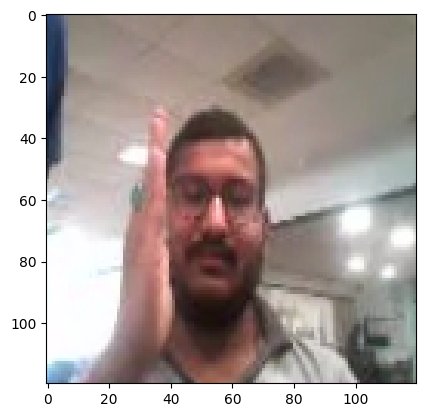

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_16_44_37_Pro_Left_Swipe_new/WIN_20180926_16_44_37_Pro_00036.png


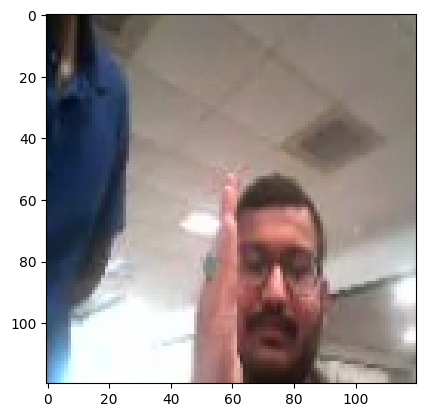

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_16_44_37_Pro_Left_Swipe_new/WIN_20180926_16_44_37_Pro_00040.png


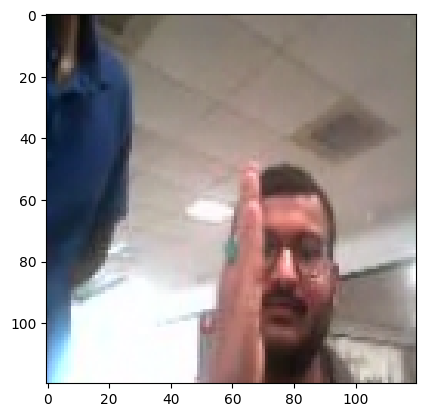

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_16_44_37_Pro_Left_Swipe_new/WIN_20180926_16_44_37_Pro_00044.png


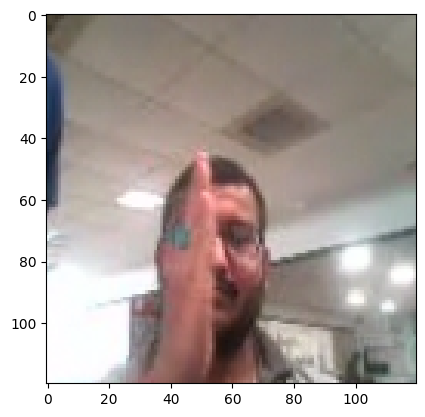

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_16_44_37_Pro_Left_Swipe_new/WIN_20180926_16_44_37_Pro_00048.png


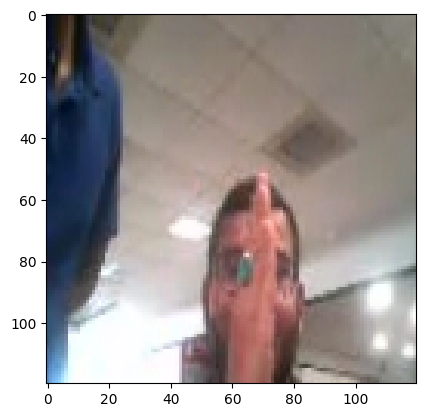

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_16_44_37_Pro_Left_Swipe_new/WIN_20180926_16_44_37_Pro_00052.png


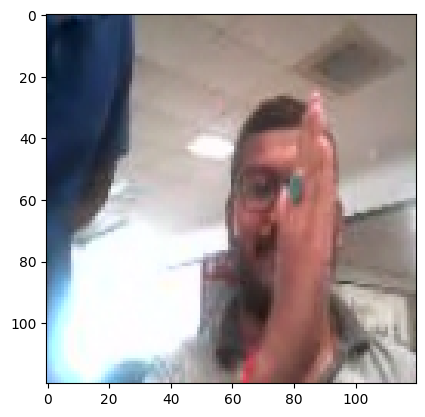

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_16_44_37_Pro_Left_Swipe_new/WIN_20180926_16_44_37_Pro_00056.png


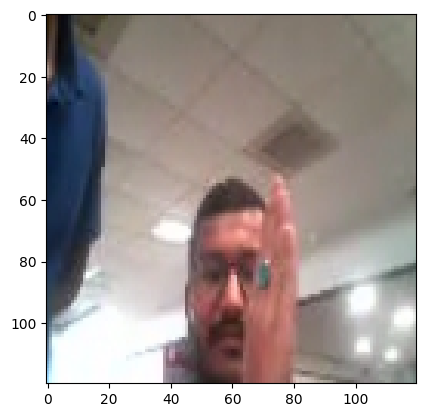

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_16_44_37_Pro_Left_Swipe_new/WIN_20180926_16_44_37_Pro_00060.png


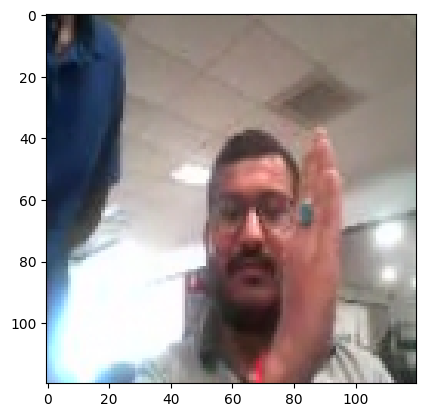

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_16_44_37_Pro_Left_Swipe_new/WIN_20180926_16_44_37_Pro_00064.png


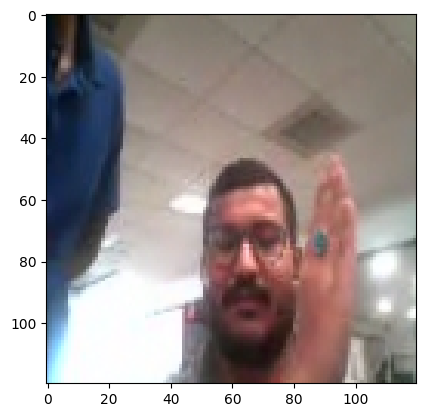

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_16_44_37_Pro_Left_Swipe_new/WIN_20180926_16_44_37_Pro_00068.png


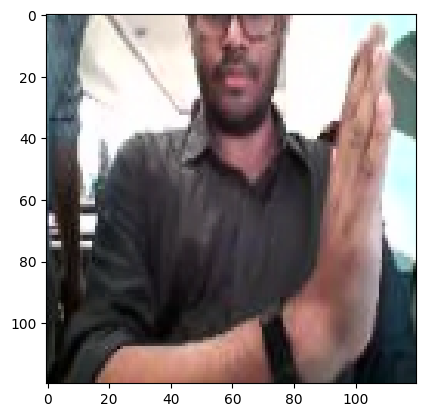

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_25_30_Pro_Right_Swipe_new/WIN_20180926_17_25_30_Pro_00002.png


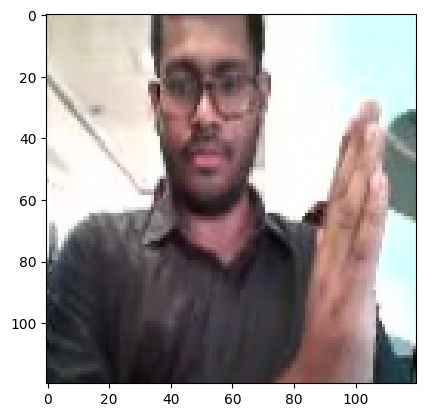

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_25_30_Pro_Right_Swipe_new/WIN_20180926_17_25_30_Pro_00006.png


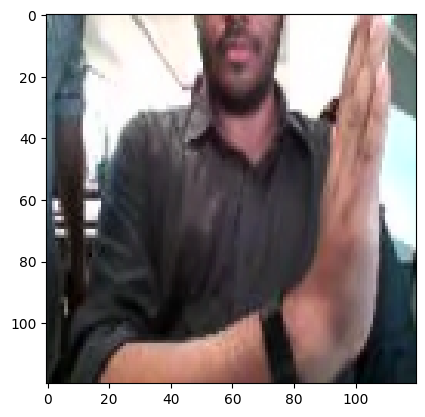

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_25_30_Pro_Right_Swipe_new/WIN_20180926_17_25_30_Pro_00010.png


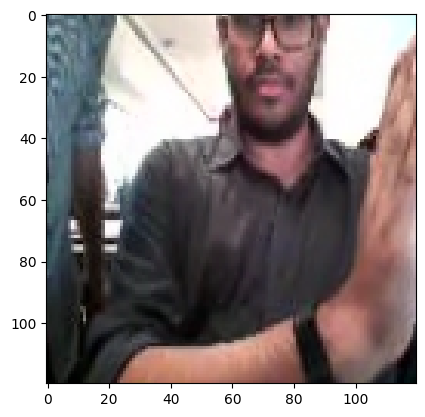

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_25_30_Pro_Right_Swipe_new/WIN_20180926_17_25_30_Pro_00014.png


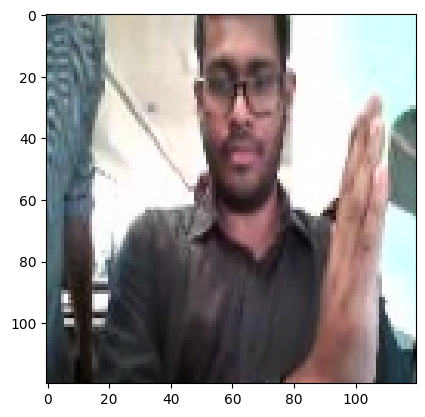

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_25_30_Pro_Right_Swipe_new/WIN_20180926_17_25_30_Pro_00018.png


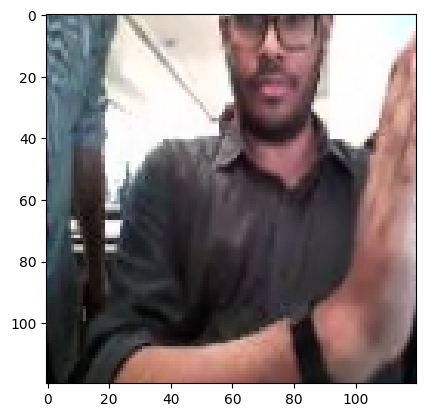

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_25_30_Pro_Right_Swipe_new/WIN_20180926_17_25_30_Pro_00022.png


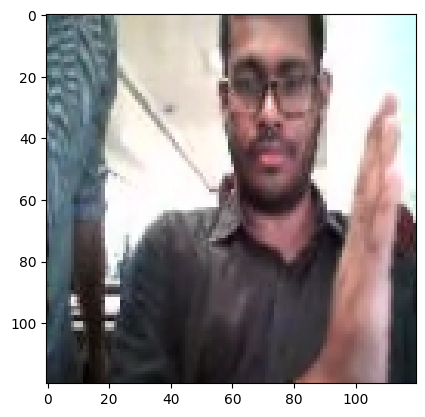

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_25_30_Pro_Right_Swipe_new/WIN_20180926_17_25_30_Pro_00026.png


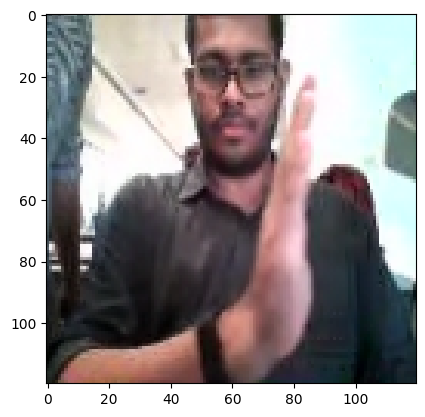

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_25_30_Pro_Right_Swipe_new/WIN_20180926_17_25_30_Pro_00030.png


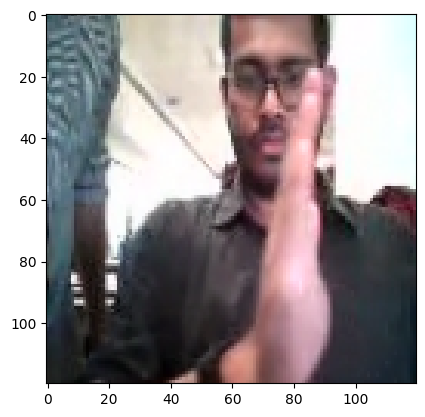

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_25_30_Pro_Right_Swipe_new/WIN_20180926_17_25_30_Pro_00034.png


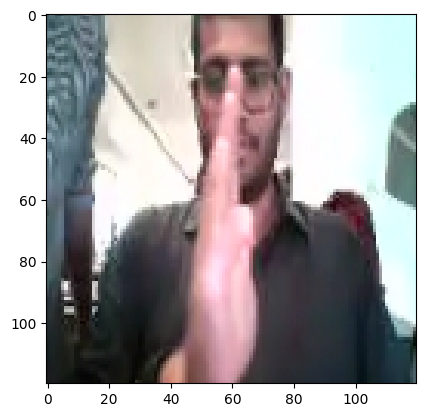

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_25_30_Pro_Right_Swipe_new/WIN_20180926_17_25_30_Pro_00038.png


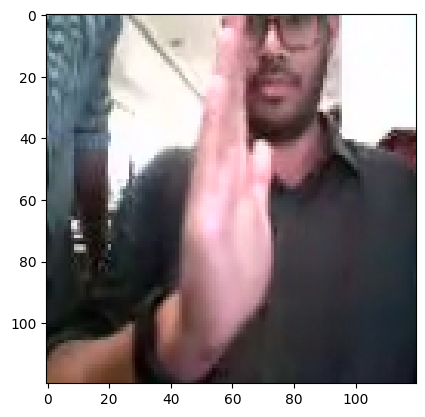

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_25_30_Pro_Right_Swipe_new/WIN_20180926_17_25_30_Pro_00042.png


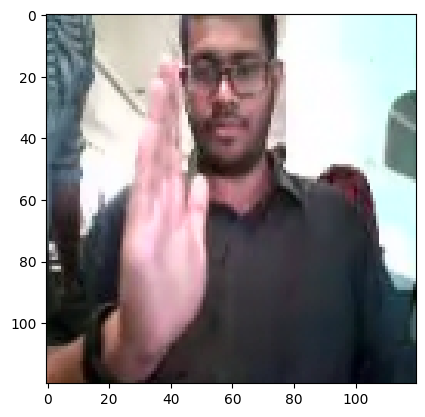

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_25_30_Pro_Right_Swipe_new/WIN_20180926_17_25_30_Pro_00046.png


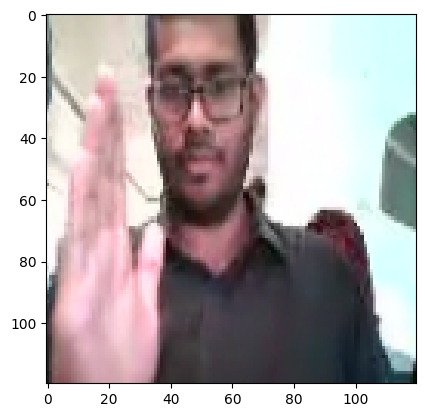

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_25_30_Pro_Right_Swipe_new/WIN_20180926_17_25_30_Pro_00050.png


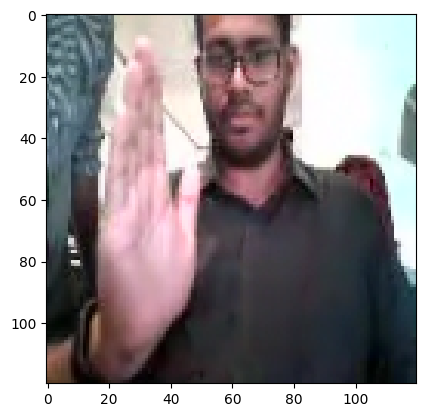

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_25_30_Pro_Right_Swipe_new/WIN_20180926_17_25_30_Pro_00054.png


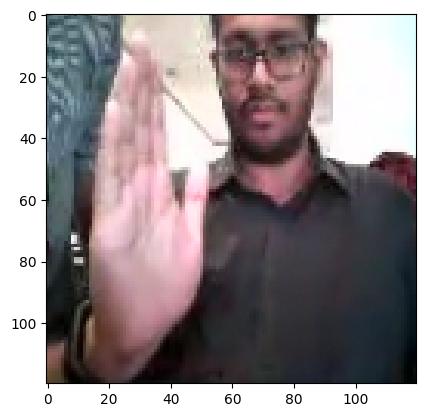

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_25_30_Pro_Right_Swipe_new/WIN_20180926_17_25_30_Pro_00058.png


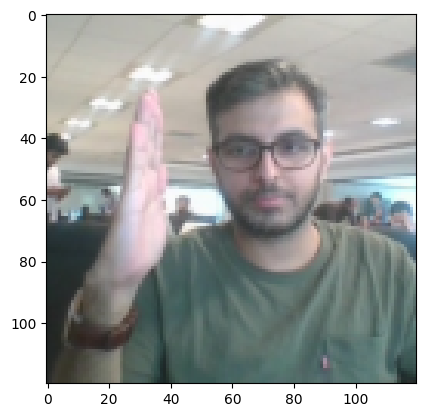

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_14_58_Pro_Left Swipe_new_Left Swipe_new/WIN_20180907_16_14_58_Pro_00021.png


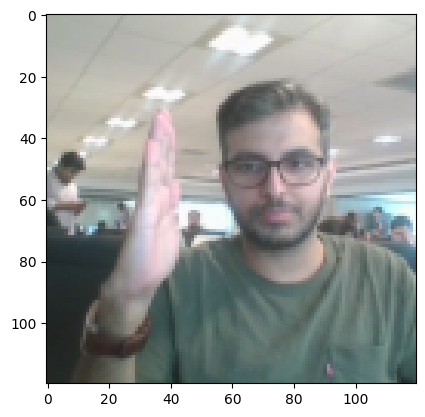

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_14_58_Pro_Left Swipe_new_Left Swipe_new/WIN_20180907_16_14_58_Pro_00025.png


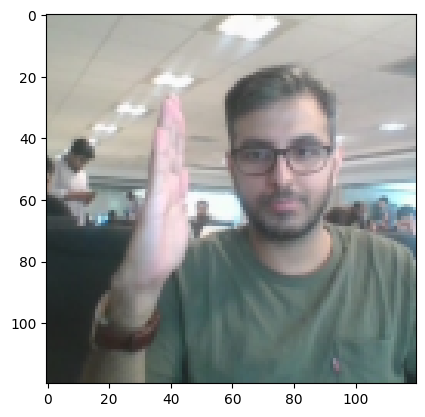

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_14_58_Pro_Left Swipe_new_Left Swipe_new/WIN_20180907_16_14_58_Pro_00029.png


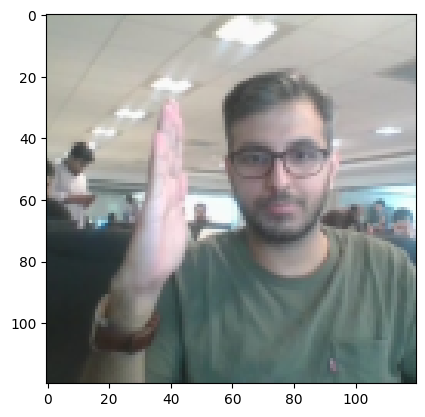

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_14_58_Pro_Left Swipe_new_Left Swipe_new/WIN_20180907_16_14_58_Pro_00033.png


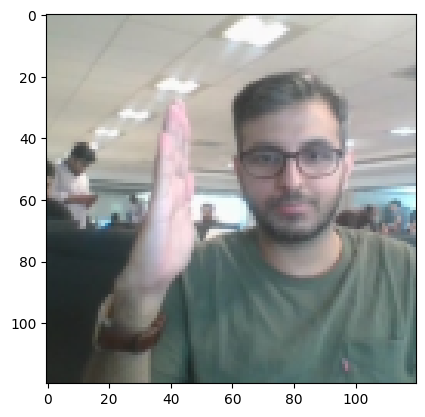

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_14_58_Pro_Left Swipe_new_Left Swipe_new/WIN_20180907_16_14_58_Pro_00037.png


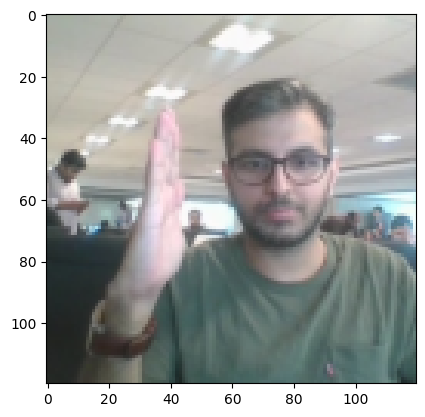

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_14_58_Pro_Left Swipe_new_Left Swipe_new/WIN_20180907_16_14_58_Pro_00041.png


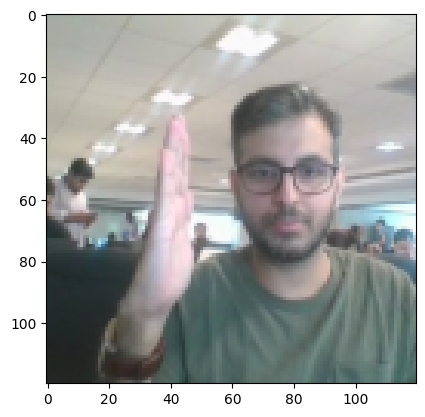

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_14_58_Pro_Left Swipe_new_Left Swipe_new/WIN_20180907_16_14_58_Pro_00045.png


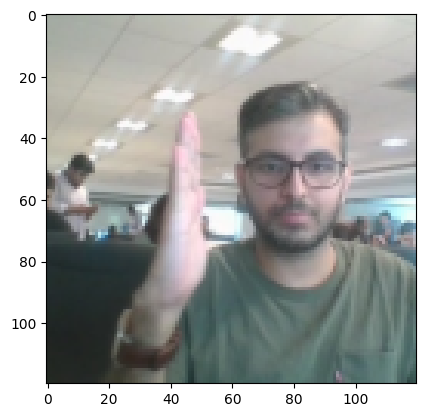

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_14_58_Pro_Left Swipe_new_Left Swipe_new/WIN_20180907_16_14_58_Pro_00049.png


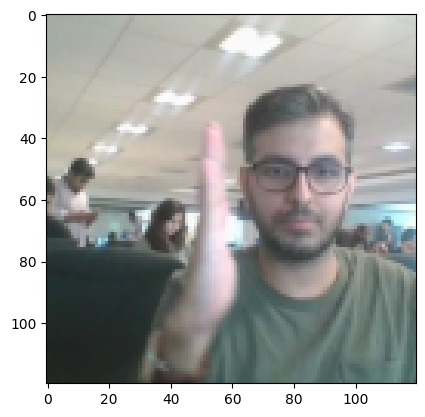

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_14_58_Pro_Left Swipe_new_Left Swipe_new/WIN_20180907_16_14_58_Pro_00053.png


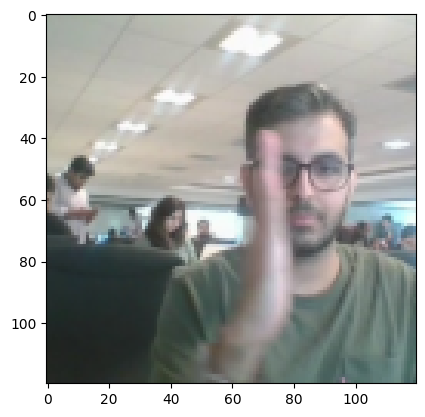

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_14_58_Pro_Left Swipe_new_Left Swipe_new/WIN_20180907_16_14_58_Pro_00057.png


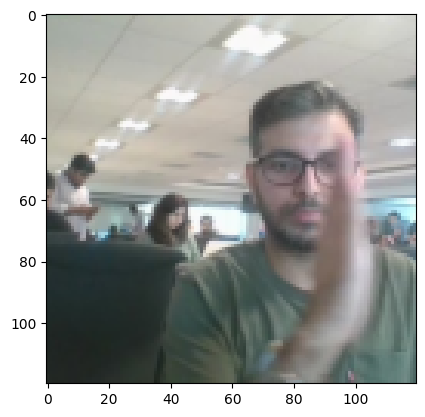

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_14_58_Pro_Left Swipe_new_Left Swipe_new/WIN_20180907_16_14_58_Pro_00061.png


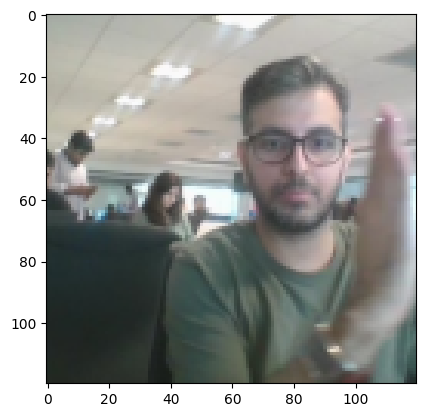

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_14_58_Pro_Left Swipe_new_Left Swipe_new/WIN_20180907_16_14_58_Pro_00065.png


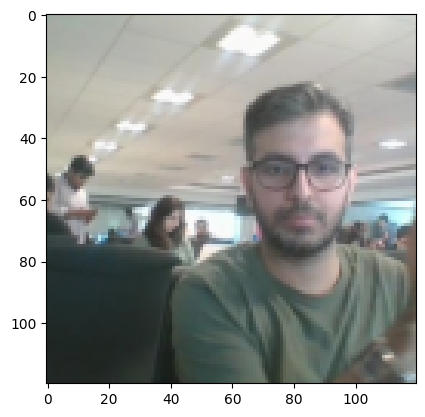

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_14_58_Pro_Left Swipe_new_Left Swipe_new/WIN_20180907_16_14_58_Pro_00069.png


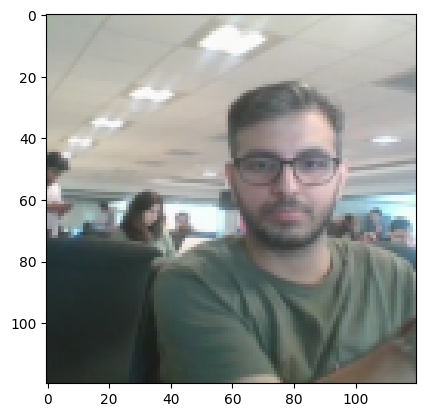

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_14_58_Pro_Left Swipe_new_Left Swipe_new/WIN_20180907_16_14_58_Pro_00073.png


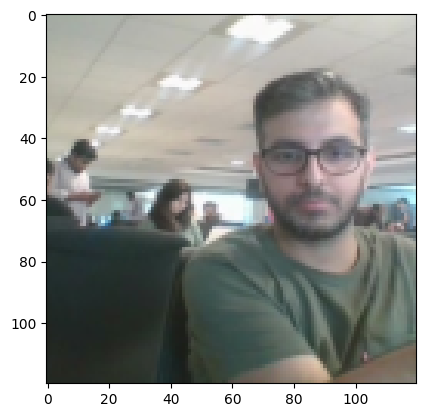

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180907_16_14_58_Pro_Left Swipe_new_Left Swipe_new/WIN_20180907_16_14_58_Pro_00077.png


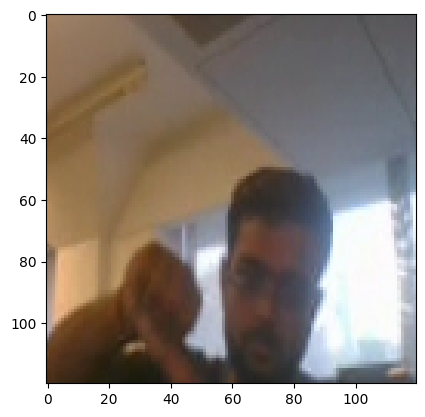

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_47_32_Pro_Thumbs_Down_new/WIN_20180925_17_47_32_Pro_00015.png


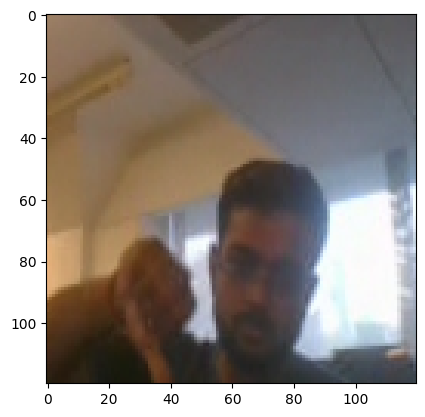

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_47_32_Pro_Thumbs_Down_new/WIN_20180925_17_47_32_Pro_00017.png


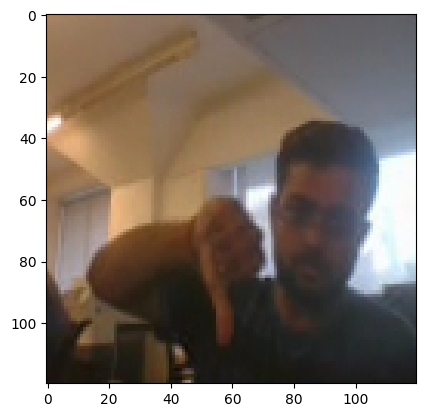

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_47_32_Pro_Thumbs_Down_new/WIN_20180925_17_47_32_Pro_00019.png


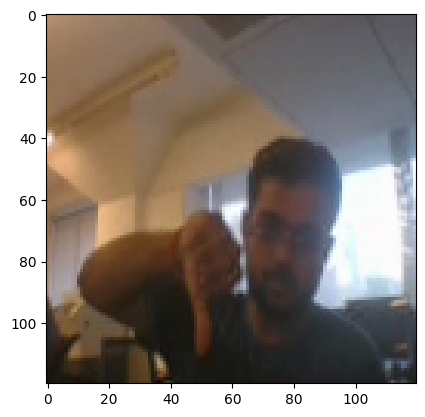

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_47_32_Pro_Thumbs_Down_new/WIN_20180925_17_47_32_Pro_00021.png


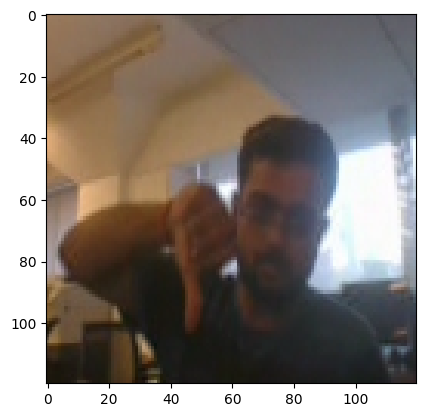

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_47_32_Pro_Thumbs_Down_new/WIN_20180925_17_47_32_Pro_00023.png


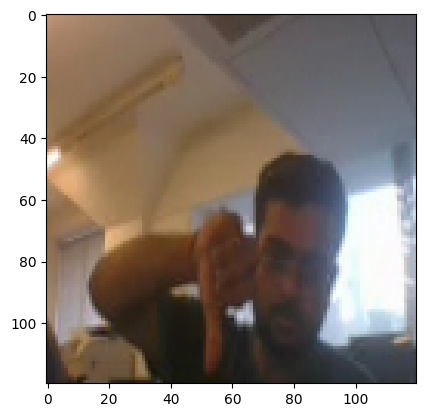

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_47_32_Pro_Thumbs_Down_new/WIN_20180925_17_47_32_Pro_00025.png


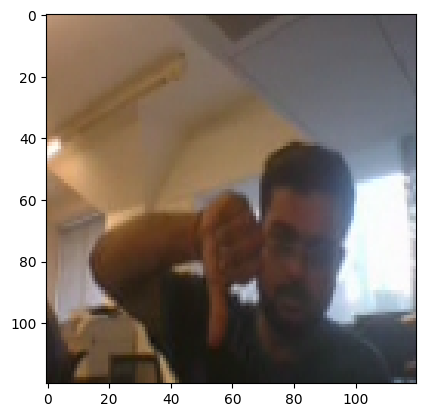

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_47_32_Pro_Thumbs_Down_new/WIN_20180925_17_47_32_Pro_00027.png


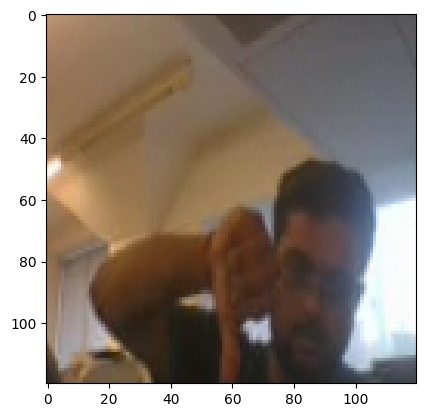

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_47_32_Pro_Thumbs_Down_new/WIN_20180925_17_47_32_Pro_00029.png


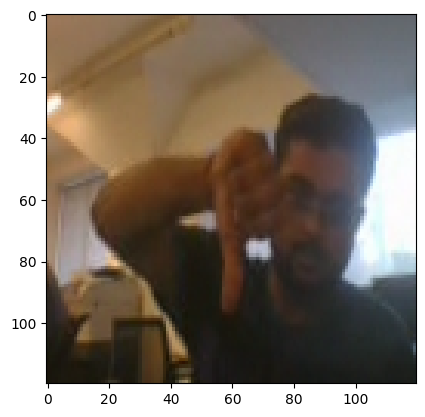

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_47_32_Pro_Thumbs_Down_new/WIN_20180925_17_47_32_Pro_00031.png


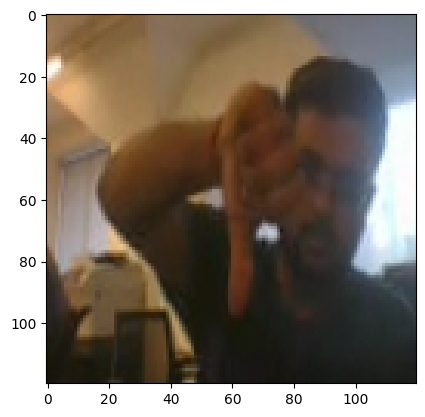

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_47_32_Pro_Thumbs_Down_new/WIN_20180925_17_47_32_Pro_00033.png


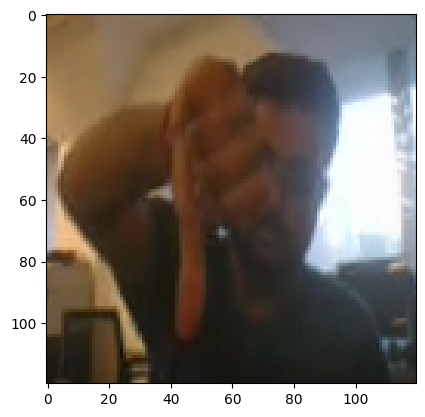

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_47_32_Pro_Thumbs_Down_new/WIN_20180925_17_47_32_Pro_00035.png


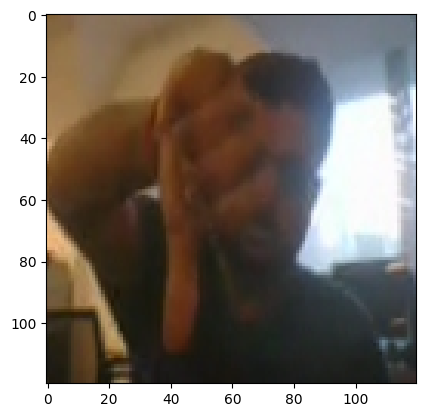

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_47_32_Pro_Thumbs_Down_new/WIN_20180925_17_47_32_Pro_00037.png


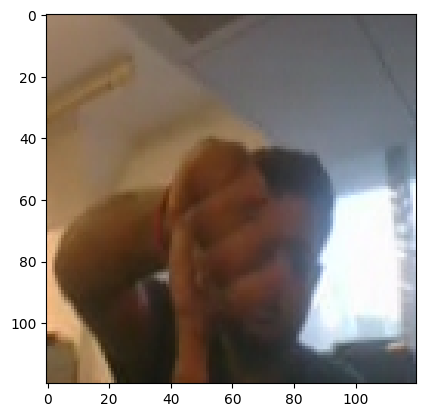

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_47_32_Pro_Thumbs_Down_new/WIN_20180925_17_47_32_Pro_00039.png


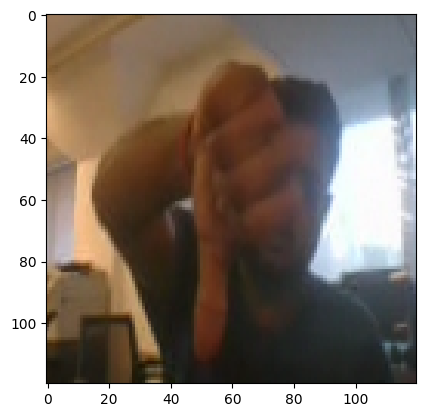

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_47_32_Pro_Thumbs_Down_new/WIN_20180925_17_47_32_Pro_00041.png


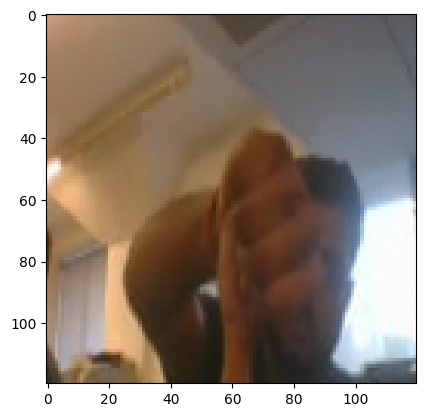

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180925_17_47_32_Pro_Thumbs_Down_new/WIN_20180925_17_47_32_Pro_00043.png


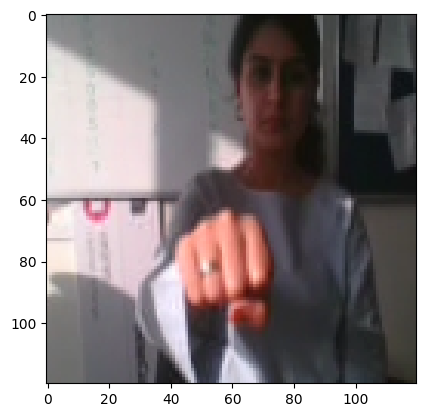

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_03_38_Pro_Thumbs_Up_new/WIN_20180926_17_03_38_Pro_00000.png


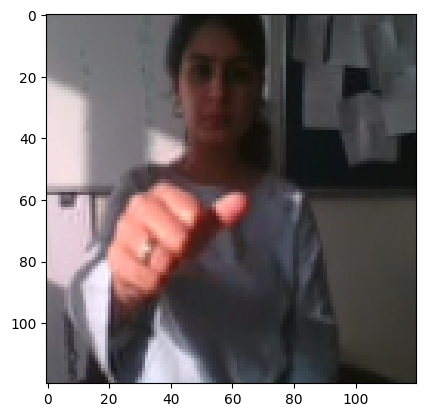

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_03_38_Pro_Thumbs_Up_new/WIN_20180926_17_03_38_Pro_00004.png


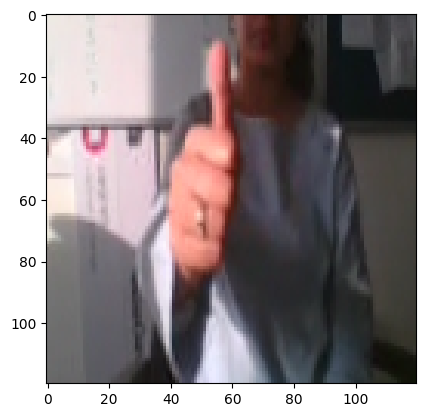

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_03_38_Pro_Thumbs_Up_new/WIN_20180926_17_03_38_Pro_00008.png


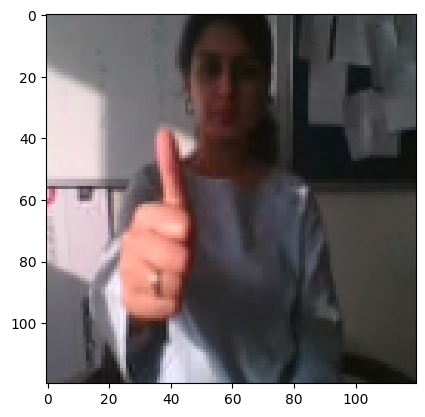

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_03_38_Pro_Thumbs_Up_new/WIN_20180926_17_03_38_Pro_00012.png


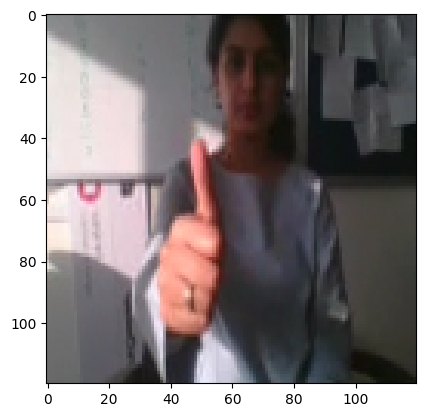

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_03_38_Pro_Thumbs_Up_new/WIN_20180926_17_03_38_Pro_00016.png


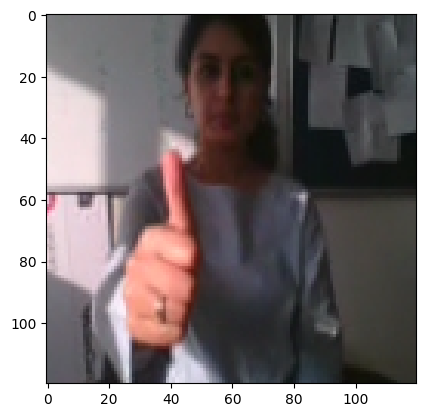

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_03_38_Pro_Thumbs_Up_new/WIN_20180926_17_03_38_Pro_00020.png


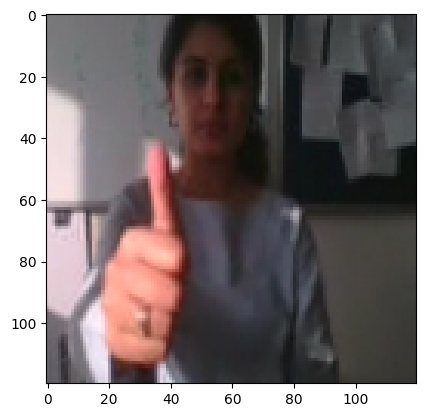

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_03_38_Pro_Thumbs_Up_new/WIN_20180926_17_03_38_Pro_00024.png


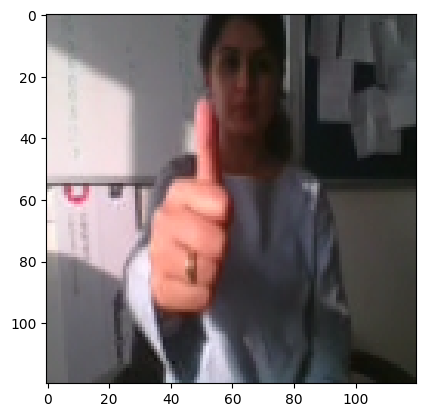

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_03_38_Pro_Thumbs_Up_new/WIN_20180926_17_03_38_Pro_00028.png


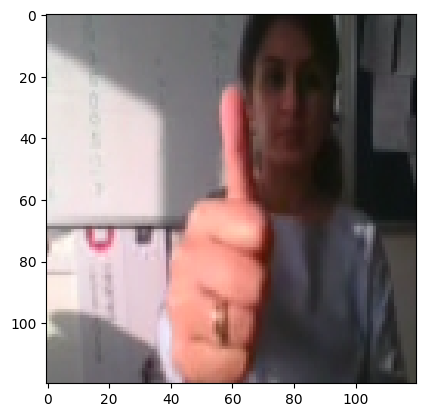

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_03_38_Pro_Thumbs_Up_new/WIN_20180926_17_03_38_Pro_00032.png


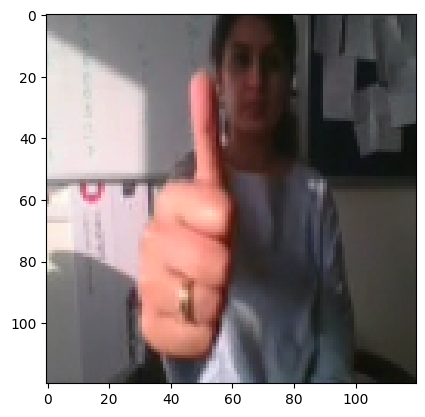

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_03_38_Pro_Thumbs_Up_new/WIN_20180926_17_03_38_Pro_00036.png


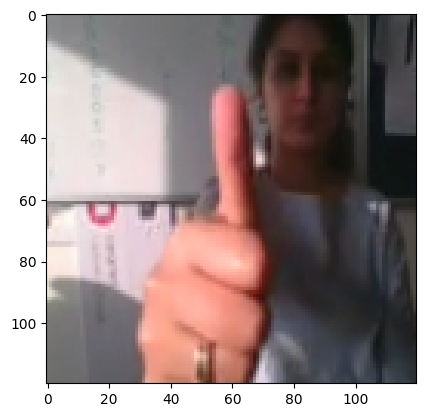

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_03_38_Pro_Thumbs_Up_new/WIN_20180926_17_03_38_Pro_00040.png


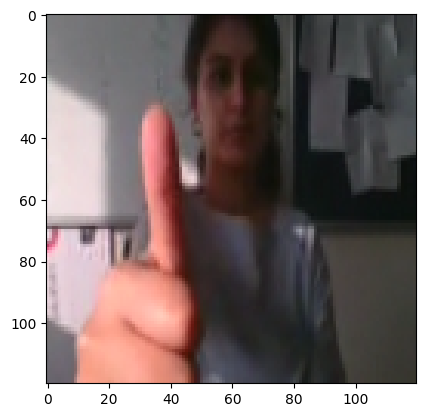

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_03_38_Pro_Thumbs_Up_new/WIN_20180926_17_03_38_Pro_00044.png


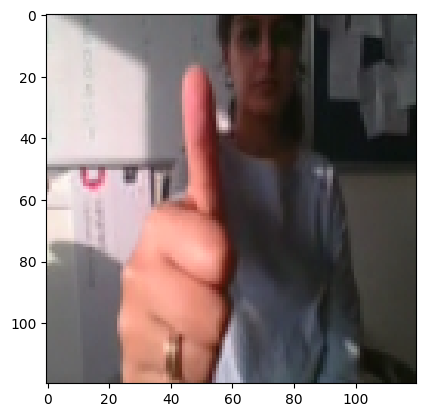

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_03_38_Pro_Thumbs_Up_new/WIN_20180926_17_03_38_Pro_00048.png


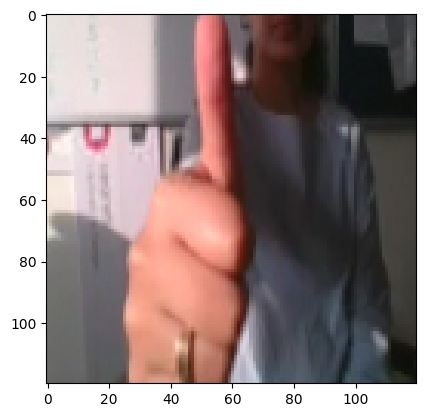

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_03_38_Pro_Thumbs_Up_new/WIN_20180926_17_03_38_Pro_00052.png


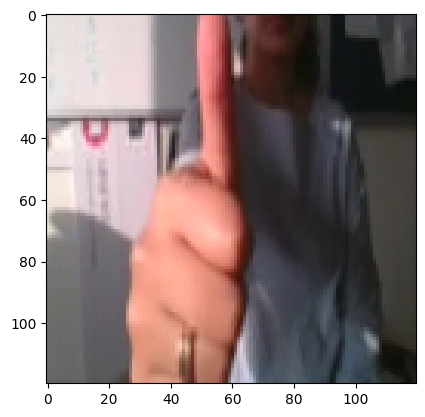

/Users/I320807/Library/CloudStorage/OneDrive-SAPSE/Desktop/DS/NN - Assignment - Gesture Recognition/Project_data/train/WIN_20180926_17_03_38_Pro_Thumbs_Up_new/WIN_20180926_17_03_38_Pro_00056.png


(array([[[[[0.68654245, 0.6543203 , 0.55761927],
           [0.68624508, 0.65402287, 0.55749184],
           [0.69058824, 0.65836602, 0.56454247],
           ...,
           [0.40735295, 0.3835049 , 0.36898693],
           [0.39466175, 0.37136602, 0.340451  ],
           [0.3722598 , 0.35212746, 0.30768302]],
 
          [[0.66743141, 0.63076472, 0.54106373],
           [0.66557842, 0.62891173, 0.54026961],
           [0.67725492, 0.64058828, 0.55343139],
           ...,
           [0.37401959, 0.3485049 , 0.34009802],
           [0.3369951 , 0.31492156, 0.28845099],
           [0.31125978, 0.29146078, 0.25146076]],
 
          [[0.65494281, 0.61599672, 0.52644604],
           [0.65049022, 0.61226308, 0.52356207],
           [0.66376638, 0.6245507 , 0.53627449],
           ...,
           [0.35445261, 0.32798201, 0.32308006],
           [0.33115196, 0.30977941, 0.28585786],
           [0.32318628, 0.30357844, 0.26612747]],
 
          ...,
 
          [[0.15932189, 0.14364378, 0.098782

In [798]:
next(train_generator)

In [815]:
curr_dt_time = datetime.datetime.now()
num_train_sequences = len(train_doc)
print('# training sequences =', num_train_sequences)
num_val_sequences = len(val_doc)
print('# validation sequences =', num_val_sequences)
num_epochs = 5
print ('# epochs =', num_epochs)

# training sequences = 663
# validation sequences = 100
# epochs = 5


## Model
Here you make the model using different functionalities that Keras provides. Remember to use `Conv3D` and `MaxPooling3D` and not `Conv2D` and `Maxpooling2D` for a 3D convolution model. You would want to use `TimeDistributed` while building a Conv2D + RNN model. Also remember that the last layer is the softmax. Design the network in such a way that the model is able to give good accuracy on the least number of parameters so that it can fit in the memory of the webcam.

In [816]:
from keras.models import Sequential, Model
from keras.layers import Dense, GRU, Flatten, TimeDistributed, Flatten, BatchNormalization, Activation,ConvLSTM2D,GlobalAveragePooling2D
from keras.layers.convolutional import Conv3D, MaxPooling3D, Conv2D
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
from keras import optimizers
from keras.layers import Dropout

#write your model here

#Conv3D

model = Sequential()
model.add(Conv3D(16, kernel_size=(3, 3, 3), padding='same',
         input_shape=(len(img_idx),120,120,3)))
model.add(Activation('relu'))
model.add(BatchNormalization())
model.add(MaxPooling3D(pool_size=(2, 2, 2),padding='same'))

model.add(Conv3D(32, kernel_size=(3, 3, 3), padding='same'))
model.add(Activation('relu'))
model.add(BatchNormalization())
model.add(MaxPooling3D(pool_size=(2, 2, 2),padding='same'))

model.add(Conv3D(64, kernel_size=(3, 3, 3), padding='same'))
model.add(Activation('relu'))
model.add(BatchNormalization())
model.add(MaxPooling3D(pool_size=(2, 2, 2),padding='same'))

model.add(Conv3D(128, kernel_size=(3, 3, 3), padding='same'))
model.add(Activation('relu'))
model.add(BatchNormalization())
model.add(MaxPooling3D(pool_size=(2, 2, 2),padding='same'))

model.add(Flatten())
model.add(Dense(64,activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.25))

model.add(Dense(64,activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.25))


model.add(Dense(5,activation='softmax'))



In [817]:
model = Sequential()
model.add(TimeDistributed(
    Conv2D(8, (3,3), activation='relu'), input_shape=(len(img_idx),120,120,3))
)
model.add(BatchNormalization())
model.add(TimeDistributed(
    Conv2D(16, (3,3), activation='relu'))
)
model.add(BatchNormalization())
model.add(
    ConvLSTM2D(8, kernel_size = 3, return_sequences=False)
)
model.add(BatchNormalization())
model.add(TimeDistributed(
    Dense(64, activation='relu'))
)
model.add(BatchNormalization())
model.add(GlobalAveragePooling2D())
model.add(Dense(64, activation='relu'))
model.add(Dense(5, activation='softmax'))

Now that you have written the model, the next step is to `compile` the model. When you print the `summary` of the model, you'll see the total number of parameters you have to train.

In [818]:
from tensorflow.keras.optimizers.legacy import Adam
optimiser = Adam()#write your optimizer
model.compile(optimizer=optimiser, loss='categorical_crossentropy', metrics=['categorical_accuracy'])
print (model.summary())

Model: "sequential_70"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed_12 (TimeDi  (None, 15, 118, 118, 8)  224       
 stributed)                                                      
                                                                 
 batch_normalization_252 (Ba  (None, 15, 118, 118, 8)  32        
 tchNormalization)                                               
                                                                 
 time_distributed_13 (TimeDi  (None, 15, 116, 116, 16)  1168     
 stributed)                                                      
                                                                 
 batch_normalization_253 (Ba  (None, 15, 116, 116, 16)  64       
 tchNormalization)                                               
                                                                 
 conv_lstm2d_4 (ConvLSTM2D)  (None, 114, 114, 8)     

Let us create the `train_generator` and the `val_generator` which will be used in `.fit_generator`.

In [819]:
train_generator = generator(train_path, train_doc, batch_size,augment=True)
val_generator = generator(val_path, val_doc, batch_size,augment=False)

In [820]:
model_name = 'model_init' + '_' + str(curr_dt_time).replace(' ','').replace(':','_') + '/'
    
if not os.path.exists(model_name):
    os.mkdir(model_name)
        
filepath = model_name + 'model-{epoch:05d}-{loss:.5f}-{categorical_accuracy:.5f}-{val_loss:.5f}-{val_categorical_accuracy:.5f}.h5'

checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=False, save_weights_only=False, mode='auto', period=1)

LR = ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=5, min_lr=0.001)
callbacks_list = [checkpoint, LR]

The `steps_per_epoch` and `validation_steps` are used by `fit_generator` to decide the number of next() calls it need to make.

In [821]:
if (num_train_sequences%batch_size) == 0:
    steps_per_epoch = int(num_train_sequences/batch_size)
else:
    steps_per_epoch = (num_train_sequences//batch_size) + 1

if (num_val_sequences%batch_size) == 0:
    validation_steps = int(num_val_sequences/batch_size)
else:
    validation_steps = (num_val_sequences//batch_size) + 1

Let us now fit the model. This will start training the model and with the help of the checkpoints, you'll be able to save the model at the end of each epoch.

In [822]:
model.fit_generator(train_generator, steps_per_epoch=steps_per_epoch, epochs=num_epochs, verbose=1, 
                    callbacks=callbacks_list, validation_data=val_generator, 
                    validation_steps=validation_steps, class_weight=None, workers=1, initial_epoch=0)

/var/folders/84/r9dztswx7txg1mhmk0xjmbmc0000gn/T/ipykernel_75532/385748685.py:1: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  model.fit_generator(train_generator, steps_per_epoch=steps_per_epoch, epochs=num_epochs, verbose=1,


Epoch 1/5
34/34 [==============================] - ETA: 0s - loss: 1.4541 - categorical_accuracy: 0.3922
Epoch 1: saving model to model_init_2023-06-1200_56_35.810359/model-00001-1.45409-0.39216-1.60473-0.21000.h5
34/34 [==============================] - 134s 4s/step - loss: 1.4541 - categorical_accuracy: 0.3922 - val_loss: 1.6047 - val_categorical_accuracy: 0.2100 - lr: 0.0010
Epoch 2/5
34/34 [==============================] - ETA: 0s - loss: 1.1729 - categorical_accuracy: 0.5173
Epoch 2: saving model to model_init_2023-06-1200_56_35.810359/model-00002-1.17294-0.51735-1.61898-0.19000.h5
34/34 [==============================] - 139s 4s/step - loss: 1.1729 - categorical_accuracy: 0.5173 - val_loss: 1.6190 - val_categorical_accuracy: 0.1900 - lr: 0.0010
Epoch 3/5
34/34 [==============================] - ETA: 0s - loss: 1.0515 - categorical_accuracy: 0.5339
Epoch 3: saving model to model_init_2023-06-1200_56_35.810359/model-00003-1.05149-0.53394-1.63974-0.30000.h5
34/34 [=================

In [488]:
len(seq_idx)

30

In [486]:
len(img_idx)

15

In [532]:
rr = 1

In [533]:
rr if rr else 100

1